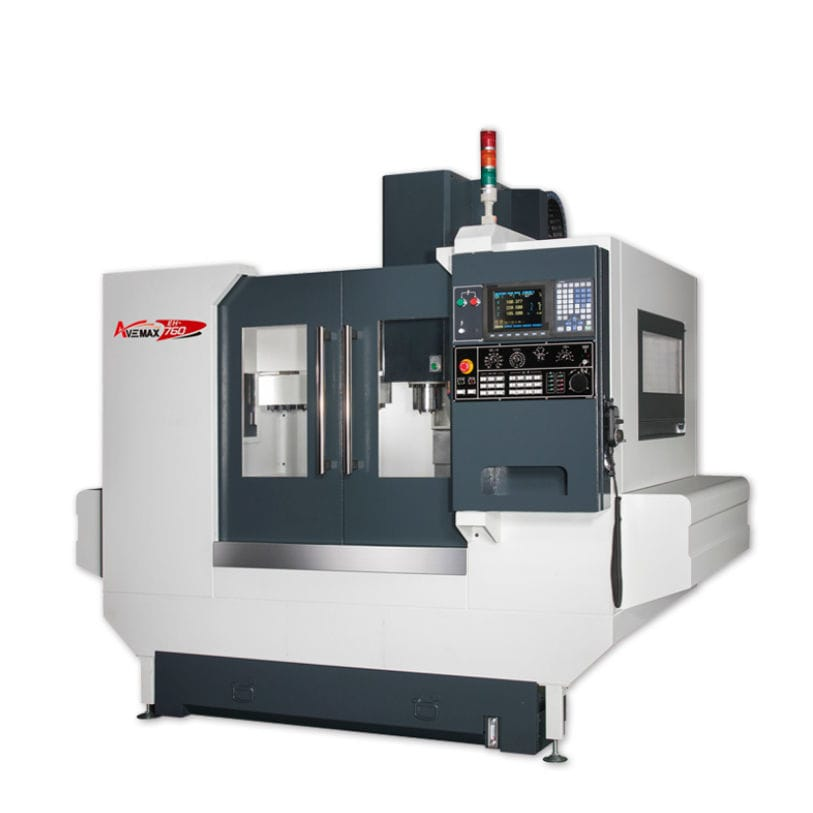

# CNC Milling Machine - Tool Wear Detection

###### Data description
Time series data was collected from 18 experiments with a sampling rate of 100ms and are separately reported
in files experiment_01.csv to experiment_18.cvs. Each file has measurements from the 4 motors in the CNC(X, Y, Z axes and S (spindle))

#### Problem Statement
A series of machining experiments were run on 2" x 2" x 1.5" wax blocks in a CNC milling machine in the System-level Manufacturing and Automation Research Testbed (SMART) at the University of Michigan. Machining data was collected from a CNC machine for variations of tool condition, feed rate, and clamping pressure. Each experiment produced a finished wax part with an "S" shape - S for smart manufacturing - carved into the top face, as shown in test_artifact.jpg

Серия экспериментов по обработке была проведена на восковых блоках размером 2 x 2 x 1,5 дюйма на фрезерном станке с ЧПУ на исследовательском стенде системного производства и автоматизации (SMART) в Мичиганском университете. Данные обработки были собраны на станке с ЧПУ. для изменения состояния инструмента, скорости подачи и давления зажима. В ходе каждого эксперимента получалась готовая восковая деталь S-образной формы (S для интеллектуального производства), вырезанная на верхней грани, как показано на test_artifact.jpg.

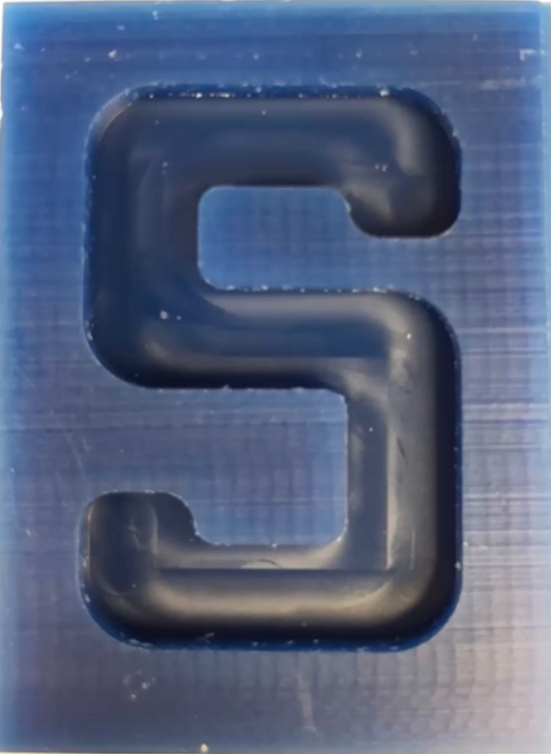

###### Goals 
The goal of our project is to predict the wear of parts on a CNC milling machine

###### Features 
                                           X-axis variables


| Variable                 | Description                                       |
|--------------------------|---------------------------------------------------|
| X1_ActualPosition        | Actual x position of part (mm)                    |
| X1_ActualVelocity        | Actual x velocity of part (mm/s)                  |
| X1_ActualAcceleration   | Actual x acceleration of part (mm/s/s)           |
| X1_CommandPosition       | Reference x position of part (mm)                 |
| X1_CommandVelocity       | Reference x velocity of part (mm/s)               |
| X1_CommandAcceleration  | Reference x acceleration of part (mm/s/s)        |
| X1_CurrentFeedback       | Current (A)                                       |
| X1_DCBusVoltage          | Voltage (V)                                       |
| X1_OutputCurrent         | Current (A)                                       |
| X1_OutputVoltage         | Voltage (V)                                       |
| X1_OutputPower           | Power (kW)                                        |

                                           Y-axis variables

| Variable                 | Description                                       |
|--------------------------|---------------------------------------------------|
| Y1_ActualPosition        | Actual y position of part (mm)                    |
| Y1_ActualVelocity        | Actual y velocity of part (mm/s)                  |
| Y1_ActualAcceleration   | Actual y acceleration of part (mm/s/s)           |
| Y1_CommandPosition       | Reference y position of part (mm)                 |
| Y1_CommandVelocity       | Reference y velocity of part (mm/s)               |
| Y1_CommandAcceleration  | Reference y acceleration of part (mm/s/s)        |
| Y1_CurrentFeedback       | Current (A)                                       |
| Y1_DCBusVoltage          | Voltage (V)                                       |
| Y1_OutputCurrent         | Current (A)                                       |
| Y1_OutputVoltage         | Voltage (V)                                       |
| Y1_OutputPower           | Power (kW)                                        |

                                       Z-axis variables
| Feature                | Description                                 |
|------------------------|---------------------------------------------|
| Z1_ActualPosition      | Actual z position of part (mm)             |
| Z1_ActualVelocity      | Actual z velocity of part (mm/s)           |
| Z1_ActualAcceleration | Actual z acceleration of part (mm/s/s)     |
| Z1_CommandPosition     | Reference z position of part (mm)          |
| Z1_CommandVelocity     | Reference z velocity of part (mm/s)        |
| Z1_CommandAcceleration| Reference z acceleration of part (mm/s/s)  |
| Z1_CurrentFeedback     | Current (A)                                 |
| Z1_DCBusVoltage        | Voltage (V)                                 |
| Z1_OutputCurrent       | Current (A)                                 |
| Z1_OutputVoltage       | Voltage (V)                                 |

                                      S - Spindle
| Feature                 | Description                                         |
|-------------------------|-----------------------------------------------------|
| S1_ActualPosition       | Actual position of spindle (mm)                     |
| S1_ActualVelocity       | Actual velocity of spindle (mm/s)                   |
| S1_ActualAcceleration   | Actual acceleration of spindle (mm/s/s)            |
| S1_CommandPosition      | Reference position of spindle (mm)                  |
| S1_CommandVelocity      | Reference velocity of spindle (mm/s)                |
| S1_CommandAcceleration | Reference acceleration of spindle (mm/s/s)          |
| S1_CurrentFeedback      | Current (A)                                         |
| S1_DCBusVoltage         | Voltage (V)                                         |
| S1_OutputCurrent        | Current (A)                                         |
| S1_OutputVoltage        | Voltage (V)                                         |
| S1_OutputPower          | Power (A)                                           |
| S1_SystemInertia        | Torque inertia (kg*m^2)                             |
| M1_CURRENT_PROGRAM_NUMBER | Number the program is listed under on the CNC     |
| M1_sequence_number      | Line of G-code being executed                      |
| M1_CURRENT_FEEDRATE     | Instantaneous feed rate of spindle                 |

## 1. Import libraries

In [1]:
import pandas as pd
import numpy as np
# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats

# System
import os
import glob
import warnings

# Separate to train test split
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict

# Models
from sklearn.linear_model import SGDClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier, BaggingClassifier, ExtraTreesClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from xgboost import XGBClassifier
from sklearn.svm import SVC, LinearSVC
from sklearn.naive_bayes import GaussianNB

# Metrics
from sklearn.metrics import roc_auc_score, confusion_matrix, accuracy_score, classification_report, recall_score, f1_score, precision_score

# for search best parameters, build pipeline, cross_validation
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.pipeline import Pipeline

# Imputers
from feature_engine.imputation import RandomSampleImputer, CategoricalImputer, EndTailImputer
from sklearn.impute import KNNImputer, SimpleImputer
# Feature Magnitude
from sklearn.preprocessing import StandardScaler, Normalizer, MinMaxScaler, RobustScaler

# Feature Encoding
from feature_engine.encoding import CountFrequencyEncoder, OneHotEncoder, OrdinalEncoder

# Outliers
from feature_engine.outliers import Winsorizer

# Column Transformer
from sklearn.compose import ColumnTransformer

# For feature selection
from sklearn.feature_selection import VarianceThreshold
from feature_engine.selection import DropConstantFeatures, DropDuplicateFeatures, SmartCorrelatedSelection, DropCorrelatedFeatures

#Discretization
from feature_engine.discretisation import DecisionTreeDiscretiser

# For save models
import pickle
# Early stopping
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau, LearningRateScheduler

# ANN library
import tensorflow as tf
from scikeras.wrappers import KerasRegressor
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, Dense, Dropout, BatchNormalization
from keras.optimizers import Adam, SGD, Nadam, RMSprop, Adadelta
from keras.callbacks import EarlyStopping
from scikeras.wrappers import KerasClassifier
from tensorflow.keras.regularizers import l2
from tensorflow.keras import regularizers

In [2]:
def diagnostic_plots(dataset, variable):
    
    fig = plt.figure()
    plt.figure(figsize = (16, 4))
    
    plt.subplot(1, 3, 1)
    sns.histplot(dataset[variable], bins = 30)
    plt.title('Histogram')
    
    plt.subplot(1, 3, 2)
    stats.probplot(dataset[variable], dist = 'norm', plot = plt)
    plt.ylabel('Variable Quantile')
    
    plt.subplot(1, 3, 3)
    sns.boxplot(y = dataset[variable])
    plt.title('BoxPlot')    
    
    plt.show()

Diagnostic plots for show as histogram, probplot and boxplot

## 2. Load and Collecting the dataset

In [6]:
main_df = pd.read_csv('../input/train.csv')
main_df.head(5)

,No,material,feedrate,clamp_pressure,tool_condition,machining_finalized,passed_visual_inspection
0,1,wax,6,4.0,unworn,yes,yes
1,2,wax,20,4.0,unworn,yes,yes
2,3,wax,6,3.0,unworn,yes,yes
3,4,wax,6,2.5,unworn,no,NaN
4,5,wax,20,3.0,unworn,no,NaN


In [8]:
files = list()

for i in range(1, 19):
    exp_number = '0' + str(i) if i < 10 else str(i)
    file = pd.read_csv('../input/experiment_{}.csv'.format(exp_number))
    
    row = main_df[main_df['No'] == i]
    
    file['feedrate'] = row.iloc[0]['feedrate']
    file['clamp_pressure'] = row.iloc[0]['clamp_pressure']
    file['machining_finalized'] = row.iloc[0]['machining_finalized']
    file['passed_visual_inspection'] = row.iloc[0]['passed_visual_inspection']
    file['target'] = 1 if row.iloc[0]['tool_condition'] == 'worn' else 0
    
    files.append(file)

In [9]:
files

[      X1_ActualPosition  X1_ActualVelocity  X1_ActualAcceleration  \
 0                 198.0              0.000                   0.00   
 1                 198.0            -10.800                -350.00   
 2                 196.0            -17.800                  -6.25   
 3                 194.0            -18.000                   0.00   
 4                 193.0            -17.900                 -18.80   
 ...                 ...                ...                    ...   
 1050              141.0              0.175                  87.50   
 1051              141.0             -0.150                 -87.50   
 1052              141.0             -0.175                 -87.50   
 1053              141.0              0.150                  87.50   
 1054              141.0              0.175                  93.70   
 
       X1_CommandPosition  X1_CommandVelocity  X1_CommandAcceleration  \
 0                  198.0                 0.0                0.000000   
 1          

In [10]:
df = pd.concat(files, ignore_index = False)
df.shape

(25286, 53)

## 3. Exploratary Data Analysis (EDA)

In [11]:
# Check missing values
df.isnull().mean()

X1_ActualPosition            0.000000
X1_ActualVelocity            0.000000
X1_ActualAcceleration        0.000000
X1_CommandPosition           0.000000
X1_CommandVelocity           0.000000
X1_CommandAcceleration       0.000000
X1_CurrentFeedback           0.000000
X1_DCBusVoltage              0.000000
X1_OutputCurrent             0.000000
X1_OutputVoltage             0.000000
X1_OutputPower               0.000000
Y1_ActualPosition            0.000000
Y1_ActualVelocity            0.000000
Y1_ActualAcceleration        0.000000
Y1_CommandPosition           0.000000
Y1_CommandVelocity           0.000000
Y1_CommandAcceleration       0.000000
Y1_CurrentFeedback           0.000000
Y1_DCBusVoltage              0.000000
Y1_OutputCurrent             0.000000
Y1_OutputVoltage             0.000000
Y1_OutputPower               0.000000
Z1_ActualPosition            0.000000
Z1_ActualVelocity            0.000000
Z1_ActualAcceleration        0.000000
Z1_CommandPosition           0.000000
Z1_CommandVe

In [12]:
# Information about dataset
# From the analysis we see that all variable have numerical values except one variable
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 25286 entries, 0 to 2252
Data columns (total 53 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   X1_ActualPosition          25286 non-null  float64
 1   X1_ActualVelocity          25286 non-null  float64
 2   X1_ActualAcceleration      25286 non-null  float64
 3   X1_CommandPosition         25286 non-null  float64
 4   X1_CommandVelocity         25286 non-null  float64
 5   X1_CommandAcceleration     25286 non-null  float64
 6   X1_CurrentFeedback         25286 non-null  float64
 7   X1_DCBusVoltage            25286 non-null  float64
 8   X1_OutputCurrent           25286 non-null  float64
 9   X1_OutputVoltage           25286 non-null  float64
 10  X1_OutputPower             25286 non-null  float64
 11  Y1_ActualPosition          25286 non-null  float64
 12  Y1_ActualVelocity          25286 non-null  float64
 13  Y1_ActualAcceleration      25286 non-null  float64
 

In [13]:
# Describe variables
df.describe()

,X1_ActualPosition,X1_ActualVelocity,X1_ActualAcceleration,X1_CommandPosition,X1_CommandVelocity,X1_CommandAcceleration,X1_CurrentFeedback,X1_DCBusVoltage,X1_OutputCurrent,X1_OutputVoltage,...,S1_OutputCurrent,S1_OutputVoltage,S1_OutputPower,S1_SystemInertia,M1_CURRENT_PROGRAM_NUMBER,M1_sequence_number,M1_CURRENT_FEEDRATE,feedrate,clamp_pressure,target
count,25286.000000,25286.000000,25286.000000,25286.000000,25286.000000,25286.000000,25286.000000,2.528600e+04,25286.000000,25286.000000,...,25286.000000,25286.000000,25286.000000,25286.0,25286.000000,25286.000000,25286.000000,25286.000000,25286.000000,25286.000000
mean,159.052045,-0.288657,0.094264,159.050700,-0.283076,0.253215,-0.469714,6.603073e-02,326.945859,7.986942,...,322.784505,85.479195,0.127405,12.0,1.003441,47.345013,16.542039,7.123942,3.368168,0.526299
std,19.330873,5.658260,93.877623,19.331144,5.664309,72.594951,4.220750,3.700384e-02,1.459937,7.710379,...,4.293571,52.531863,0.080753,0.0,0.349055,43.826214,19.620219,6.167036,0.615639,0.499318
min,141.000000,-20.400000,-1280.000000,141.000000,-20.000000,-1000.000000,-23.400000,2.780000e-19,320.000000,0.000000,...,290.000000,0.000000,-0.002960,12.0,0.000000,0.000000,3.000000,3.000000,2.500000,0.000000
25%,145.000000,-2.050000,-31.300000,145.000000,-2.050000,0.000000,-3.930000,4.150000e-02,326.000000,2.590000,...,320.000000,0.000000,0.000005,12.0,1.000000,2.000000,3.000000,3.000000,3.000000,0.000000
50%,153.000000,0.000000,0.000000,153.000000,0.000000,0.000000,-0.666000,6.680000e-02,327.000000,7.140000,...,322.000000,117.000000,0.164000,12.0,1.000000,39.000000,6.000000,3.000000,3.000000,1.000000
75%,162.000000,0.200000,25.000000,162.000000,0.000000,0.000000,3.140000,9.130000e-02,327.000000,10.200000,...,327.000000,119.000000,0.183000,12.0,1.000000,85.000000,20.000000,6.000000,4.000000,1.000000
max,198.000000,50.700000,1440.000000,198.000000,50.000000,1000.000000,27.100000,3.800000e-01,331.000000,75.400000,...,332.000000,130.000000,0.569000,12.0,4.000000,135.000000,50.000000,20.000000,4.000000,1.000000


## 3.1 There are suspicions that some variables have empty values. They should be removed. Next we will check and delete

In [14]:
# Look at correlation between variables
corr = df.corr(numeric_only = True)
corr

,X1_ActualPosition,X1_ActualVelocity,X1_ActualAcceleration,X1_CommandPosition,X1_CommandVelocity,X1_CommandAcceleration,X1_CurrentFeedback,X1_DCBusVoltage,X1_OutputCurrent,X1_OutputVoltage,...,S1_OutputCurrent,S1_OutputVoltage,S1_OutputPower,S1_SystemInertia,M1_CURRENT_PROGRAM_NUMBER,M1_sequence_number,M1_CURRENT_FEEDRATE,feedrate,clamp_pressure,target
X1_ActualPosition,1.000000,-0.027925,-0.015813,0.999897,-0.030200,-0.022721,0.075901,-0.522043,0.349605,-0.290193,...,0.530134,-0.644873,-0.626264,NaN,0.016684,-0.408106,0.436281,0.453219,0.108508,-0.091920
X1_ActualVelocity,-0.027925,1.000000,0.042899,-0.025593,0.994736,-0.054833,0.656705,-0.007850,-0.057059,0.063614,...,-0.035890,0.061762,0.048899,NaN,0.002800,0.020850,-0.021601,-0.007987,-0.017314,-0.008353
X1_ActualAcceleration,-0.015813,0.042899,1.000000,-0.015834,0.082456,0.389891,0.147840,0.078077,-0.016064,0.046832,...,0.003505,-0.007081,-0.002979,NaN,0.001840,-0.007341,0.015675,0.022708,0.011408,0.004147
X1_CommandPosition,0.999897,-0.025593,-0.015834,1.000000,-0.027861,-0.022636,0.077469,-0.522235,0.349688,-0.290381,...,0.530155,-0.644838,-0.626251,NaN,0.016690,-0.408173,0.436145,0.453153,0.108510,-0.092029
X1_CommandVelocity,-0.030200,0.994736,0.082456,-0.027861,1.000000,0.039428,0.676604,-0.001226,-0.058431,0.065110,...,-0.036472,0.062592,0.049627,NaN,0.003463,0.020269,-0.021655,-0.006797,-0.017402,-0.008909
X1_CommandAcceleration,-0.022721,-0.054833,0.389891,-0.022636,0.039428,1.000000,0.126885,0.059561,-0.010022,0.016314,...,-0.002754,0.004140,0.003663,NaN,0.007051,-0.009969,0.004968,0.011360,0.000844,-0.005586
X1_CurrentFeedback,0.075901,0.656705,0.147840,0.077469,0.676604,0.126885,1.000000,-0.013091,-0.076092,-0.009337,...,-0.078464,0.108385,0.097094,NaN,0.000687,0.047524,-0.107711,-0.015001,-0.013569,-0.020931
X1_DCBusVoltage,-0.522043,-0.007850,0.078077,-0.522235,-0.001226,0.059561,-0.013091,1.000000,-0.438586,0.759302,...,-0.520377,0.551953,0.542717,NaN,-0.014266,0.342302,-0.420468,-0.265393,-0.044318,0.076864
X1_OutputCurrent,0.349605,-0.057059,-0.016064,0.349688,-0.058431,-0.010022,-0.076092,-0.438586,1.000000,-0.424382,...,0.727152,-0.599540,-0.611948,NaN,0.043361,-0.367667,0.382719,-0.172817,-0.308918,-0.080973
X1_OutputVoltage,-0.290193,0.063614,0.046832,-0.290381,0.065110,0.016314,-0.009337,0.759302,-0.424382,1.000000,...,-0.303065,0.300806,0.307722,NaN,-0.004949,0.170238,-0.133161,0.027534,0.057796,0.075167


In [15]:
# Find constant feat
constant_features = [col for col in df.columns if len(df[col].unique()) == 1]
print(constant_features)

['Z1_CurrentFeedback', 'Z1_DCBusVoltage', 'Z1_OutputCurrent', 'Z1_OutputVoltage', 'S1_SystemInertia']


In [16]:
# Drop constant feat
df.drop(['Z1_CurrentFeedback', 'Z1_DCBusVoltage', 'Z1_OutputCurrent', 'Z1_OutputVoltage', 'S1_SystemInertia'],
      axis = 1, inplace = True)

In [17]:
df.shape

(25286, 48)

In [18]:
# Categorical variables
categorical_features = [
    var for var in df.columns if df[var].dtype == 'O'
]
categorical_features

['Machining_Process', 'machining_finalized', 'passed_visual_inspection']

In [19]:
# Numerical variables
numerical_features = [
    var for var in df.columns if df[var].dtype != 'O'
]
numerical_features

['X1_ActualPosition',
 'X1_ActualVelocity',
 'X1_ActualAcceleration',
 'X1_CommandPosition',
 'X1_CommandVelocity',
 'X1_CommandAcceleration',
 'X1_CurrentFeedback',
 'X1_DCBusVoltage',
 'X1_OutputCurrent',
 'X1_OutputVoltage',
 'X1_OutputPower',
 'Y1_ActualPosition',
 'Y1_ActualVelocity',
 'Y1_ActualAcceleration',
 'Y1_CommandPosition',
 'Y1_CommandVelocity',
 'Y1_CommandAcceleration',
 'Y1_CurrentFeedback',
 'Y1_DCBusVoltage',
 'Y1_OutputCurrent',
 'Y1_OutputVoltage',
 'Y1_OutputPower',
 'Z1_ActualPosition',
 'Z1_ActualVelocity',
 'Z1_ActualAcceleration',
 'Z1_CommandPosition',
 'Z1_CommandVelocity',
 'Z1_CommandAcceleration',
 'S1_ActualPosition',
 'S1_ActualVelocity',
 'S1_ActualAcceleration',
 'S1_CommandPosition',
 'S1_CommandVelocity',
 'S1_CommandAcceleration',
 'S1_CurrentFeedback',
 'S1_DCBusVoltage',
 'S1_OutputCurrent',
 'S1_OutputVoltage',
 'S1_OutputPower',
 'M1_CURRENT_PROGRAM_NUMBER',
 'M1_sequence_number',
 'M1_CURRENT_FEEDRATE',
 'feedrate',
 'clamp_pressure',
 'targe

##### Temporarily code category variables using OneHotEncoder method from Feature-Engine for data analysis

In [20]:
ohe_enc = OneHotEncoder(
    variables = ['Machining_Process', 'machining_finalized', 'passed_visual_inspection'],
    drop_last = True
)
ohe_enc.fit(df.fillna('Missing'))

OneHotEncoder(drop_last=True,
              variables=['Machining_Process', 'machining_finalized',
                         'passed_visual_inspection'])

In [21]:
tmp = ohe_enc.transform(df.fillna('Missing'))
tmp.shape

(25286, 58)

###### Distribution all Variables

<Figure size 640x480 with 0 Axes>

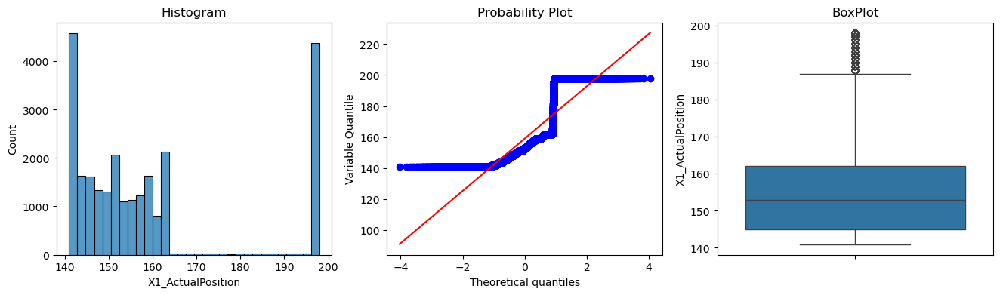

<Figure size 640x480 with 0 Axes>

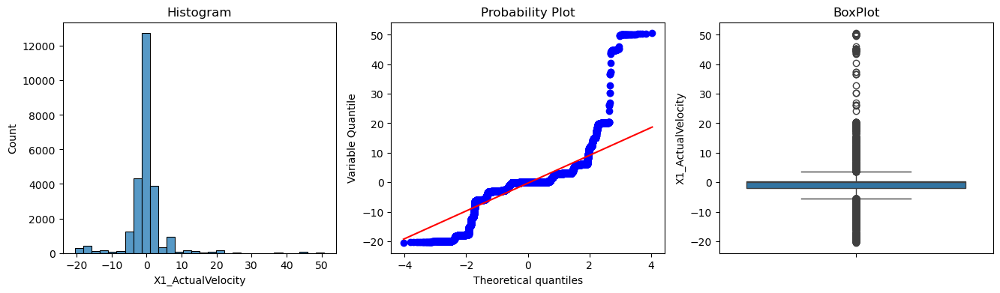

<Figure size 640x480 with 0 Axes>

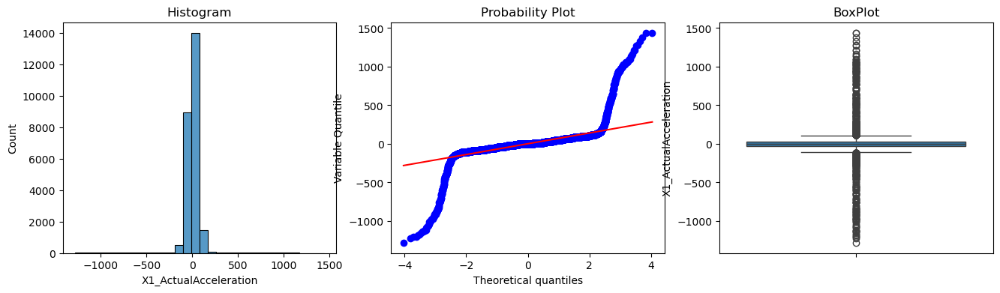

<Figure size 640x480 with 0 Axes>

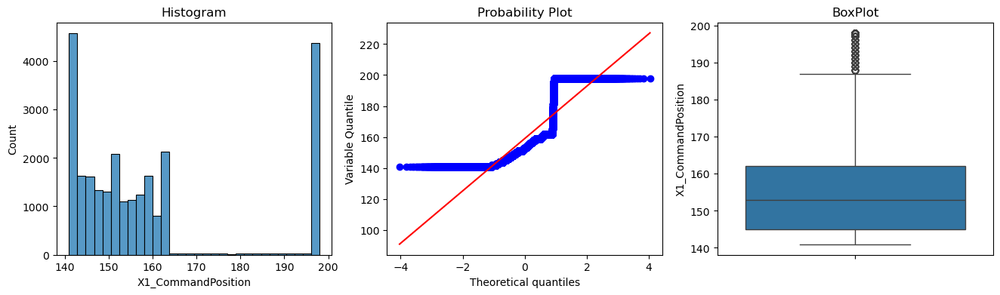

<Figure size 640x480 with 0 Axes>

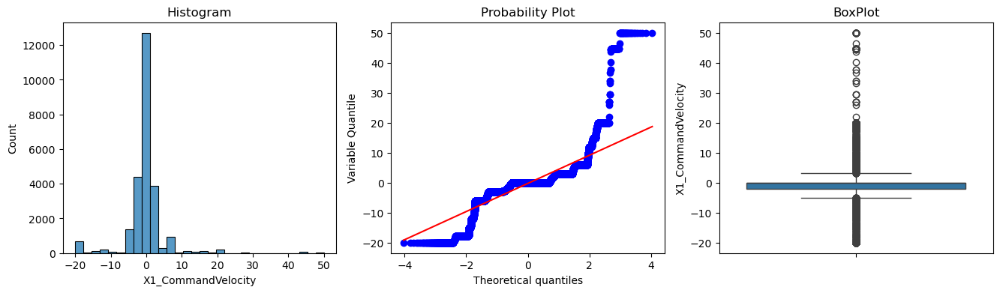

<Figure size 640x480 with 0 Axes>

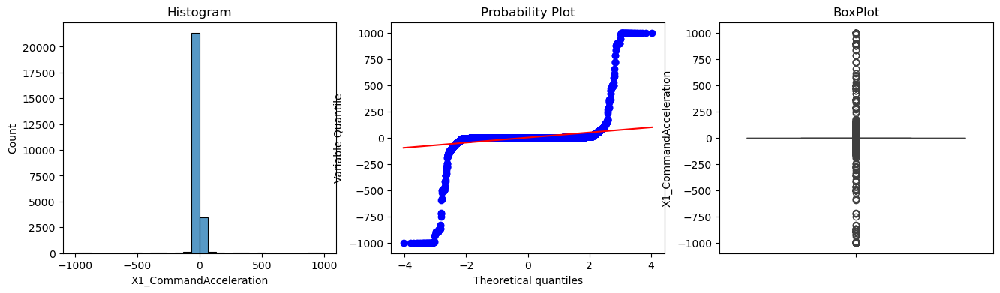

<Figure size 640x480 with 0 Axes>

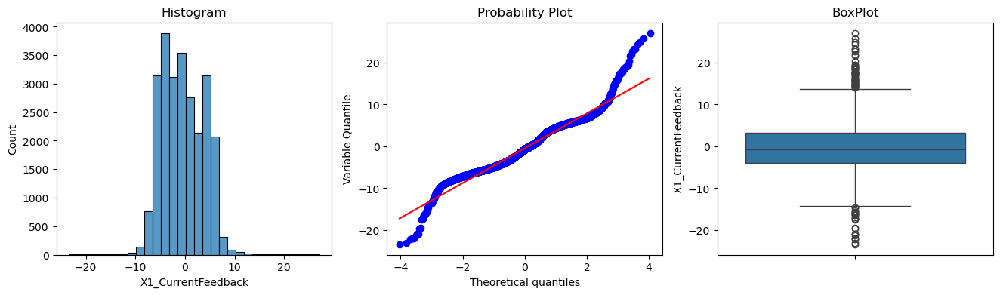

<Figure size 640x480 with 0 Axes>

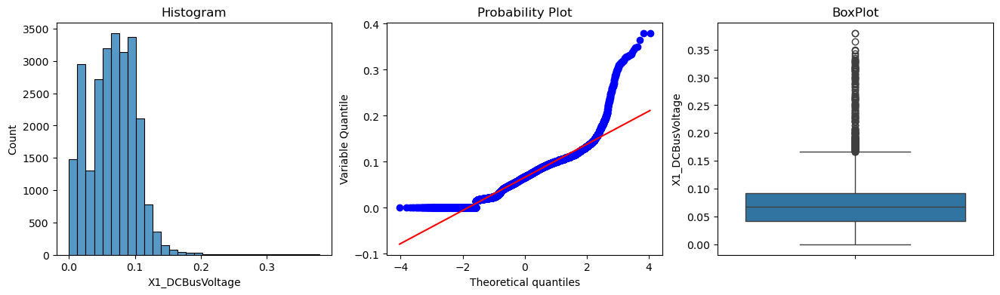

<Figure size 640x480 with 0 Axes>

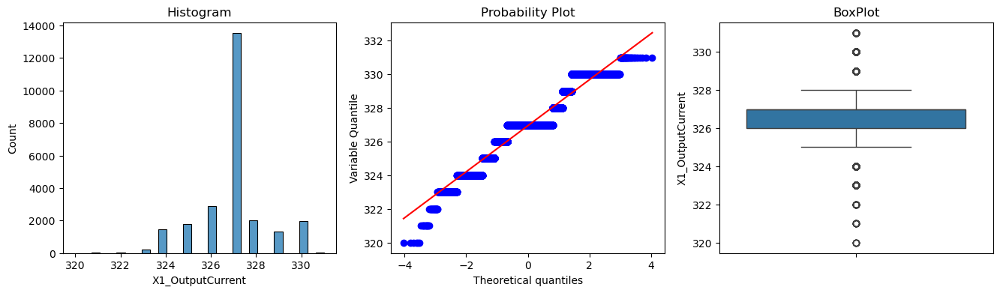

<Figure size 640x480 with 0 Axes>

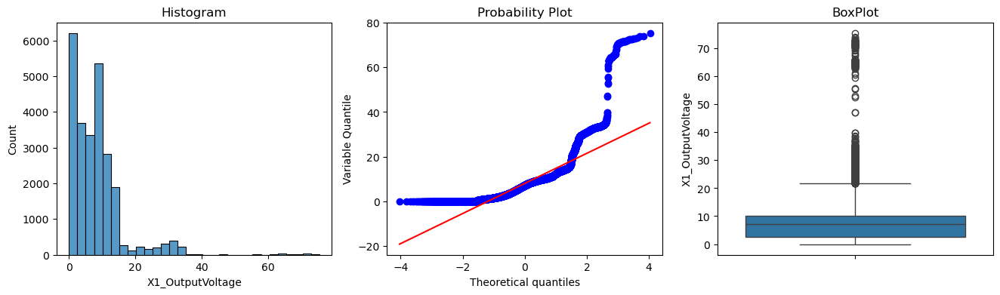

<Figure size 640x480 with 0 Axes>

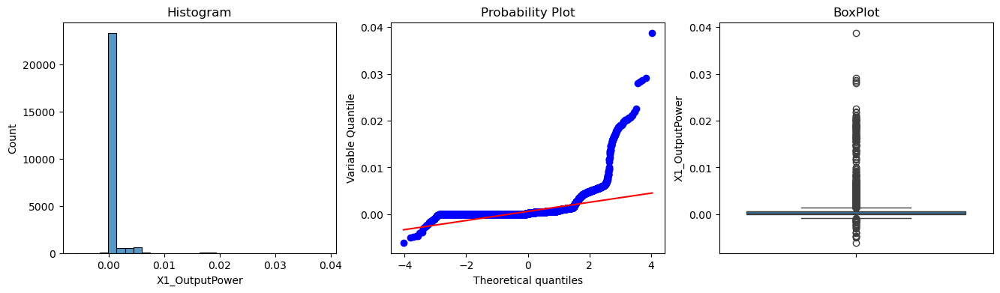

<Figure size 640x480 with 0 Axes>

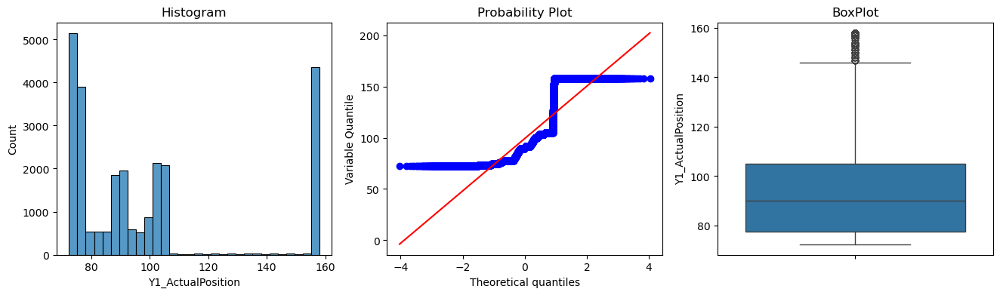

<Figure size 640x480 with 0 Axes>

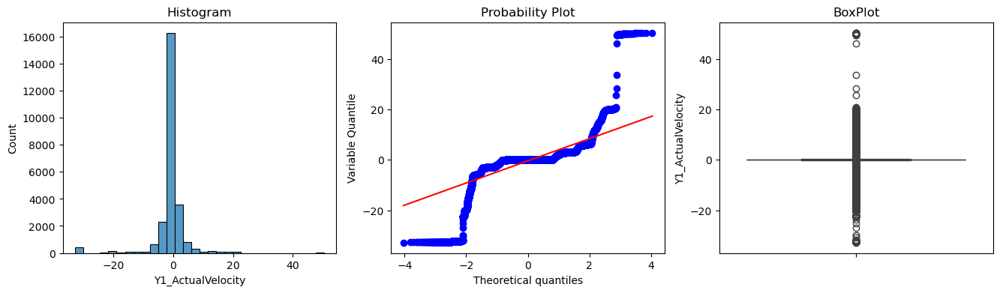

<Figure size 640x480 with 0 Axes>

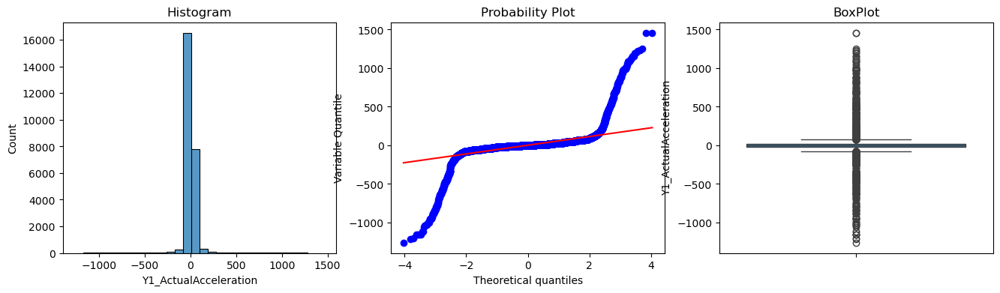

<Figure size 640x480 with 0 Axes>

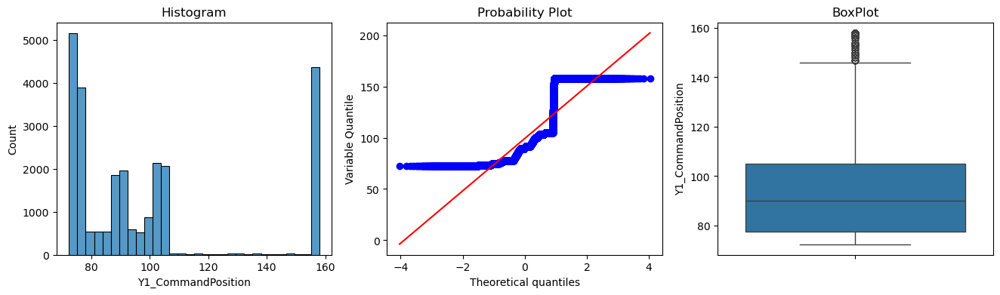

<Figure size 640x480 with 0 Axes>

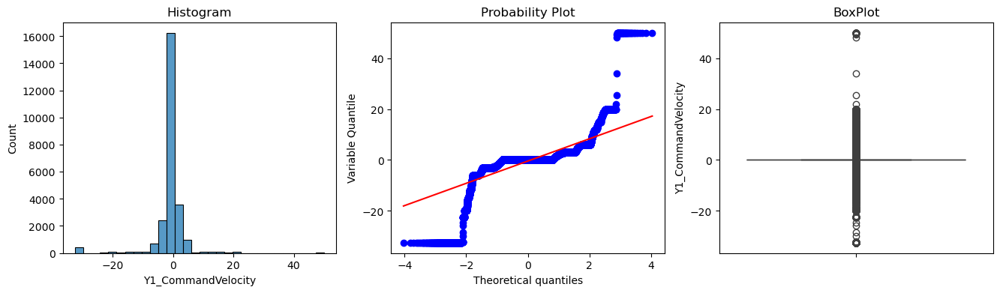

<Figure size 640x480 with 0 Axes>

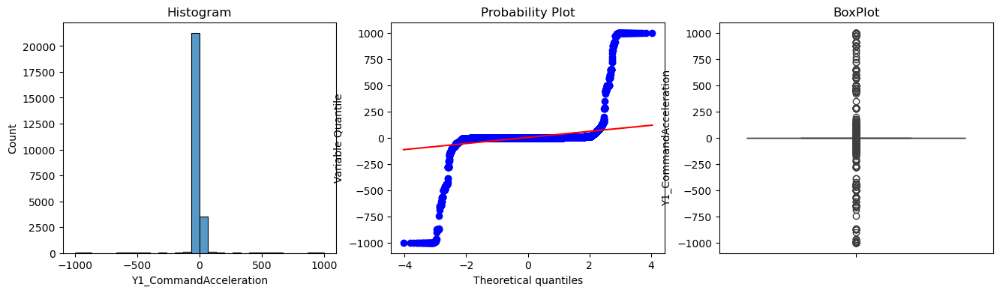

<Figure size 640x480 with 0 Axes>

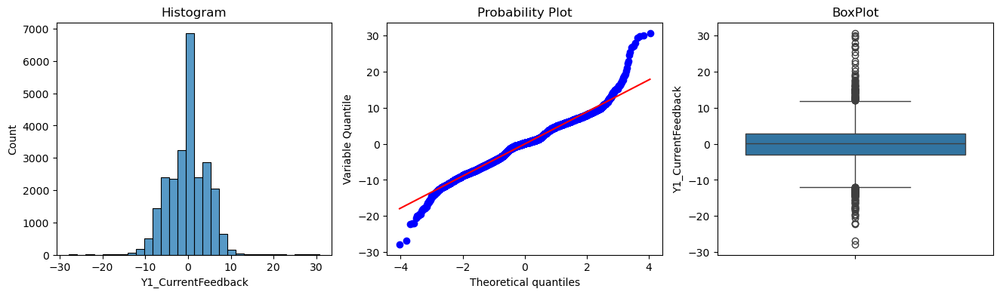

<Figure size 640x480 with 0 Axes>

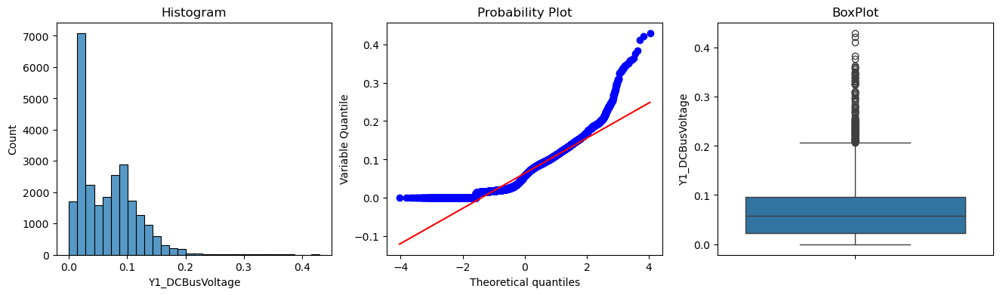

<Figure size 640x480 with 0 Axes>

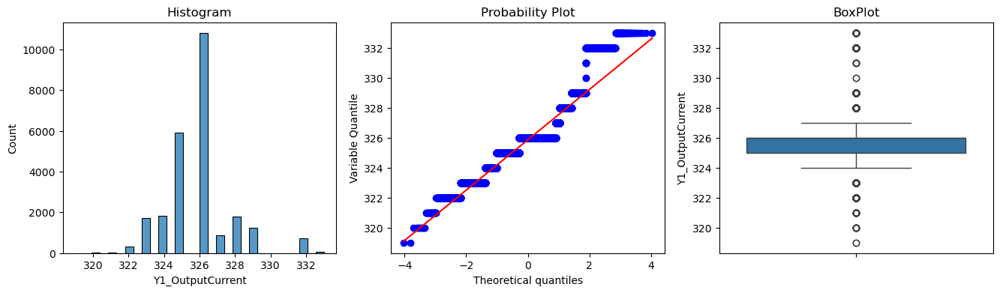

<Figure size 640x480 with 0 Axes>

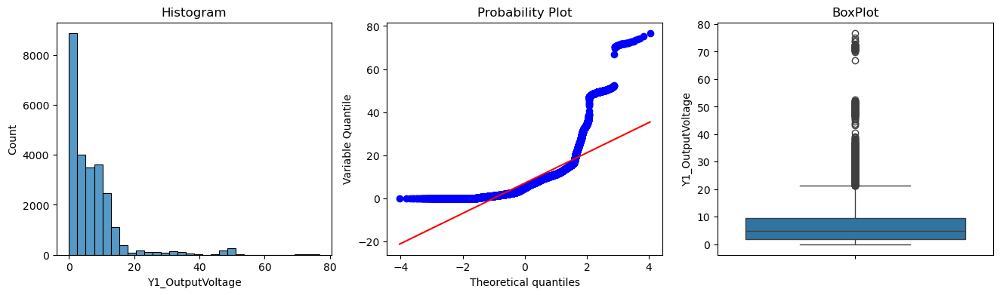

<Figure size 640x480 with 0 Axes>

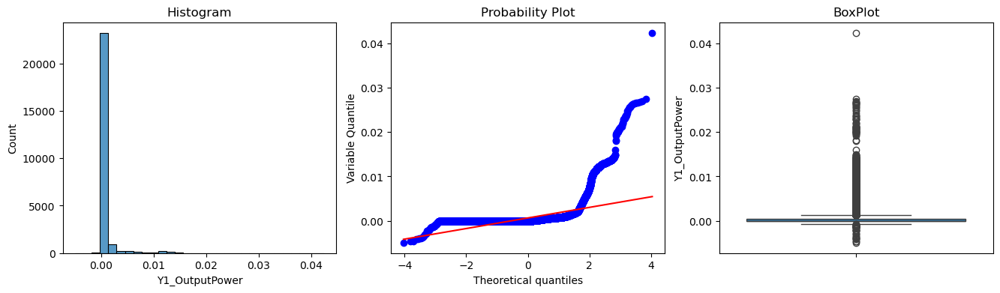

<Figure size 640x480 with 0 Axes>

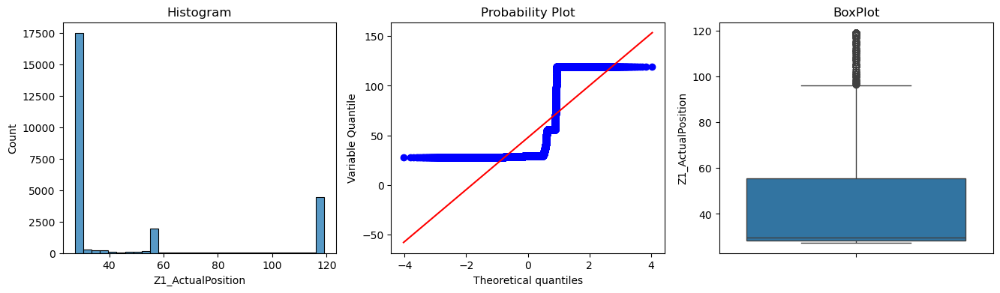

<Figure size 640x480 with 0 Axes>

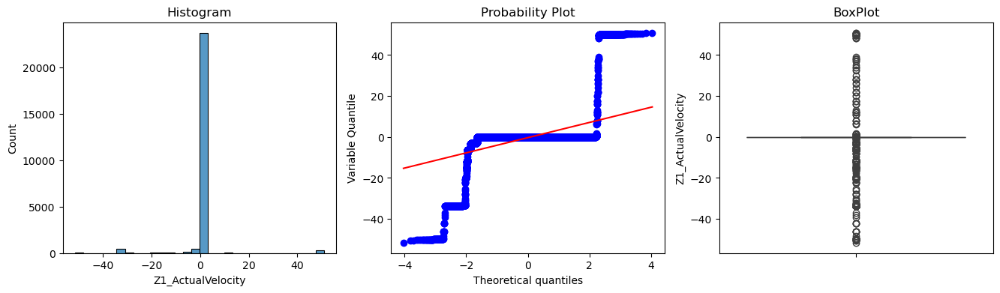

<Figure size 640x480 with 0 Axes>

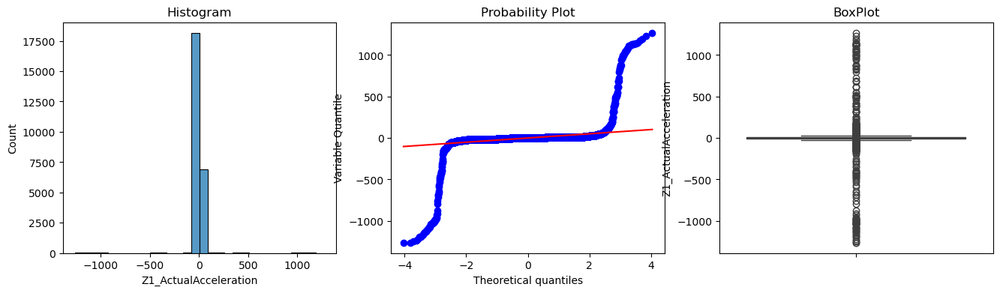

<Figure size 640x480 with 0 Axes>

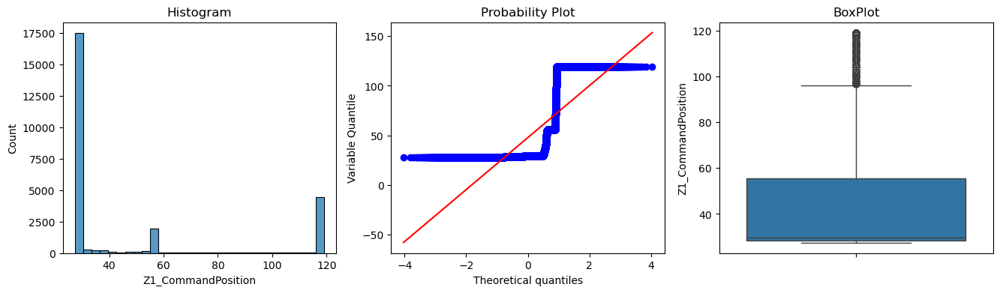

<Figure size 640x480 with 0 Axes>

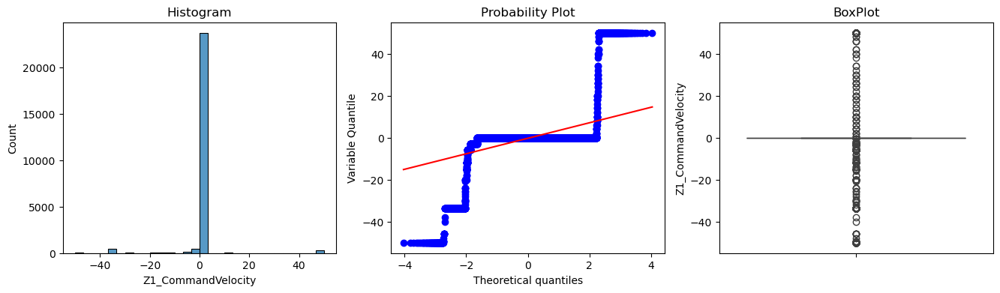

<Figure size 640x480 with 0 Axes>

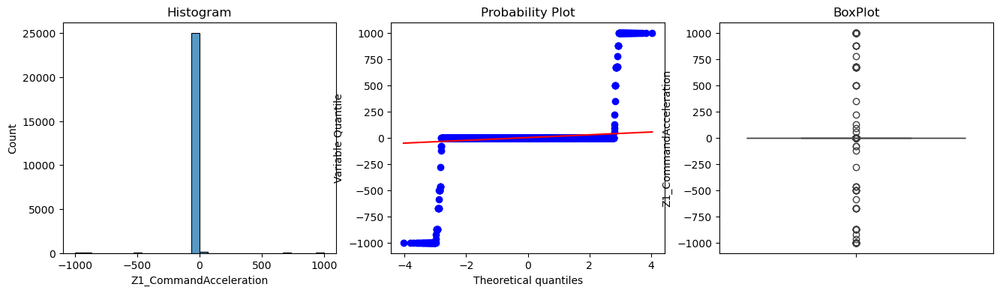

<Figure size 640x480 with 0 Axes>

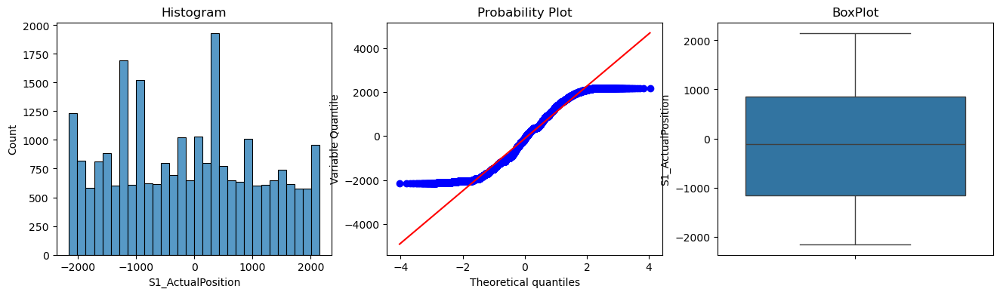

<Figure size 640x480 with 0 Axes>

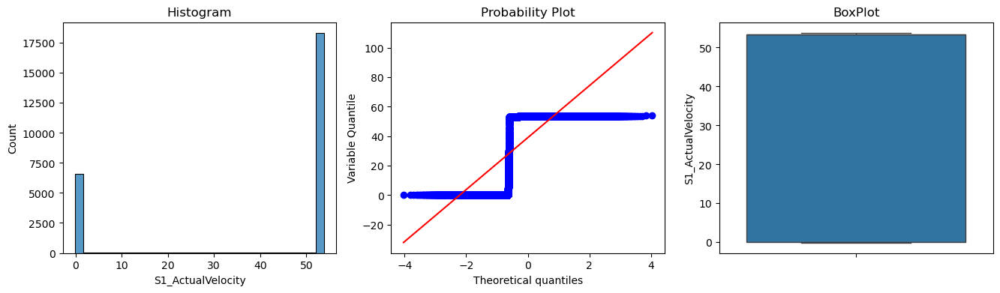

<Figure size 640x480 with 0 Axes>

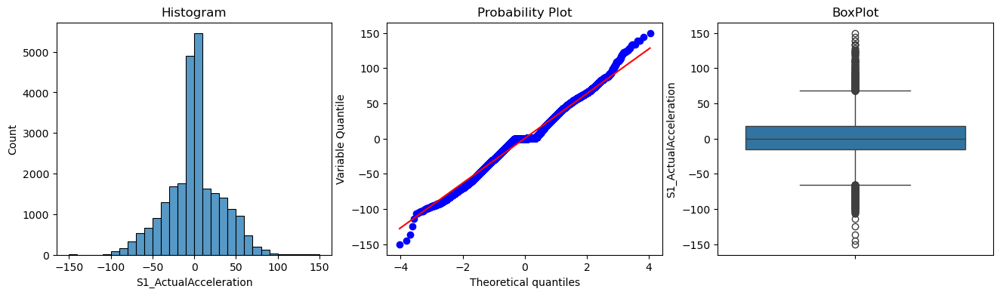

<Figure size 640x480 with 0 Axes>

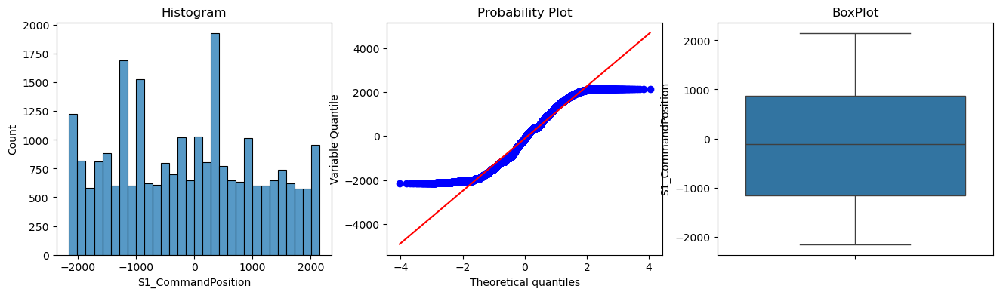

<Figure size 640x480 with 0 Axes>

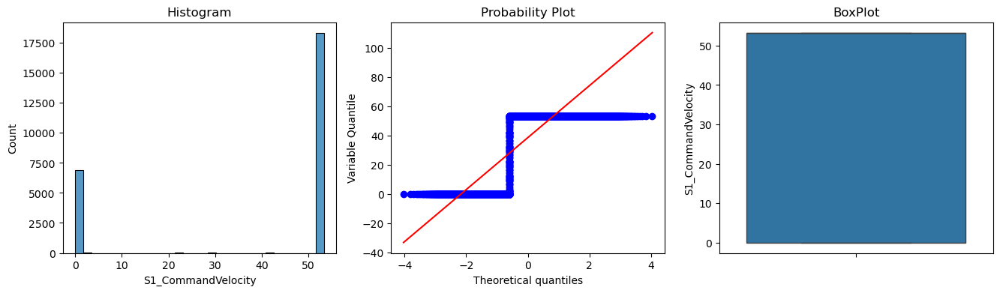

<Figure size 640x480 with 0 Axes>

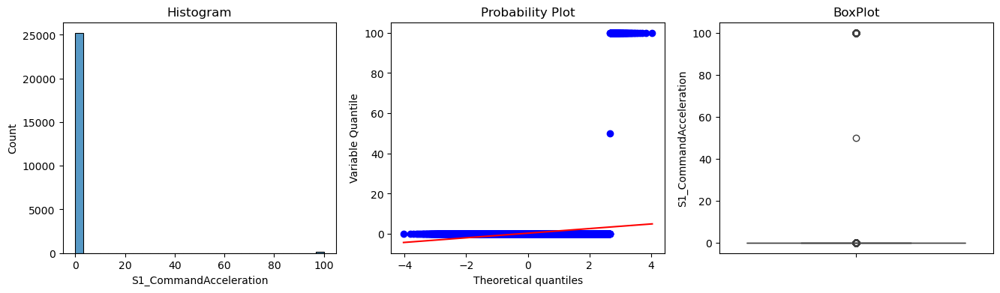

<Figure size 640x480 with 0 Axes>

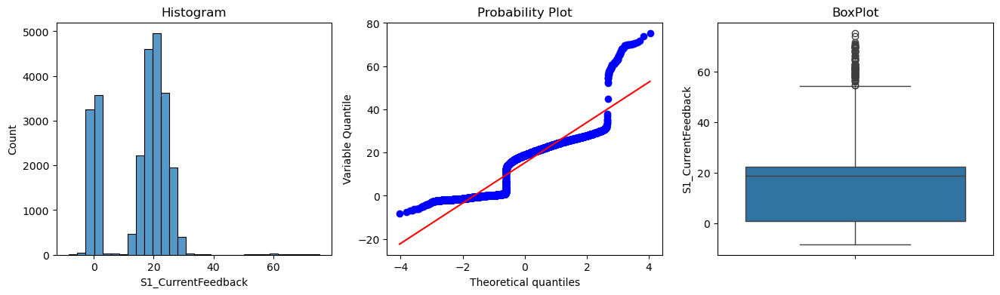

<Figure size 640x480 with 0 Axes>

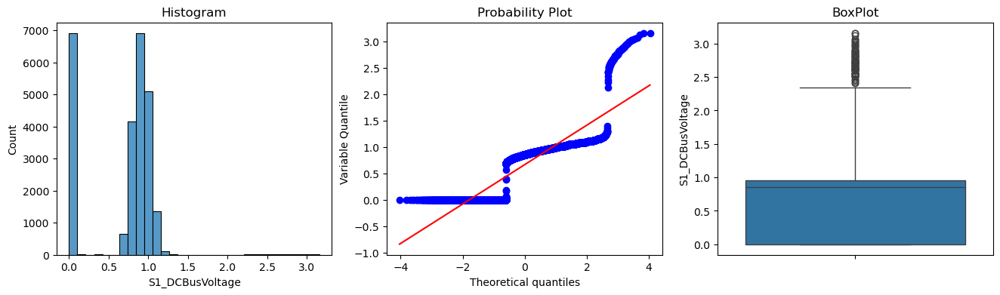

<Figure size 640x480 with 0 Axes>

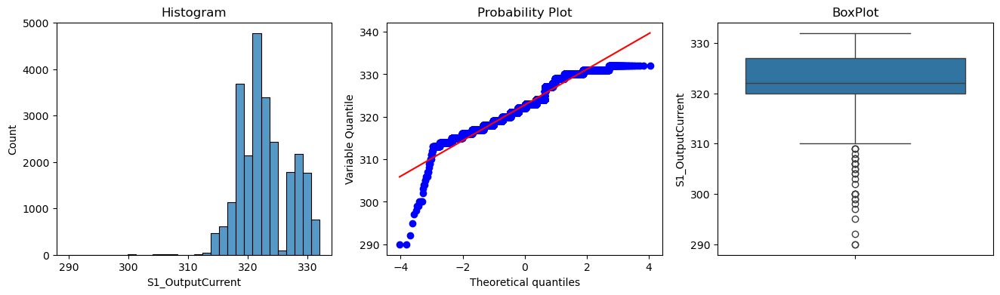

<Figure size 640x480 with 0 Axes>

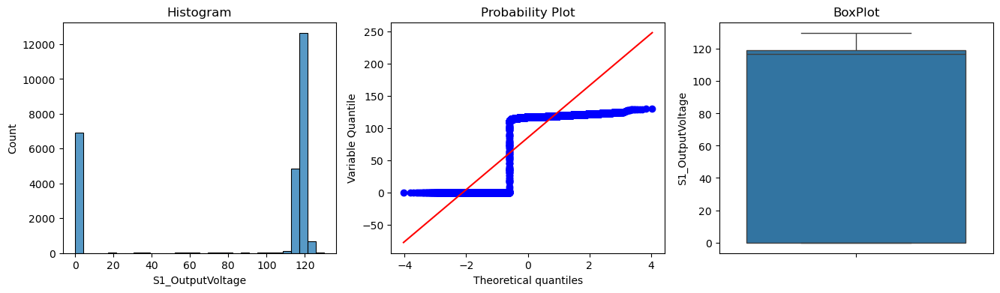

<Figure size 640x480 with 0 Axes>

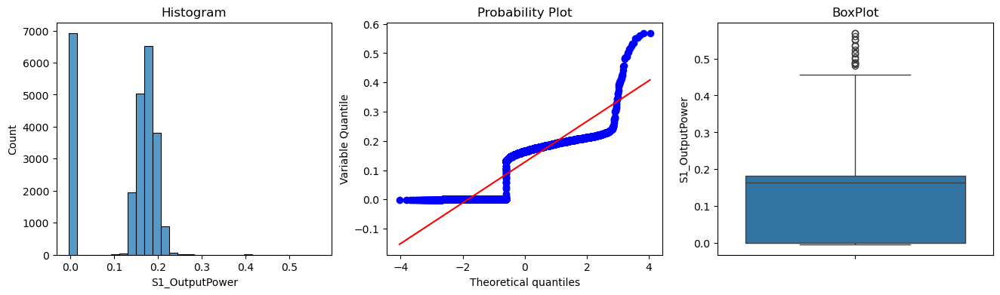

<Figure size 640x480 with 0 Axes>

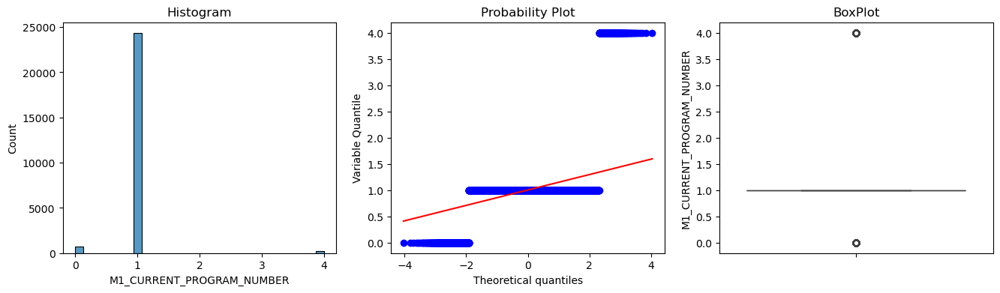

<Figure size 640x480 with 0 Axes>

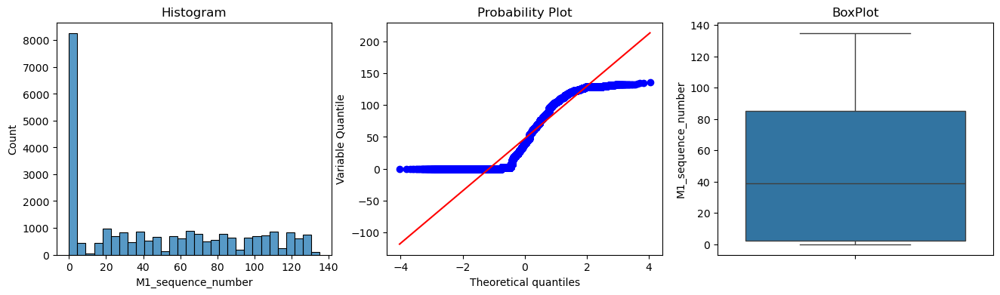

<Figure size 640x480 with 0 Axes>

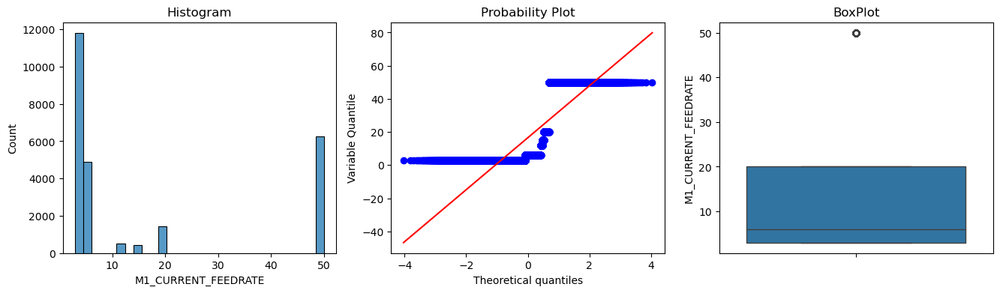

<Figure size 640x480 with 0 Axes>

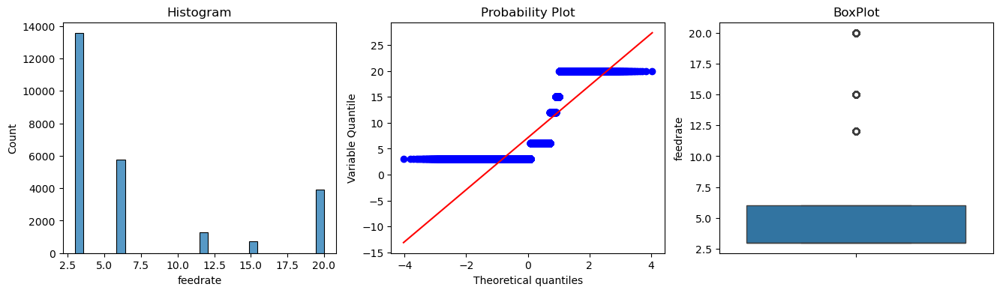

<Figure size 640x480 with 0 Axes>

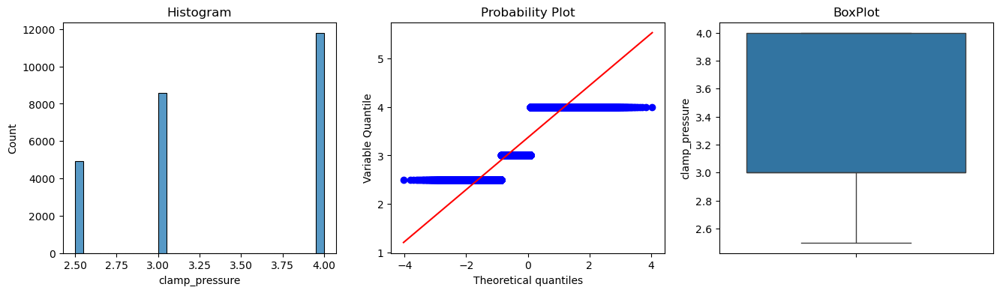

<Figure size 640x480 with 0 Axes>

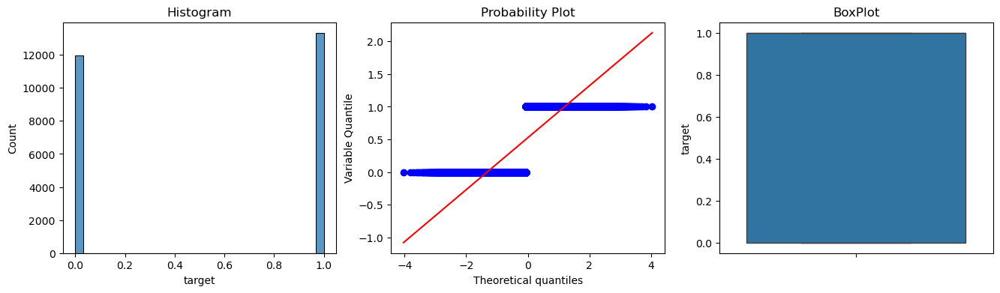

<Figure size 640x480 with 0 Axes>

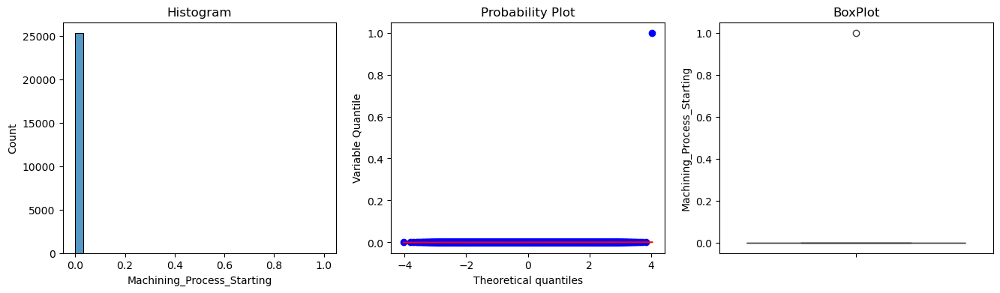

<Figure size 640x480 with 0 Axes>

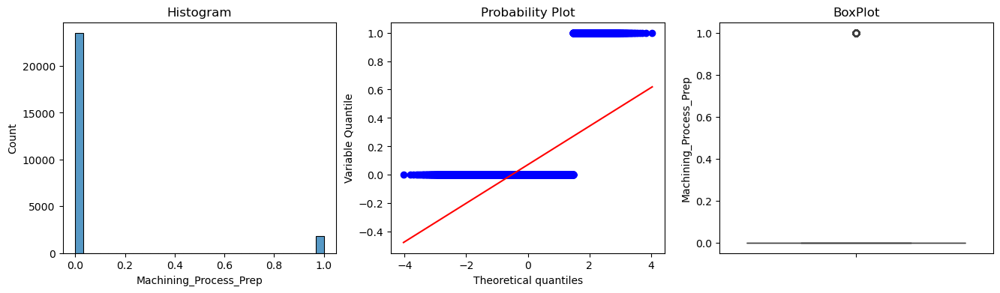

<Figure size 640x480 with 0 Axes>

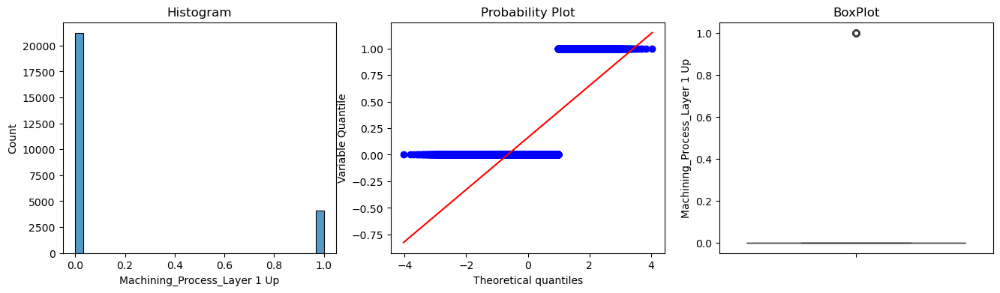

<Figure size 640x480 with 0 Axes>

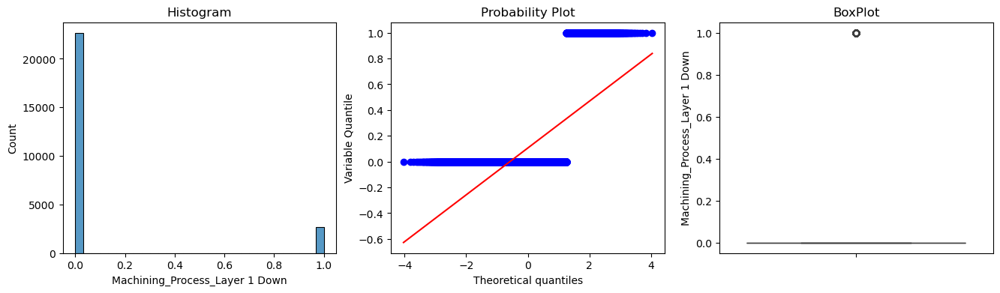

<Figure size 640x480 with 0 Axes>

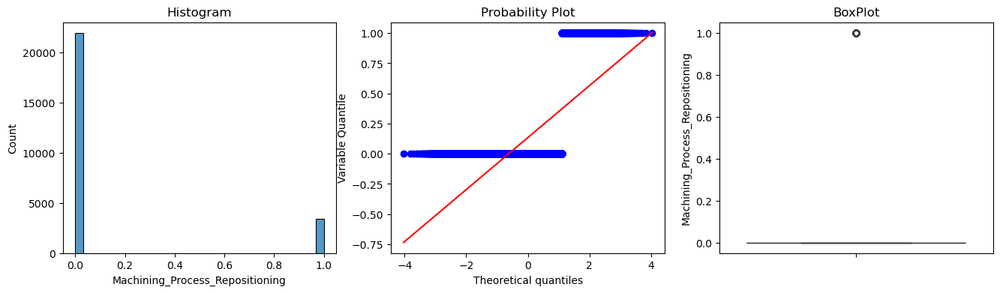

<Figure size 640x480 with 0 Axes>

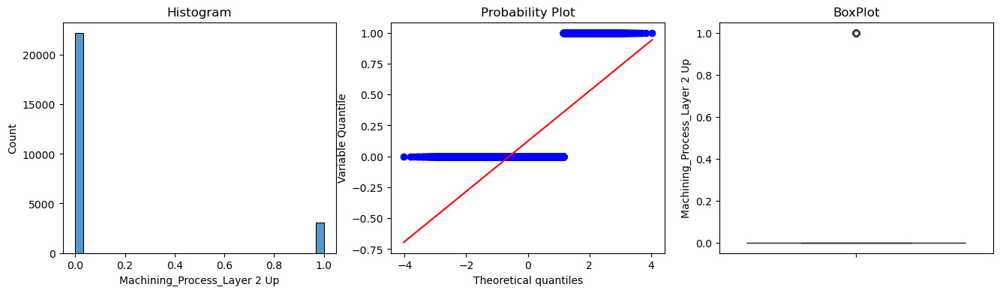

<Figure size 640x480 with 0 Axes>

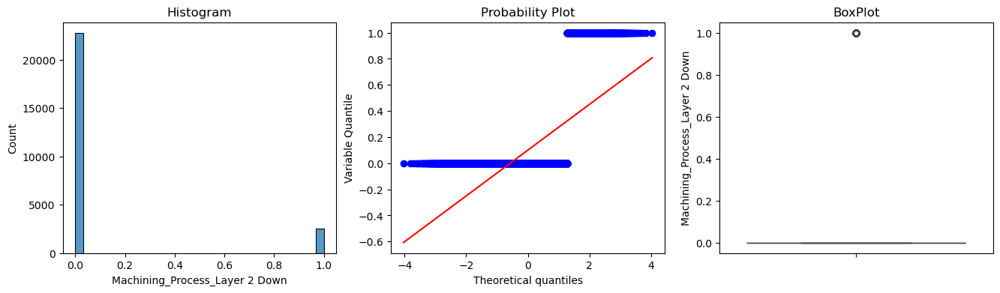

<Figure size 640x480 with 0 Axes>

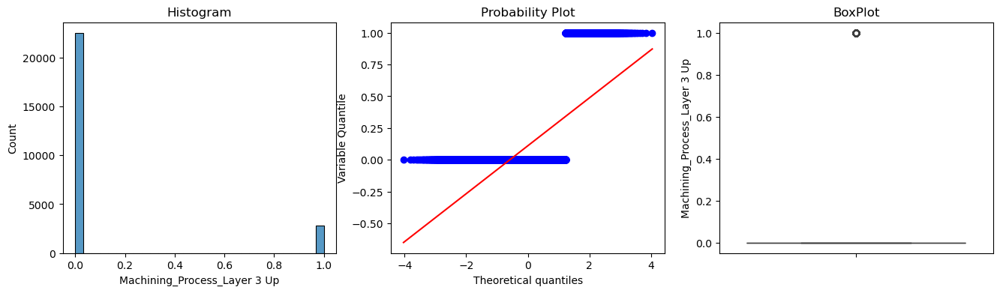

<Figure size 640x480 with 0 Axes>

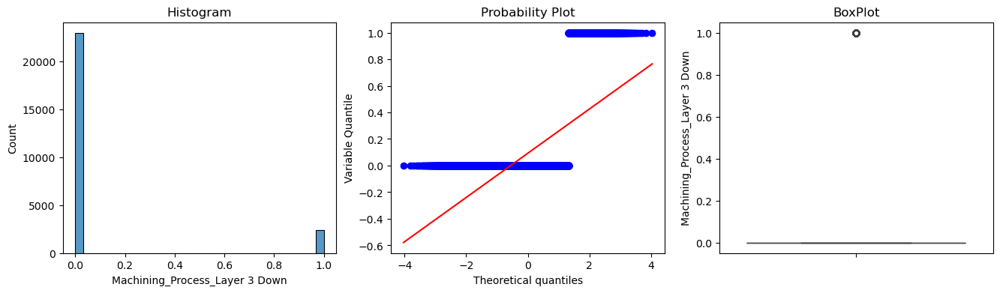

<Figure size 640x480 with 0 Axes>

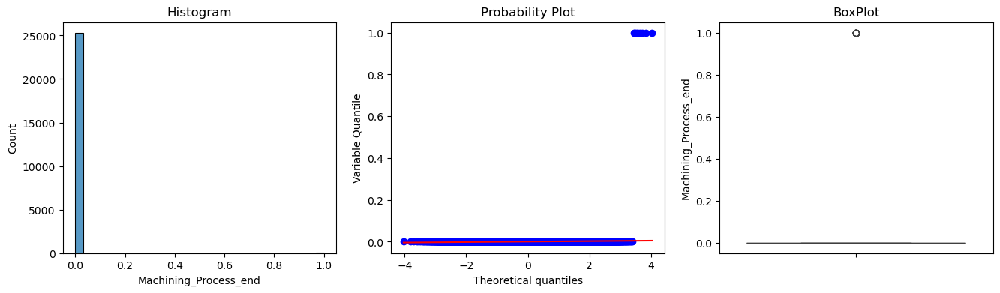

<Figure size 640x480 with 0 Axes>

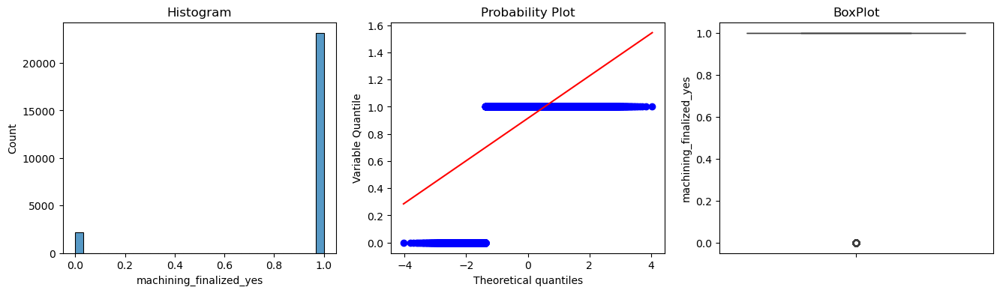

<Figure size 640x480 with 0 Axes>

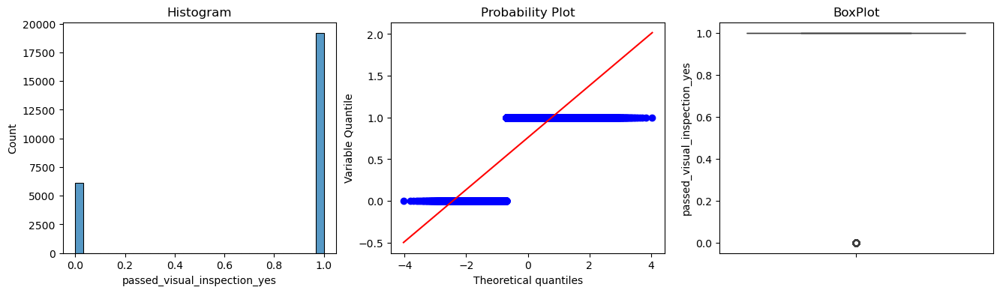

<Figure size 640x480 with 0 Axes>

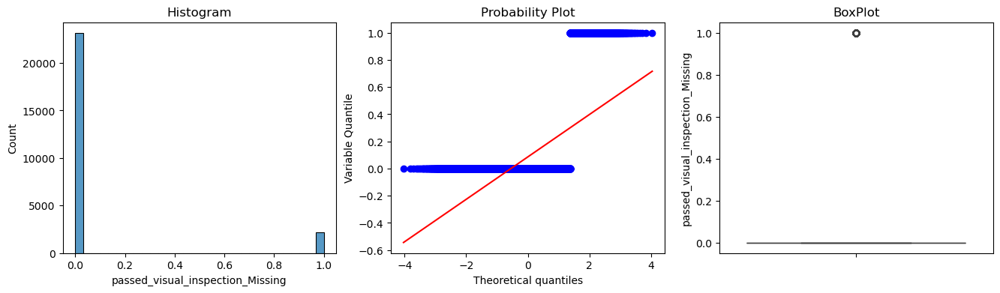

In [22]:
for var in tmp.columns:
    diagnostic_plots(tmp, var)

## 3.2 Correlation Matrix

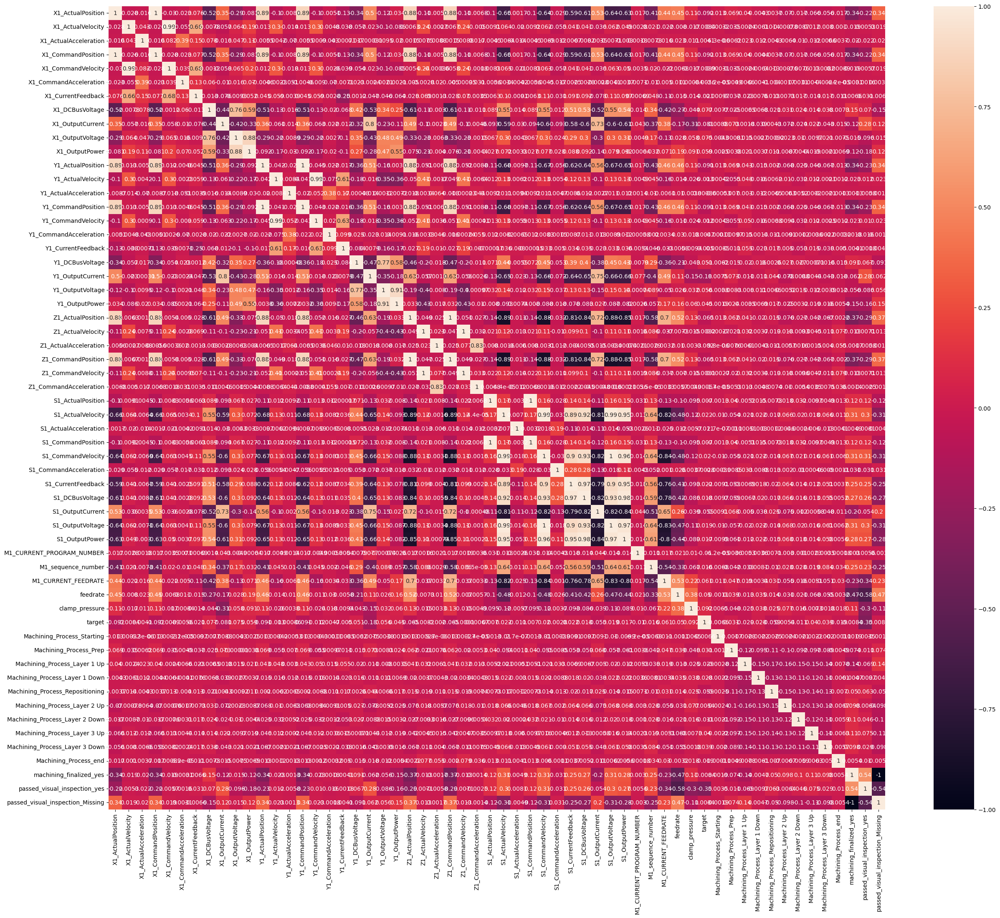

In [23]:
corr_matrix = tmp.corr
plt.figure(figsize = (30, 25))
p = sns.heatmap(corr_matrix(), annot = True)

##### Build the function for plot dependences on Target

In [24]:
def plot_tool_condition_counts(df):
    columns_to_group = [col for col in df.columns if col != 'target']

    for column in columns_to_group:
        grouped_counts = df.groupby([column, 'target']).size().unstack()

        grouped_counts.plot(kind = 'bar', stacked = True, color = ['#1f77b4', '#ff7f0e'])
        plt.title(f'{column} grouped by target')
        plt.xlabel('Condition')
        plt.ylabel(column)
        plt.xticks()
        plt.legend(title = 'ToolCondition', labels = ['unworn', 'worn'])
        plt.show()

## 3.3 We look at the dependence of all variables on our Target

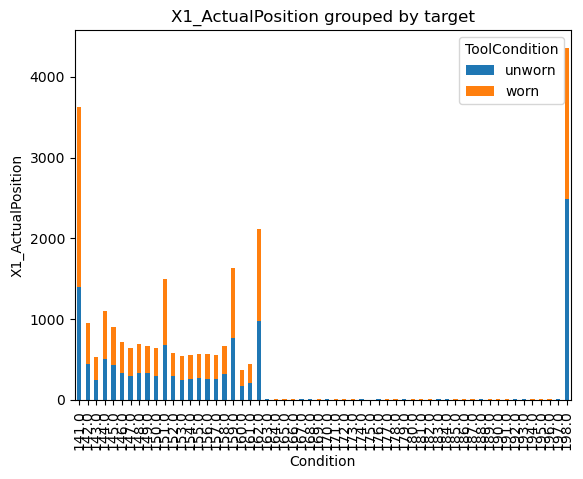

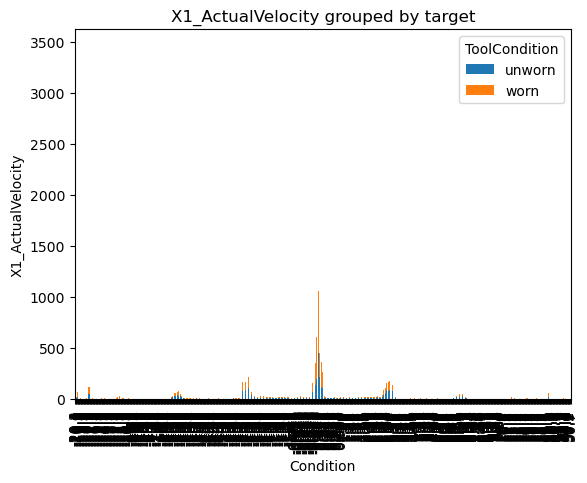

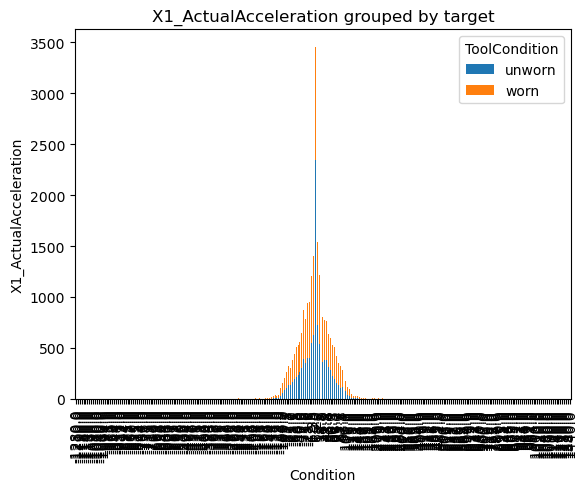

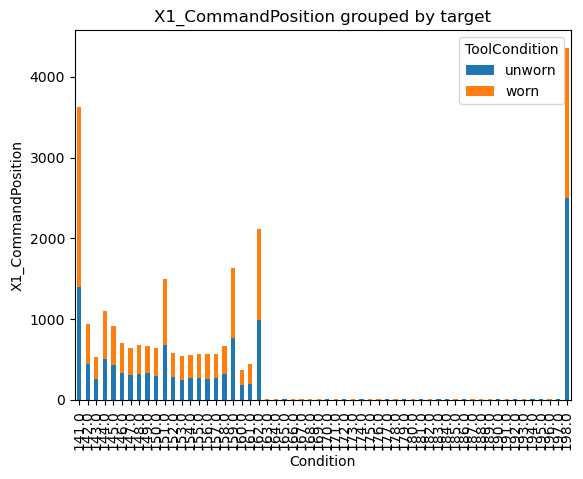

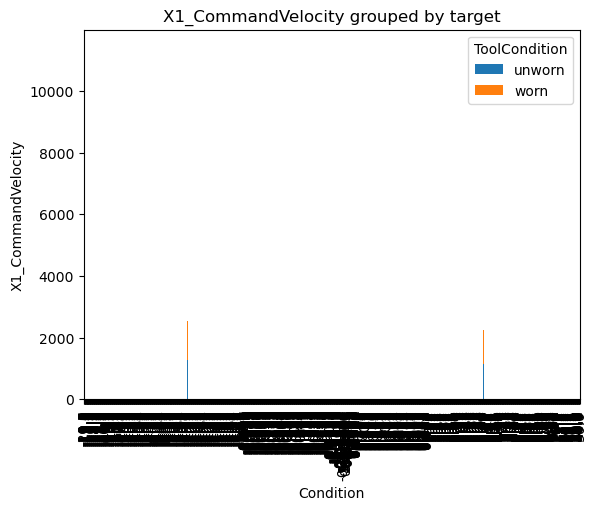

...

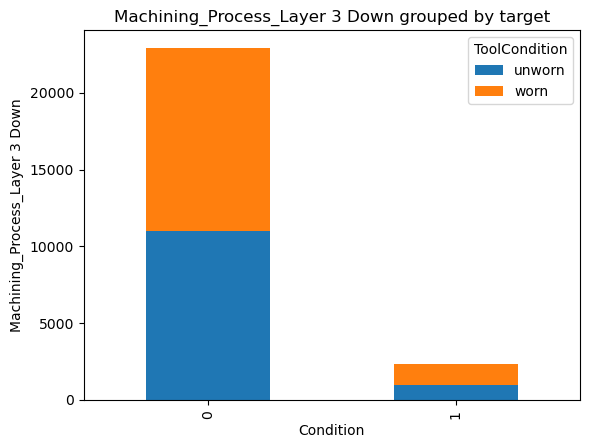

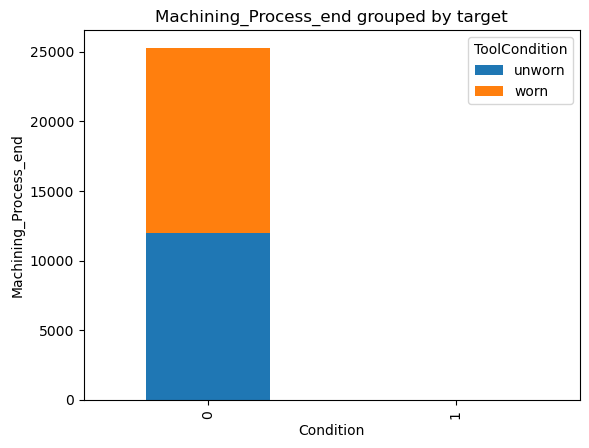

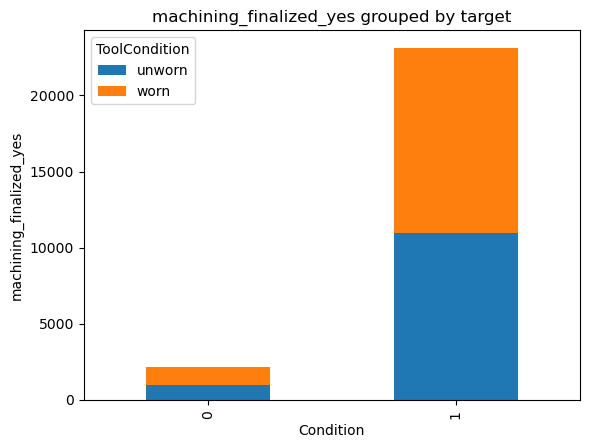

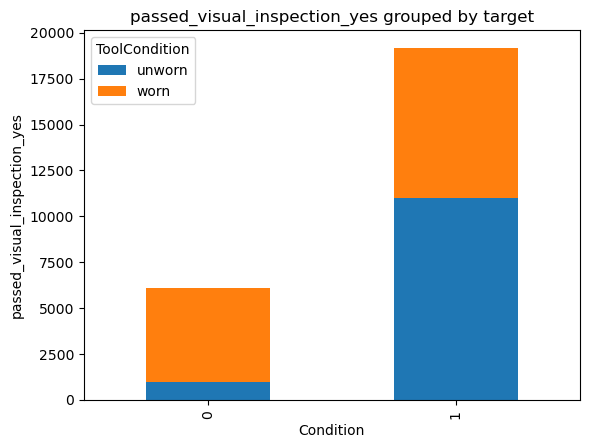

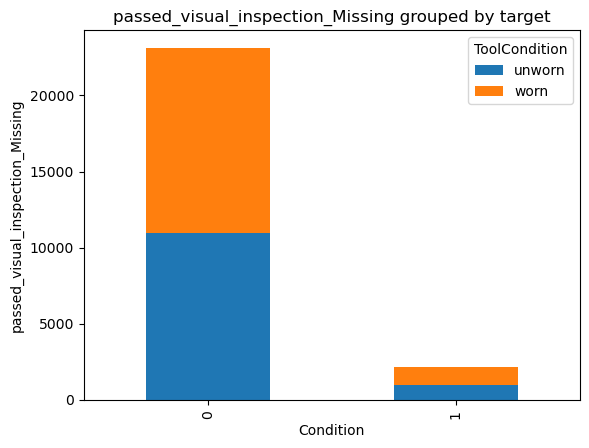

In [25]:
plot_tool_condition_counts(tmp)

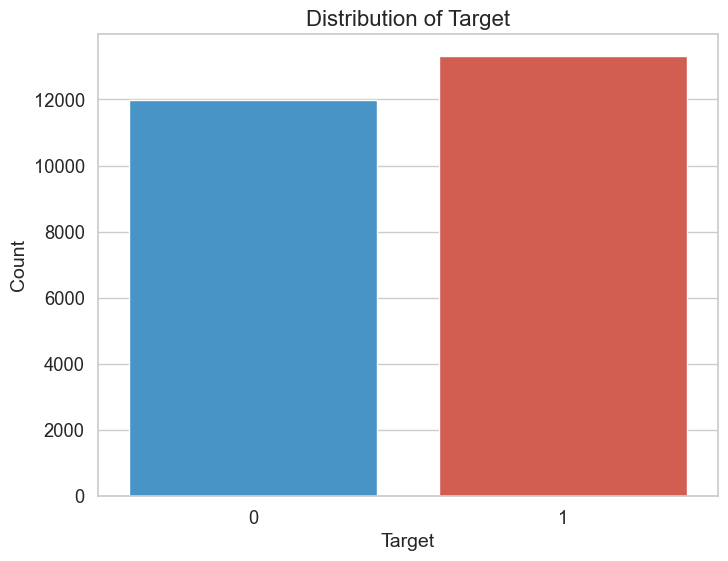

In [26]:
sns.set(style="whitegrid", palette="pastel", font_scale=1.2)
plt.figure(figsize=(8, 6))

sns.countplot(x='target', hue='target', data=tmp, palette=["#3498db", "#e74c3c"], legend=False)

plt.xlabel('Target', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.title('Distribution of Target', fontsize=16)

plt.show()

In our dataset, the target variables is nearly balanced, meaning that the classes are represented in roughly
equal proportions, making it easier to train the model without underfitting or overfitting problems

## 4. Separate to train and test split

In [27]:
X = df.drop(['target'], axis = 1)
y = df['target']

X.shape, y.shape

((25286, 47), (25286,))

In [28]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25)
X_train.shape, X_test.shape

((18964, 47), (6322, 47))

## 5. Feature Engineering

In [29]:
def run_randomForest(X_train, X_test, y_train, y_test):
    
    rf = RandomForestClassifier(n_estimators = 50, random_state = 42, max_depth = 5)
    rf.fit(X_train, y_train)
    
    print('Train set')
    pred = rf.predict_proba(X_train)
    print('Random Forest roc-auc: {}'.format(roc_auc_score(y_train, pred[:, 1])))
    
    print('Test set')
    pred = rf.predict_proba(X_test)
    print('Random Forest roc-auc: {}'.format(roc_auc_score(y_test, pred[:, 1])))

The function evaluates the performance of the model with default parameters and with different methods for processing NA values

#### Impute missing value with different methods

## 5.1 Random Sample Imputer

In [30]:
random_pipe = Pipeline(steps = [
    ('random_pipe', RandomSampleImputer()),
    ('ohe_enc', OneHotEncoder())
])
random_pipe.fit(X_train, y_train)

random_X_train = random_pipe.transform(X_train)
random_X_test = random_pipe.transform(X_test)

## 5.2 Categorical Imputer

In [31]:
categorical_pipe = Pipeline(steps = [
    ('imputer_categ', CategoricalImputer(variables = ['passed_visual_inspection'], imputation_method = 'frequent')),
    ('ohe_enc', OneHotEncoder(variables = ['Machining_Process', 'machining_finalized', 'passed_visual_inspection'], drop_last = True))
])
categorical_pipe.fit(X_train, y_train)

frequent_X_train = categorical_pipe.transform(X_train)
frequent_X_test = categorical_pipe.transform(X_test)

## 5.3 Simple Imputer

In [32]:
simple_pipe = Pipeline(steps = [
    ('imputer', CategoricalImputer(imputation_method = 'missing')),
    ('ohe_enc', OneHotEncoder(drop_last = True))
])
simple_pipe.fit(X_train, y_train)

simple_X_train = simple_pipe.transform(X_train)
simple_X_test = simple_pipe.transform(X_test)

#### 5.4 Results

In [33]:
# RandomSampleImputer
run_randomForest(random_X_train, random_X_test, y_train, y_test)

Train set
Random Forest roc-auc: 0.9798731543047482
Test set
Random Forest roc-auc: 0.9768453802856297


In [34]:
# CategoricalImputer method frequent
run_randomForest(frequent_X_train, frequent_X_test, y_train, y_test)

Train set
Random Forest roc-auc: 0.9564066951072505
Test set
Random Forest roc-auc: 0.9535865963831985


In [35]:
# CategoricalImputer method missing
run_randomForest(simple_X_train, simple_X_test, y_train, y_test)

Train set
Random Forest roc-auc: 0.9660767612505938
Test set
Random Forest roc-auc: 0.9618582871070237


### 5.5 Analysis constant, duplicated and correlated features

In [36]:
select_pipe = Pipeline(steps = [
    ('constant', DropConstantFeatures(tol = 0.998)),
    ('duplicated', DropDuplicateFeatures()),
    ('correlated', SmartCorrelatedSelection(selection_method = 'variance'))
])
select_pipe.fit(random_X_train)

Pipeline(steps=[('constant', DropConstantFeatures(tol=0.998)),
                ('duplicated', DropDuplicateFeatures()),
                ('correlated',
                 SmartCorrelatedSelection(selection_method='variance'))])

In [37]:
train_X = select_pipe.fit_transform(random_X_train)
test_X = select_pipe.transform(random_X_test)
train_X.shape

(18964, 35)

In [38]:
train_X.shape, random_X_train.shape

((18964, 35), (18964, 59))

Out of 58 variables, 35 variables remained, after the operation of selecting variables using methods
(constant, duplicated, correlated) feature selection

Let's look at the performance of model after feature selecting

In [39]:
# Model performance after feature selection
run_randomForest(train_X, test_X, y_train, y_test)

Train set
Random Forest roc-auc: 0.8496247817929856
Test set
Random Forest roc-auc: 0.8402480784342783


###### The results show that performance dropped by about 10% after variable selection, suggesting that overfitting
###### occurred before variable selection

### 5.6 Analysis features after outlier handling

In [40]:
def diagnostic_plots_2(dataset, variable):
    
    fig = plt.figure()
    plt.figure(figsize = (16, 4))
    
    plt.subplot(1, 2, 1)
    sns.histplot(dataset[variable], bins = 30)
    plt.title('Histogram')
    
    plt.subplot(1, 2, 2)
    stats.probplot(dataset[variable], dist = 'norm', plot = plt)
    plt.ylabel('Variable Quantile')

/var/folders/qf/ndc8qq8x0nn19g0jqjstz4j80000gn/T/ipykernel_42099/967774766.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


<Figure size 640x480 with 0 Axes>

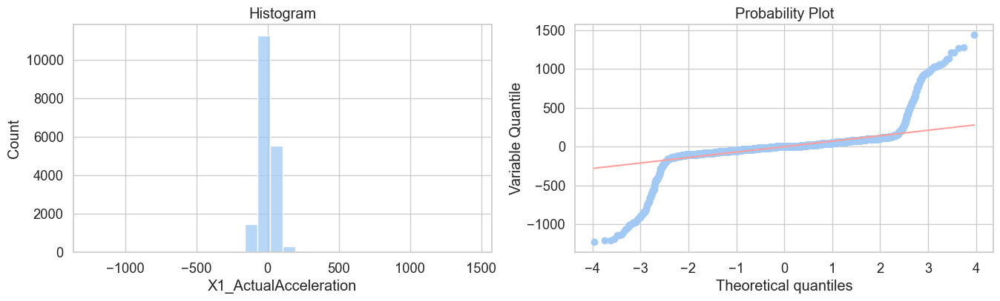

<Figure size 640x480 with 0 Axes>

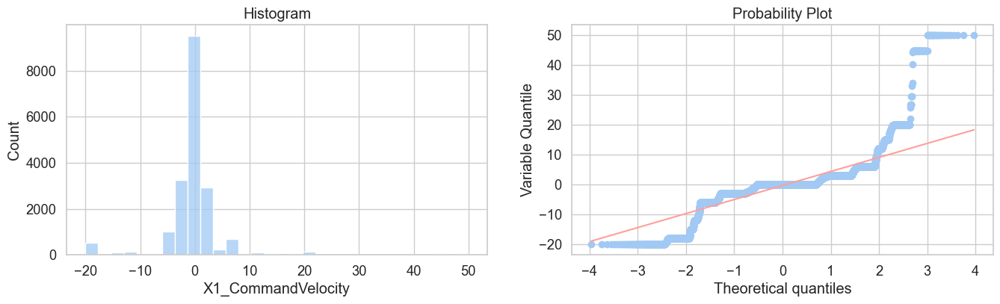

<Figure size 640x480 with 0 Axes>

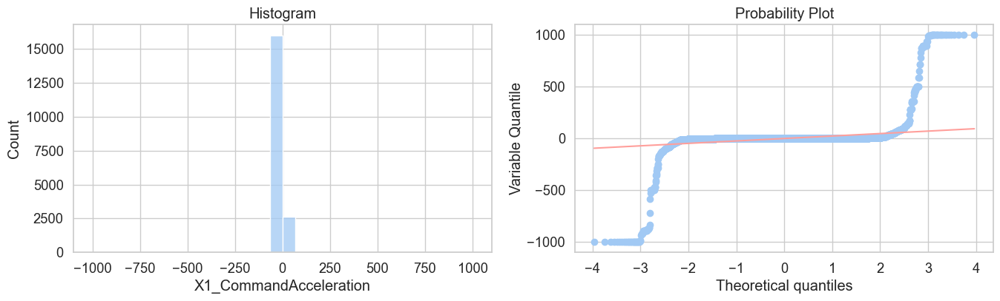

<Figure size 640x480 with 0 Axes>

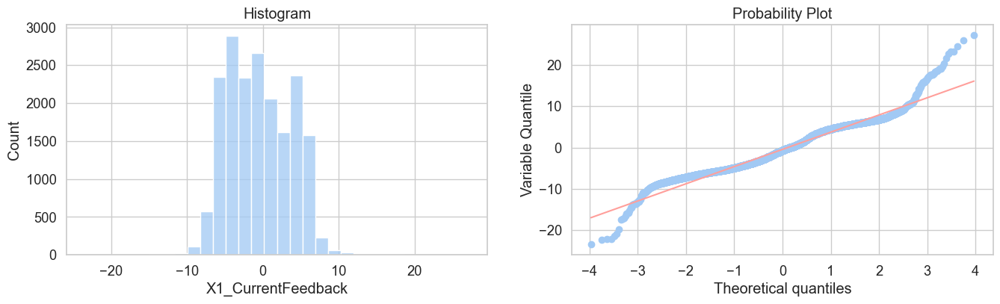

<Figure size 640x480 with 0 Axes>

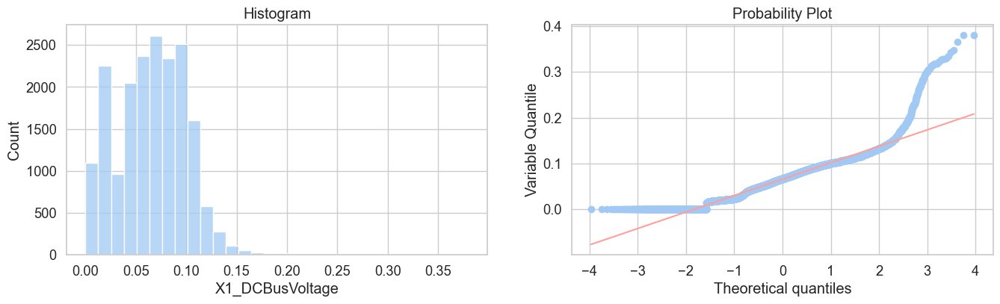

<Figure size 640x480 with 0 Axes>

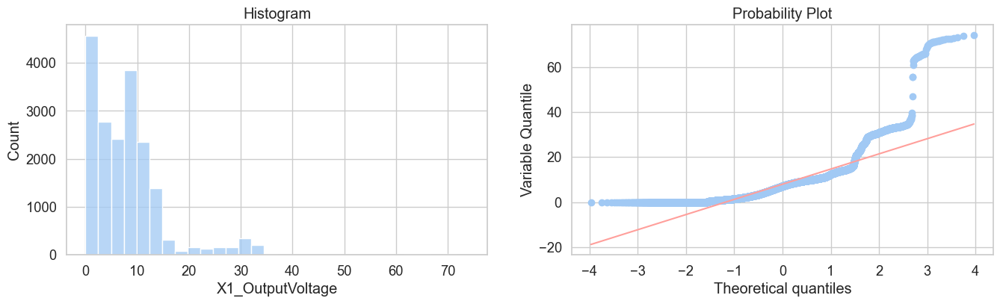

<Figure size 640x480 with 0 Axes>

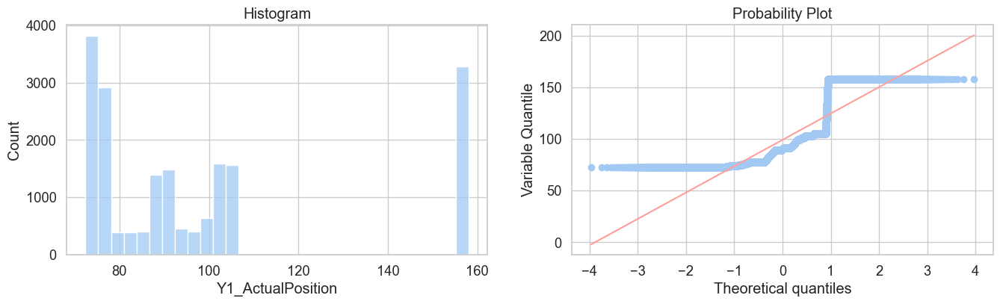

<Figure size 640x480 with 0 Axes>

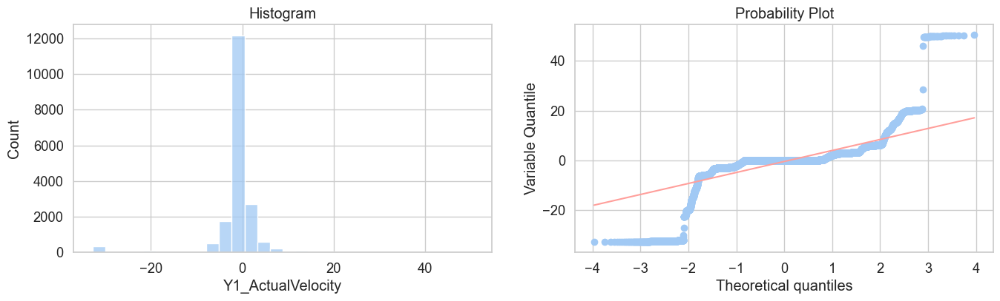

<Figure size 640x480 with 0 Axes>

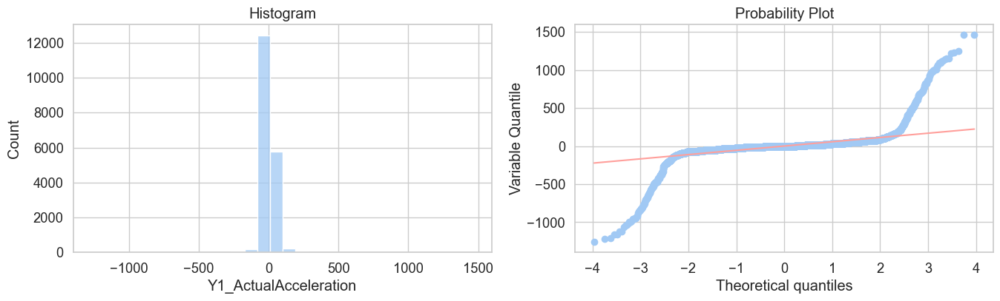

<Figure size 640x480 with 0 Axes>

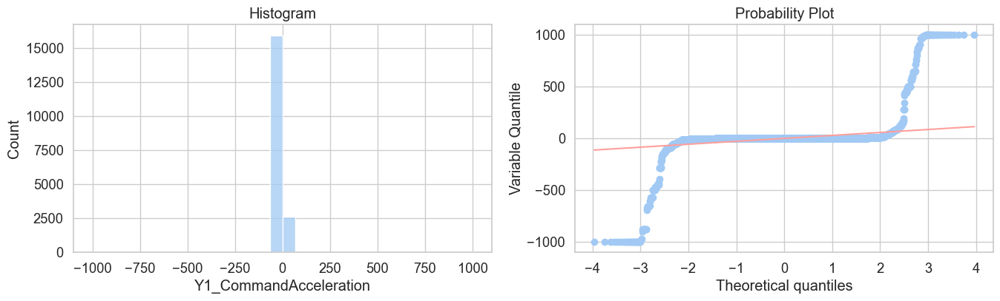

<Figure size 640x480 with 0 Axes>

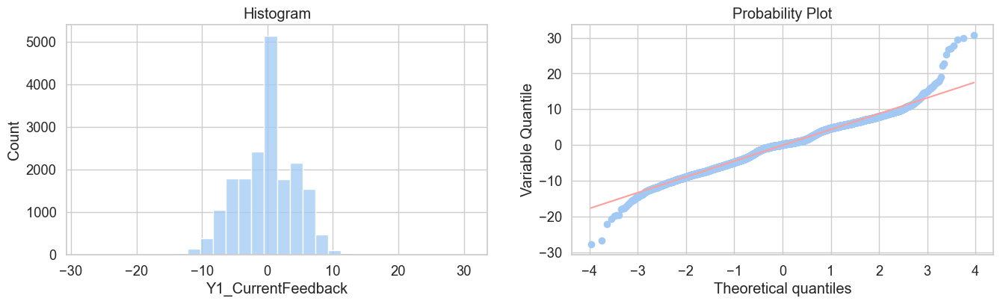

<Figure size 640x480 with 0 Axes>

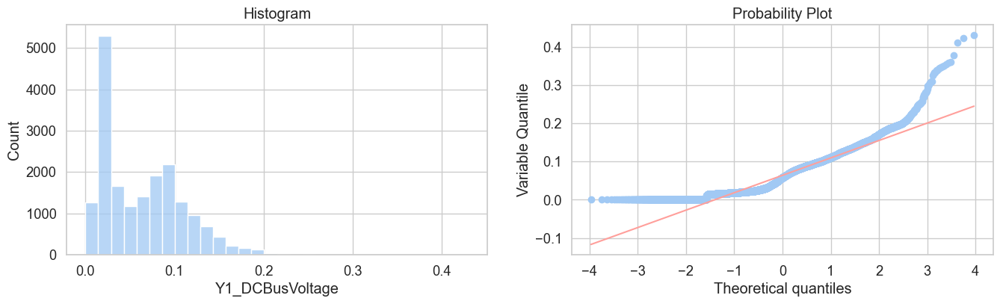

<Figure size 640x480 with 0 Axes>

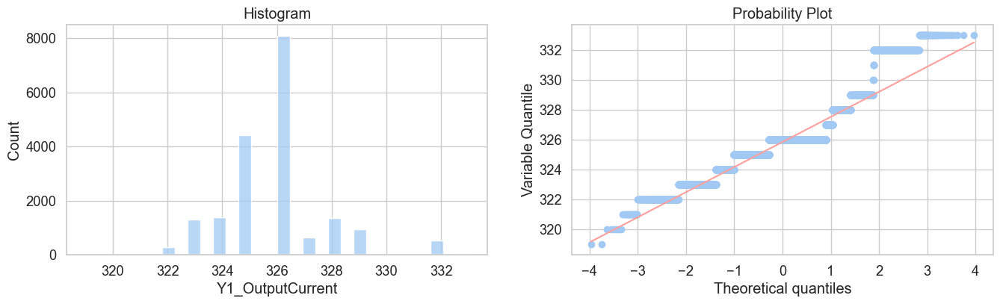

<Figure size 640x480 with 0 Axes>

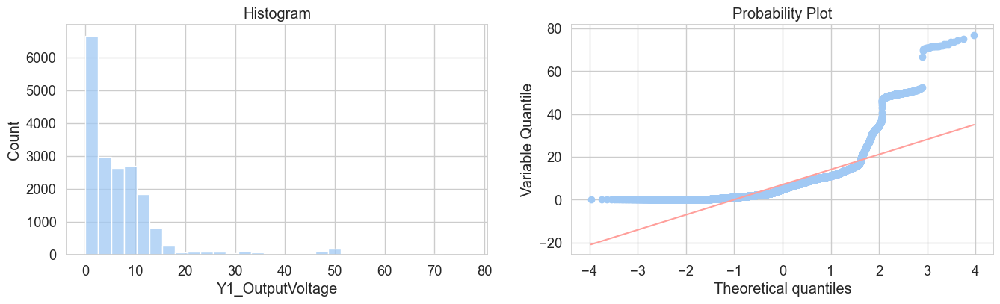

<Figure size 640x480 with 0 Axes>

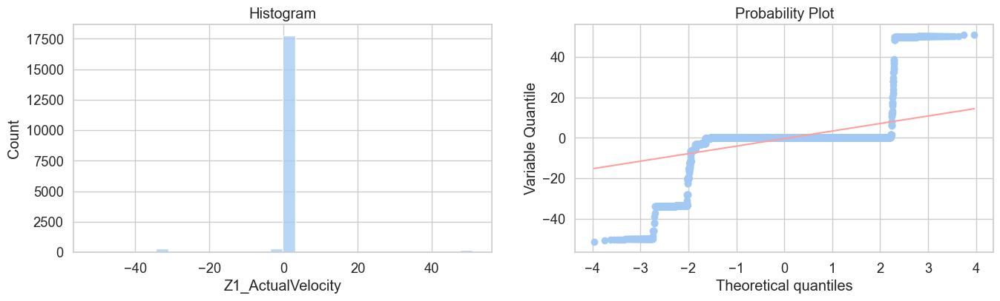

<Figure size 640x480 with 0 Axes>

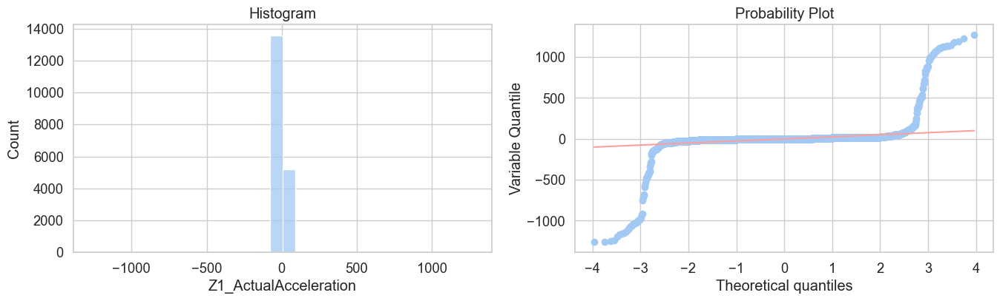

<Figure size 640x480 with 0 Axes>

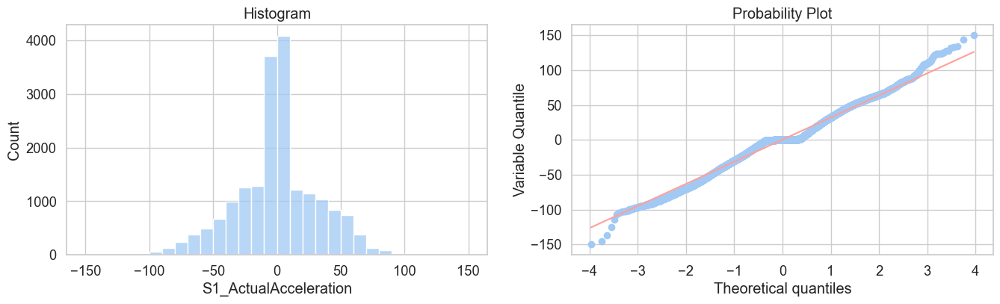

<Figure size 640x480 with 0 Axes>

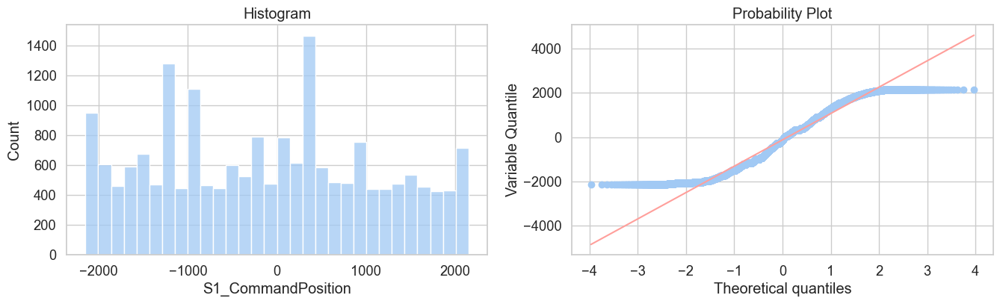

<Figure size 640x480 with 0 Axes>

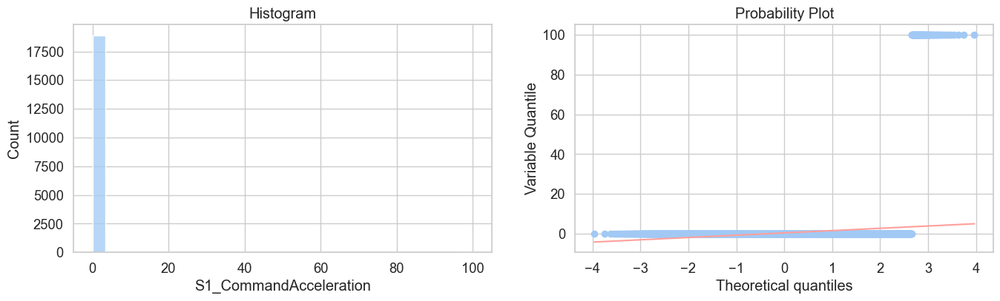

<Figure size 640x480 with 0 Axes>

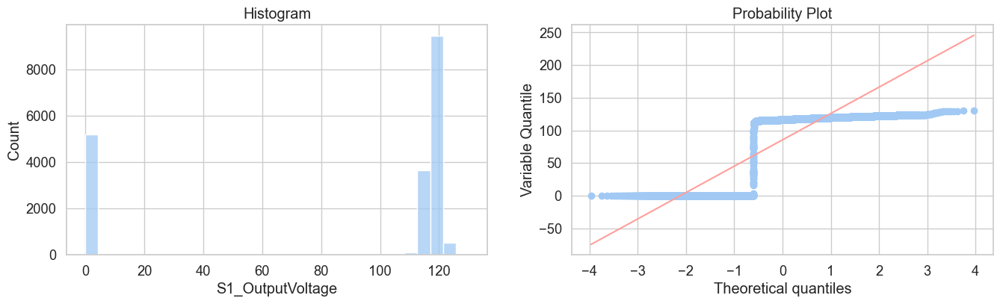

<Figure size 640x480 with 0 Axes>

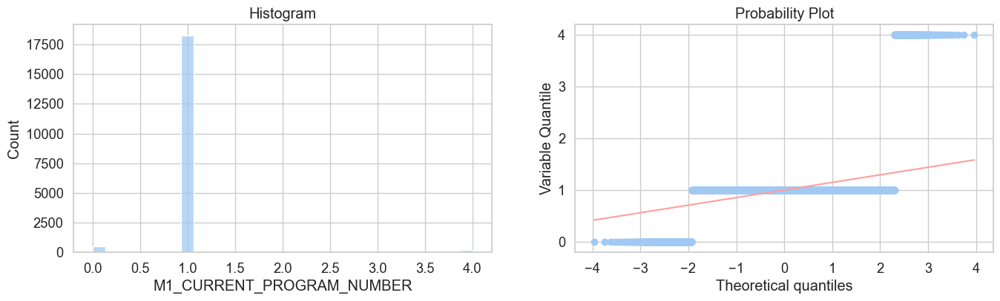

<Figure size 640x480 with 0 Axes>

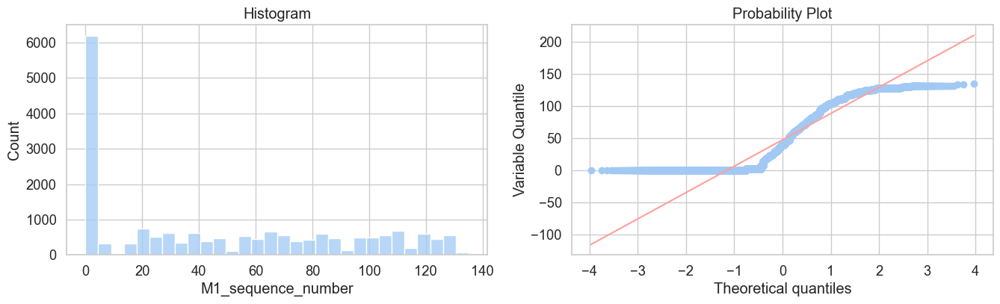

<Figure size 640x480 with 0 Axes>

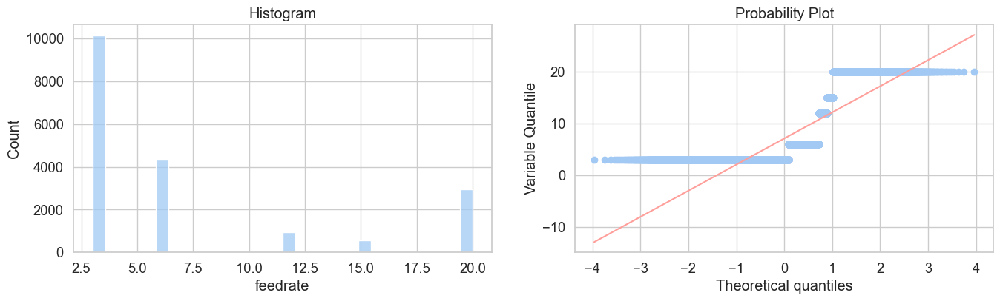

<Figure size 640x480 with 0 Axes>

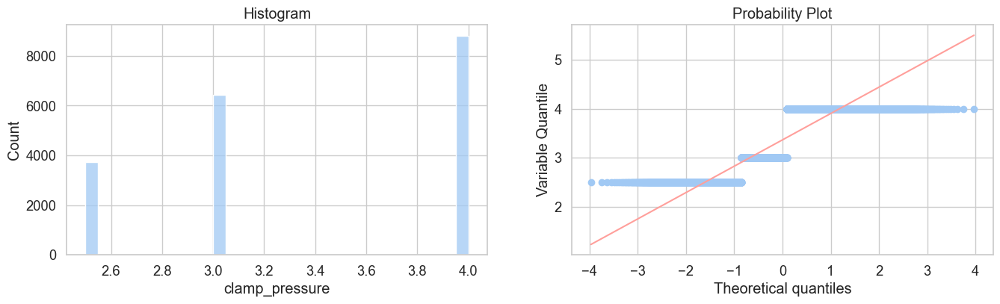

<Figure size 640x480 with 0 Axes>

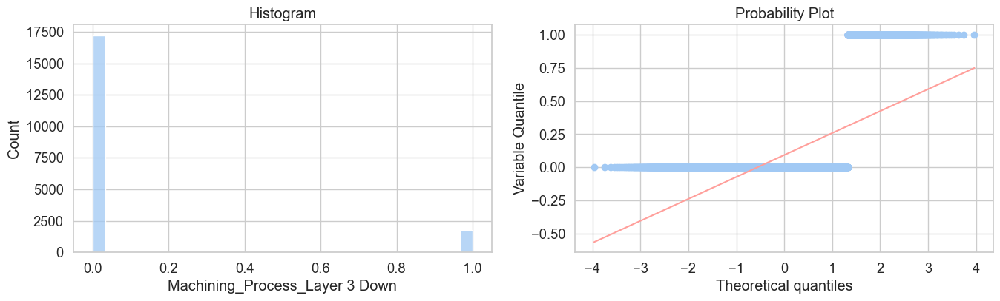

<Figure size 640x480 with 0 Axes>

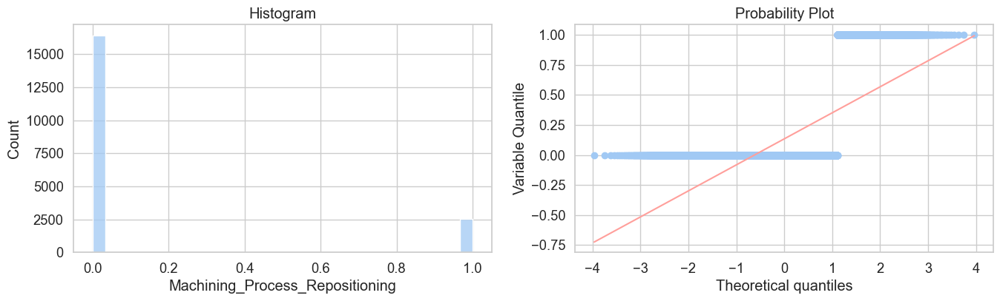

<Figure size 640x480 with 0 Axes>

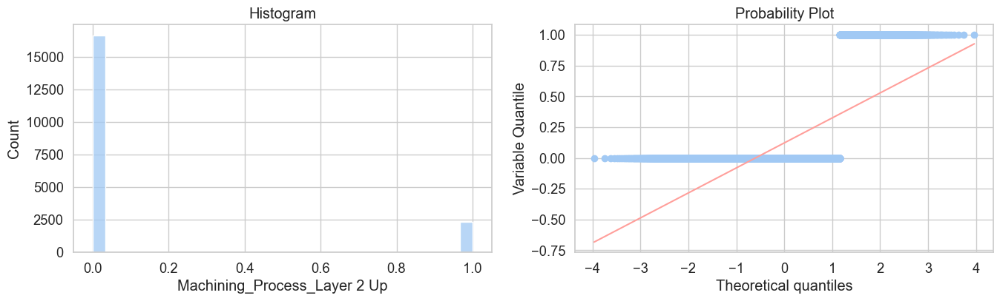

<Figure size 640x480 with 0 Axes>

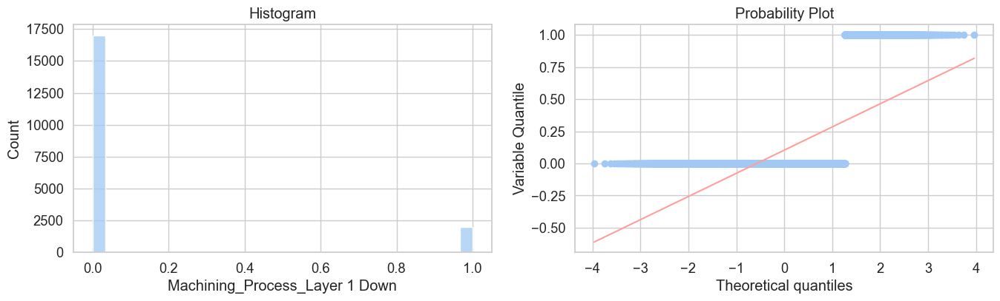

<Figure size 640x480 with 0 Axes>

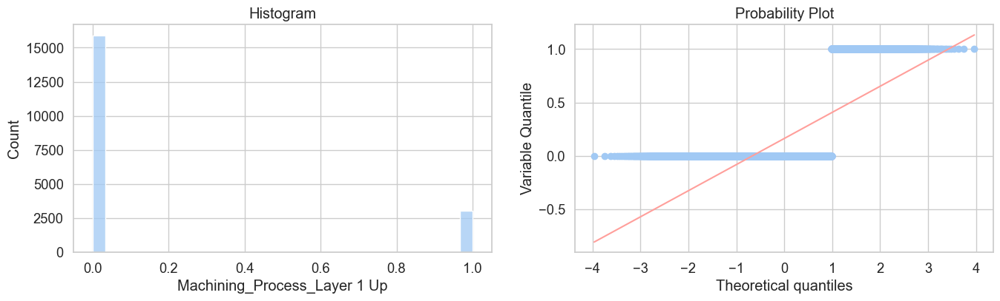

<Figure size 640x480 with 0 Axes>

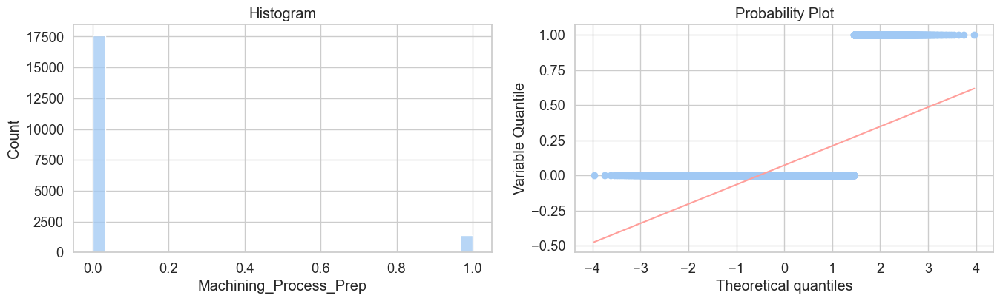

<Figure size 640x480 with 0 Axes>

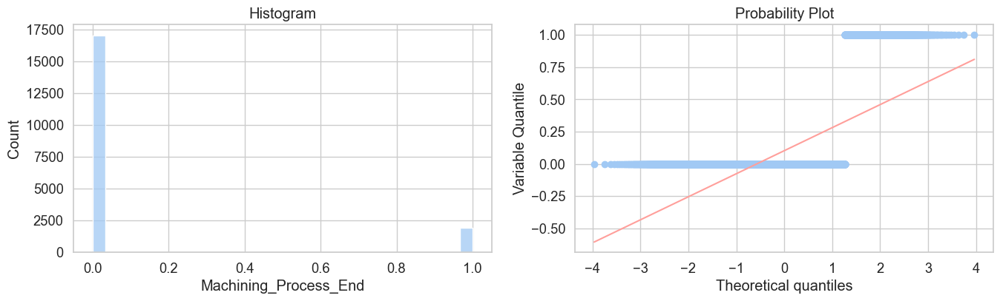

<Figure size 640x480 with 0 Axes>

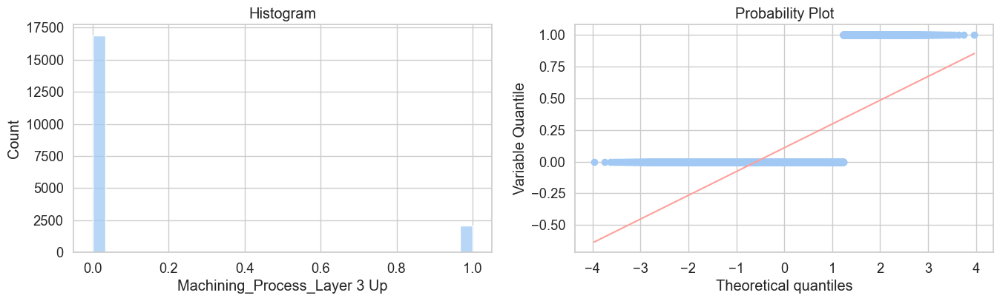

<Figure size 640x480 with 0 Axes>

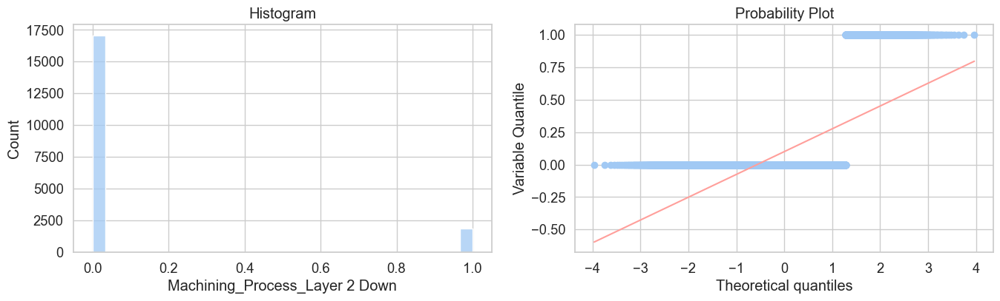

<Figure size 640x480 with 0 Axes>

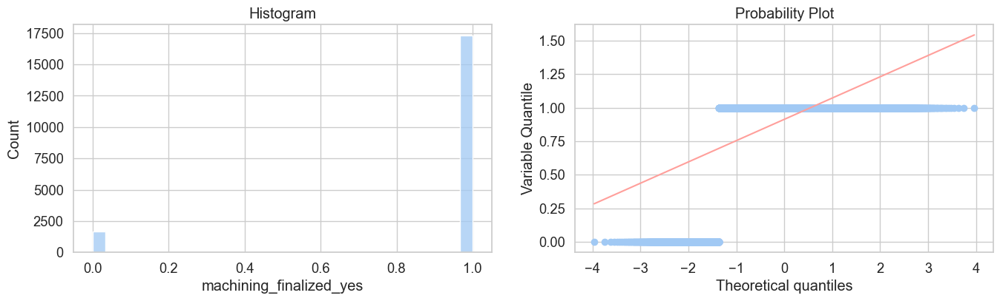

<Figure size 640x480 with 0 Axes>

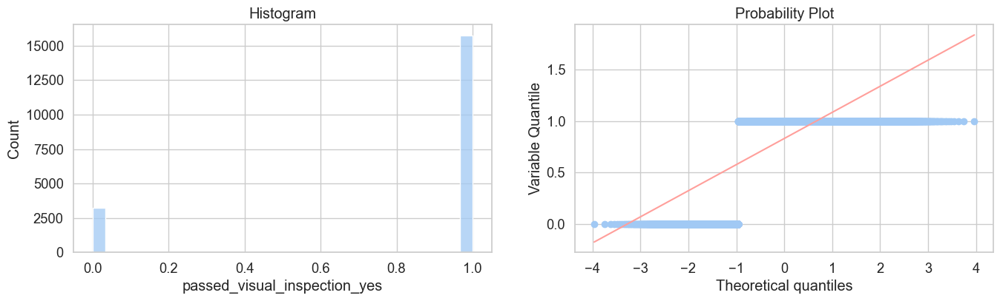

In [41]:
for col in train_X.columns:
    diagnostic_plots_2(train_X, col)

Select only variables with the float data type for discretization

In [42]:
float_vars = train_X.select_dtypes(include=['float'])
float_var_names = float_vars.columns.tolist()

In [43]:
len(float_var_names)

23

### 5.7 DecisionTreeDiscretiser

In [44]:
# Discretizator
treeDisc = DecisionTreeDiscretiser(
    cv = 10,
    scoring = 'accuracy',
    variables = float_var_names,
    regression = False,
    param_grid = {
        'max_depth': [2, 3, 4],
        'min_samples_leaf': [3, 4, 5]
    }
)
treeDisc.fit(train_X, y_train)

DecisionTreeDiscretiser(cv=10,
                        param_grid={'max_depth': [2, 3, 4],
                                    'min_samples_leaf': [3, 4, 5]},
                        regression=False, scoring='accuracy',
                        variables=['X1_ActualAcceleration',
                                   'X1_CommandVelocity',
                                   'X1_CommandAcceleration',
                                   'X1_CurrentFeedback', 'X1_DCBusVoltage',
                                   'X1_OutputVoltage', 'Y1_ActualPosition',
                                   'Y1_ActualVelocity', 'Y1_ActualAcceleration',
                                   'Y1_CommandAcceleration',
                                   'Y1_CurrentFeedback', 'Y1_DCBusVoltage',
                                   'Y1_OutputCurrent', 'Y1_OutputVoltage',
                                   'Z1_ActualVelocity', 'Z1_ActualAcceleration',
                                   'S1_ActualAcceleration',
                                   'S1_CommandPosition',
                                   'S1_CommandAcceleration', 'S1_OutputVoltage',
                                   'M1_CURRENT_PROGRAM_NUMBER',
                                   'M1_sequence_number', 'clamp_pressure'])

In [45]:
treeDisc.scores_dict_[float_var_names[0]]

0.5725585319552837

In [46]:
train_t = treeDisc.fit_transform(train_X, y_train)
test_t = treeDisc.transform(test_X)

Build the graph of the Monotonicity of the relationship between variables X and Y (target)

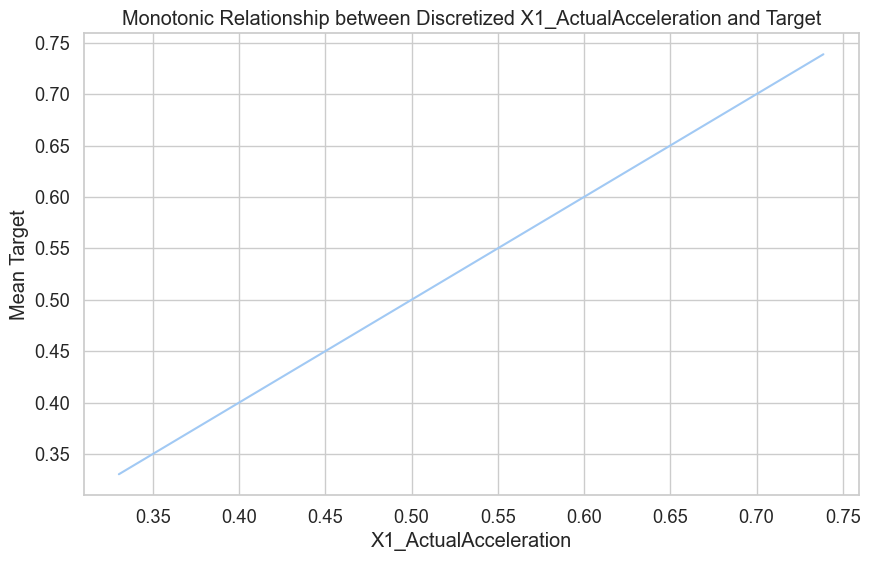

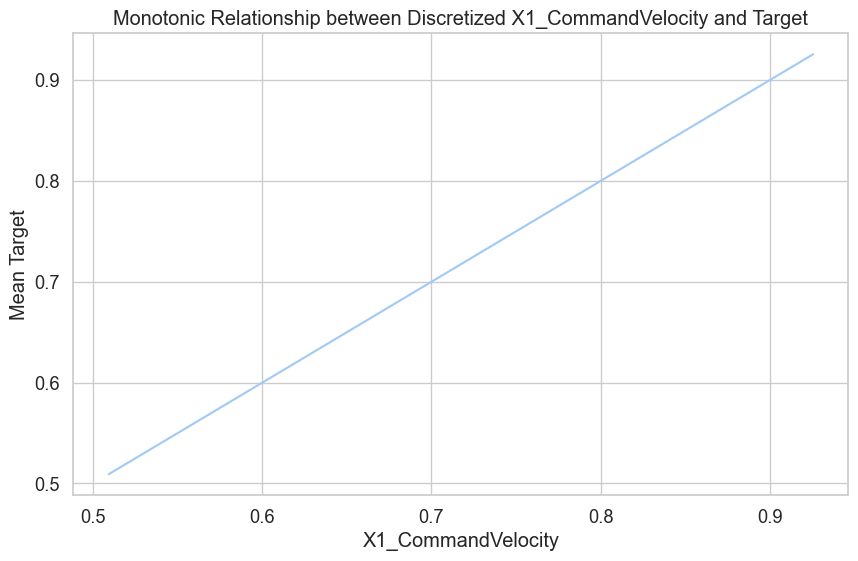

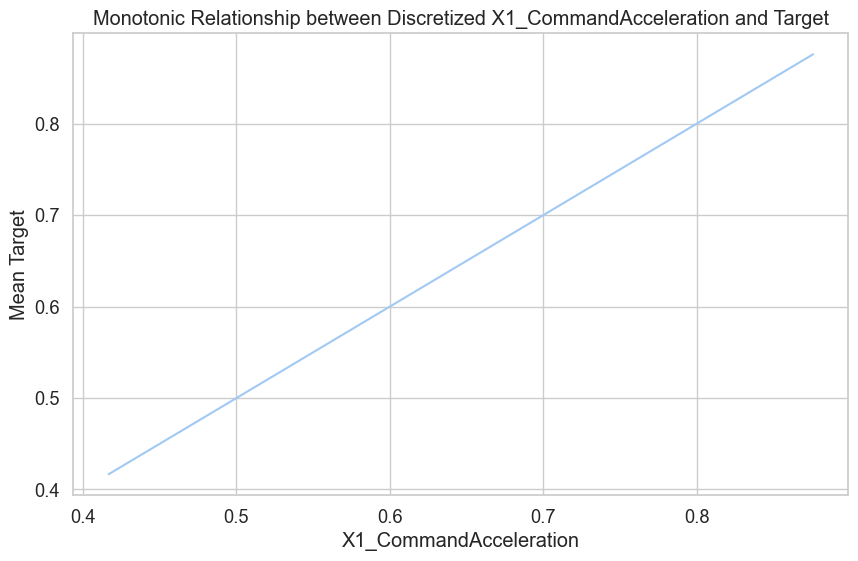

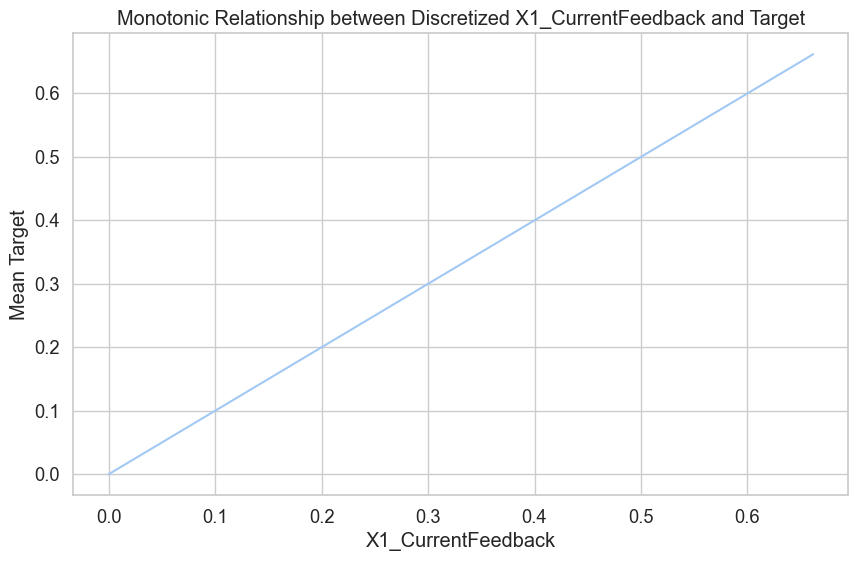

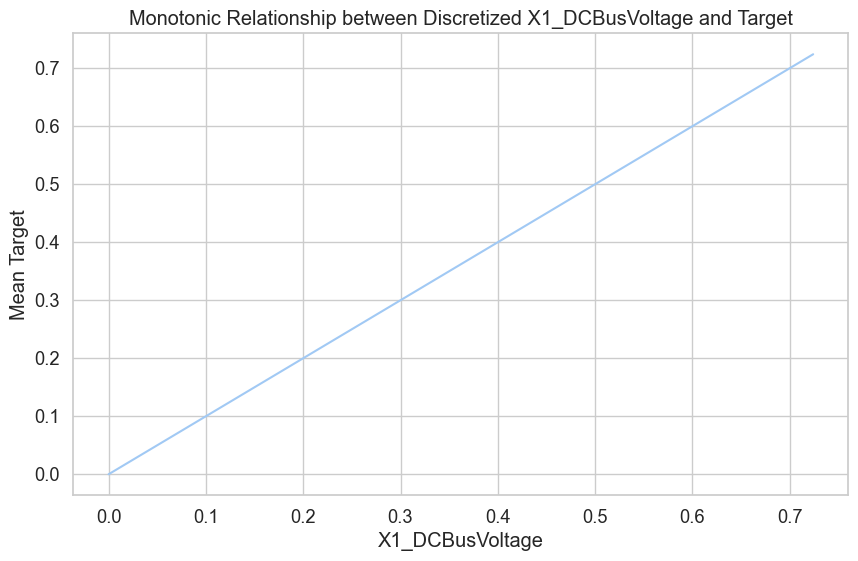

...

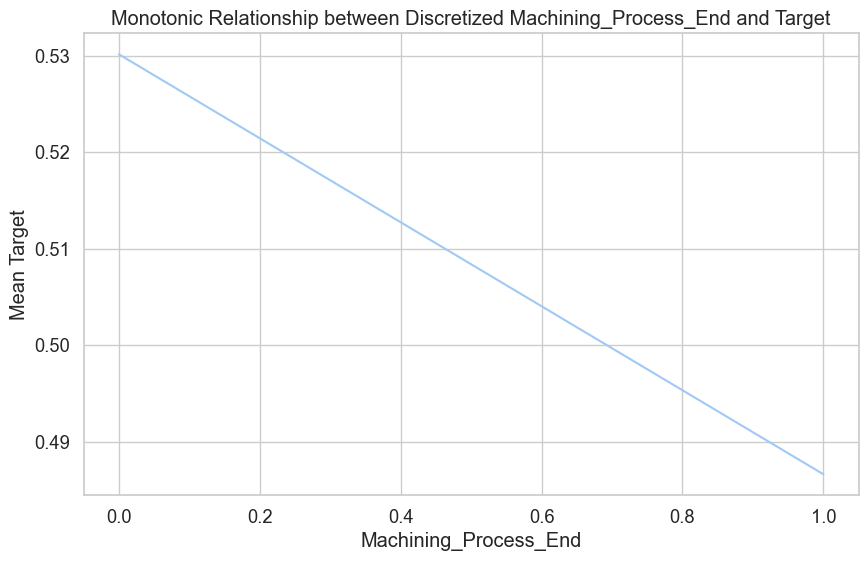

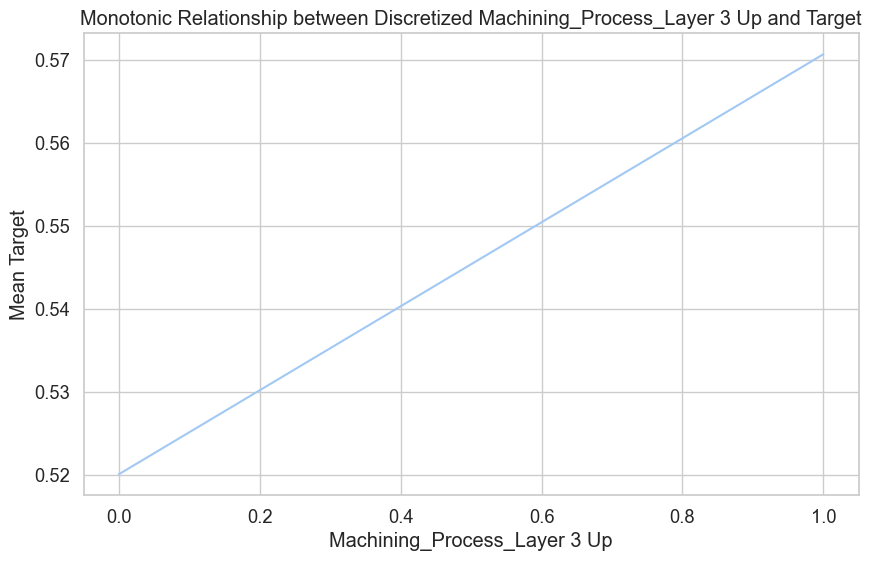

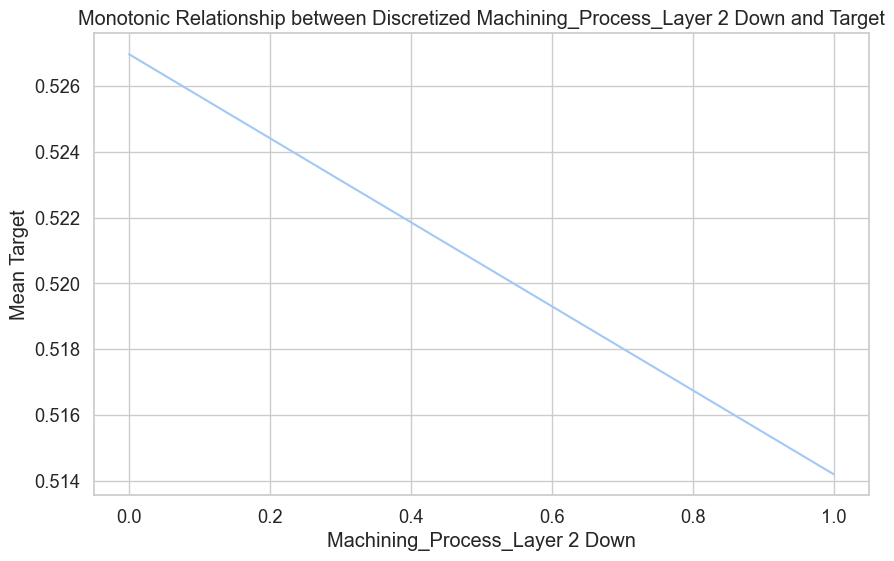

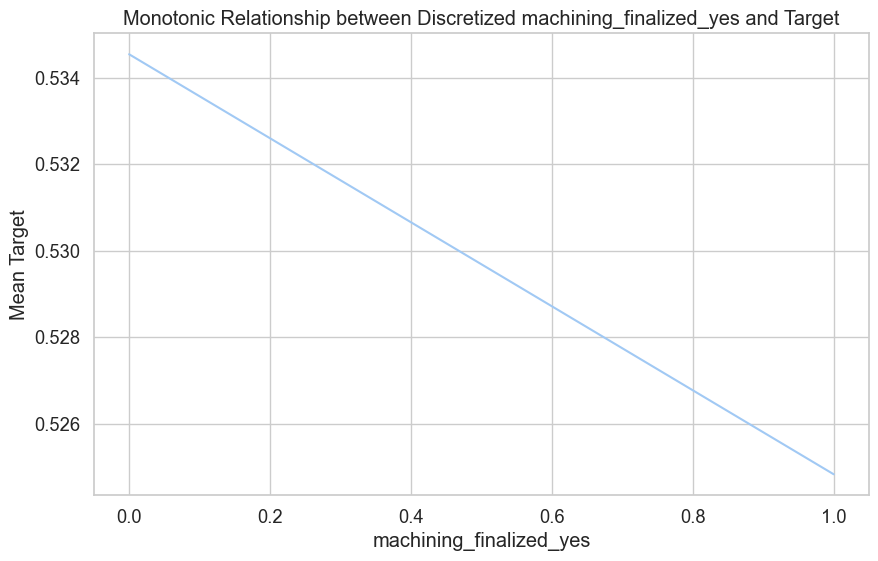

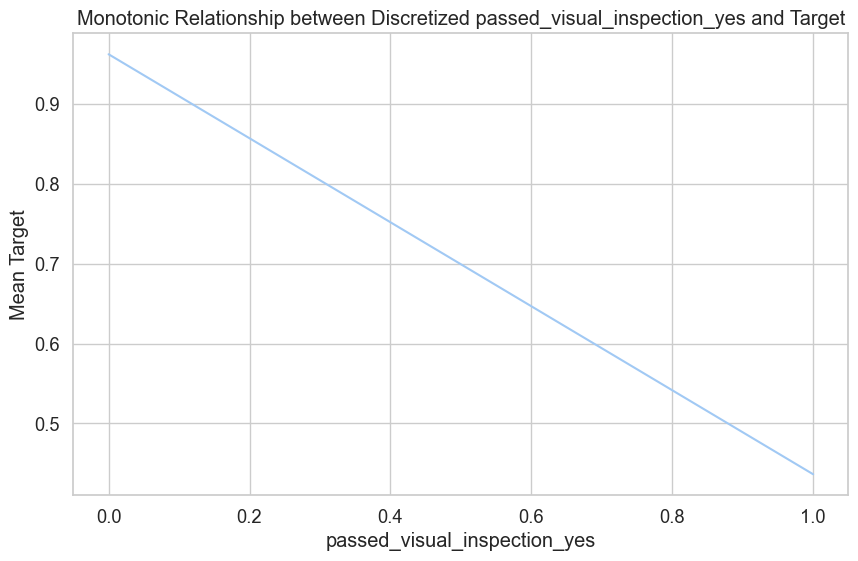

In [49]:
for col in train_t.columns:
    plt.figure(figsize=(10, 6))
    
    combined_data = pd.concat([train_t, y_train], axis=1)
    grouped_data = combined_data.groupby(col)['target'].mean()
    grouped_data.plot()
    
    plt.title(f'Monotonic Relationship between Discretized {col} and Target')
    plt.xlabel(col)
    plt.ylabel('Mean Target')
    plt.grid(True)
    
    plt.show()

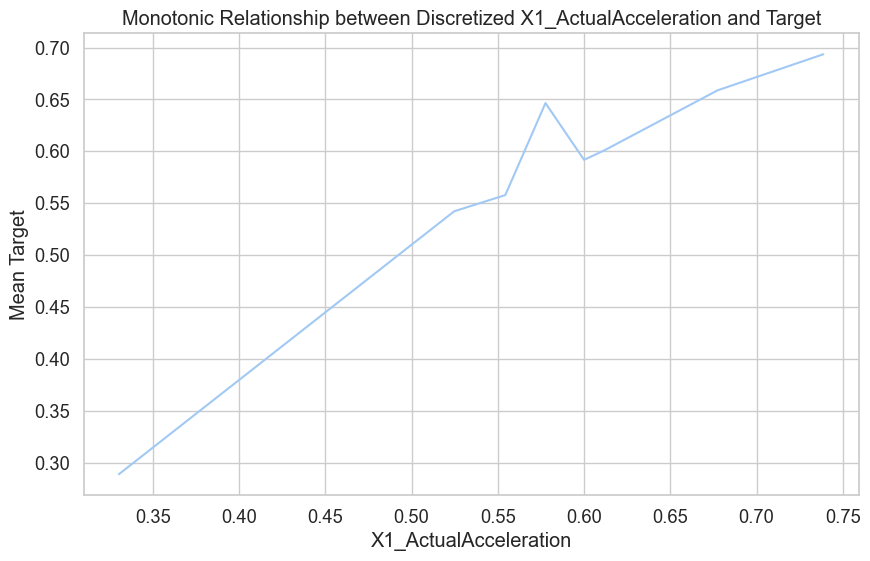

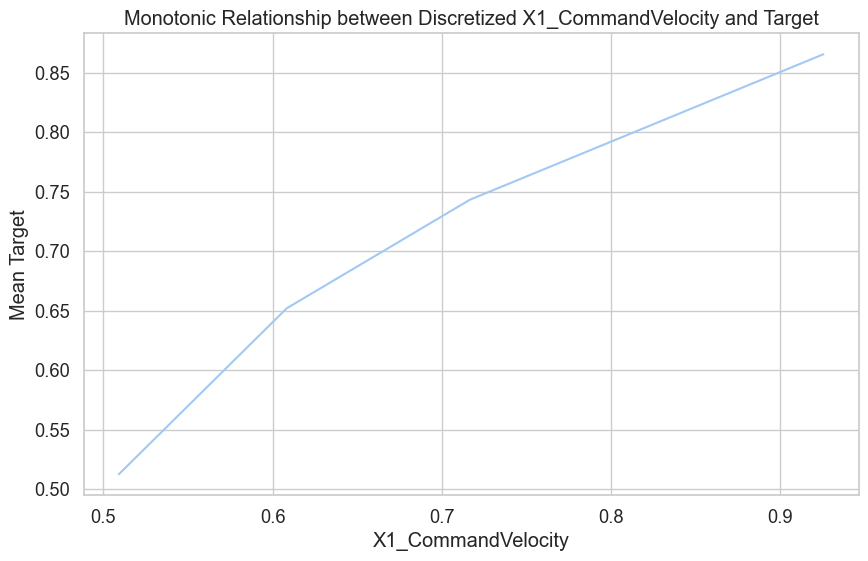

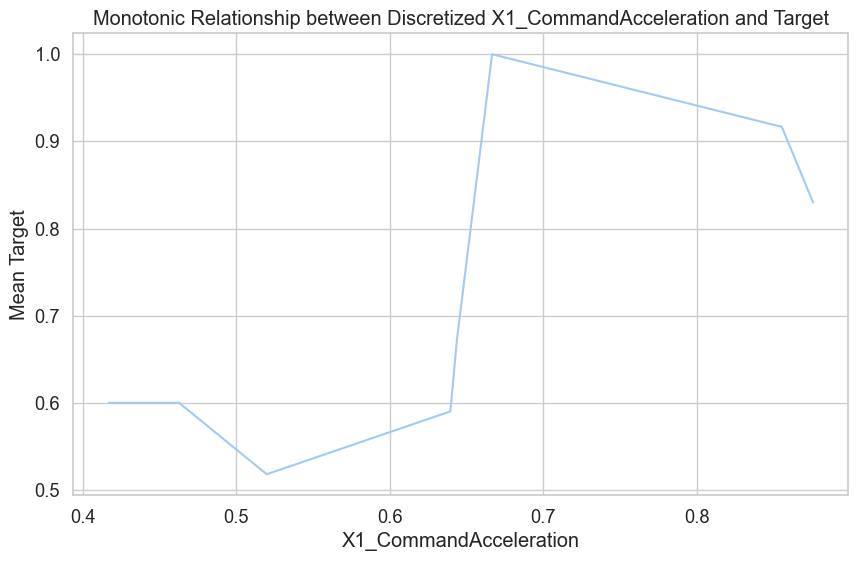

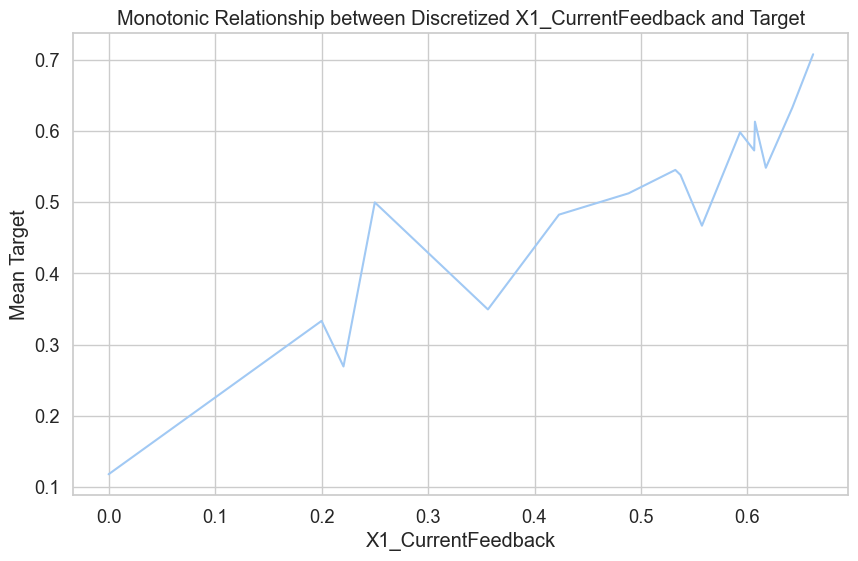

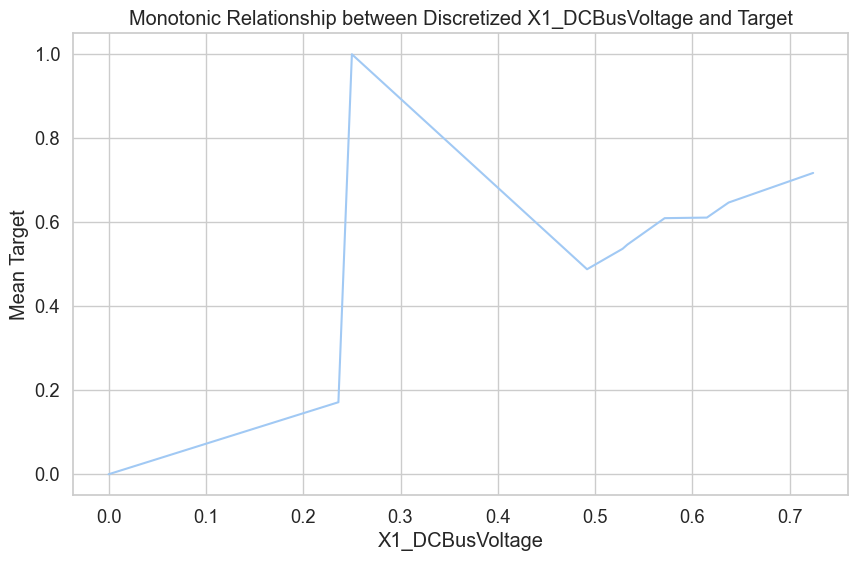

...

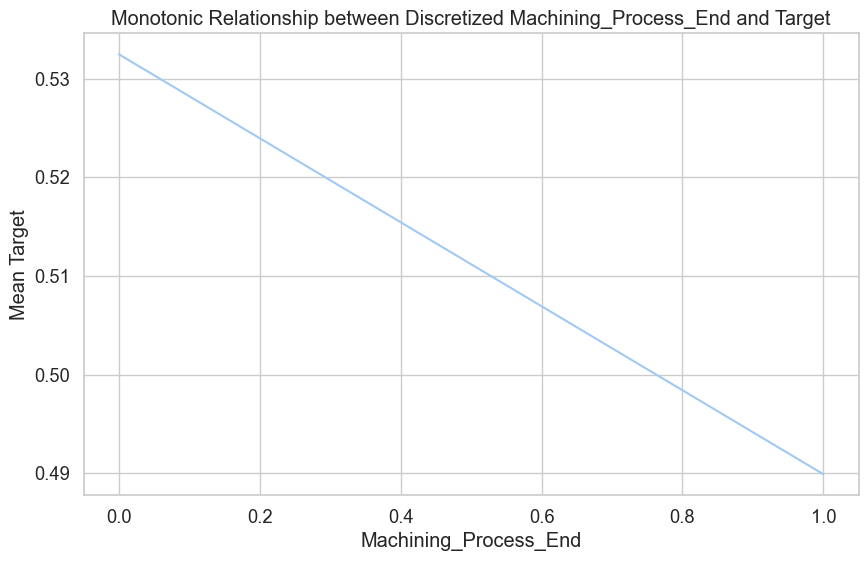

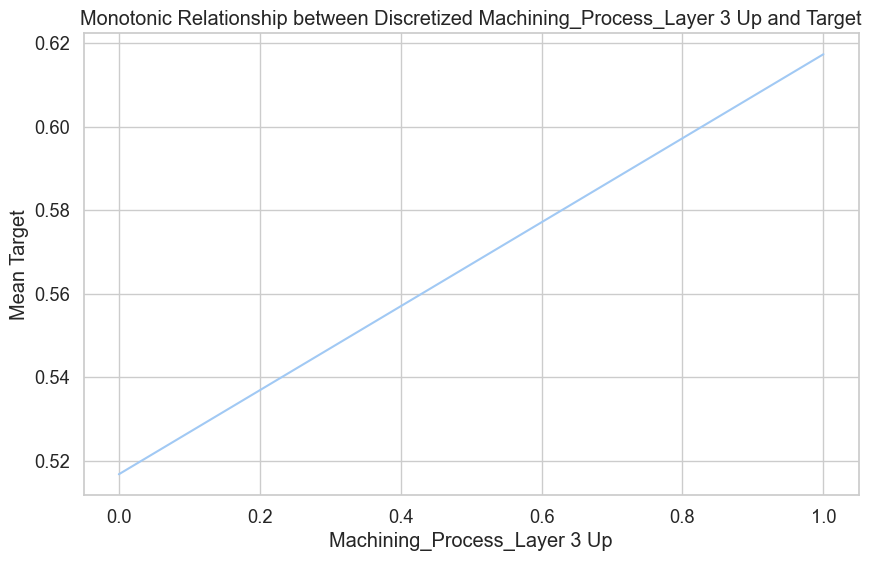

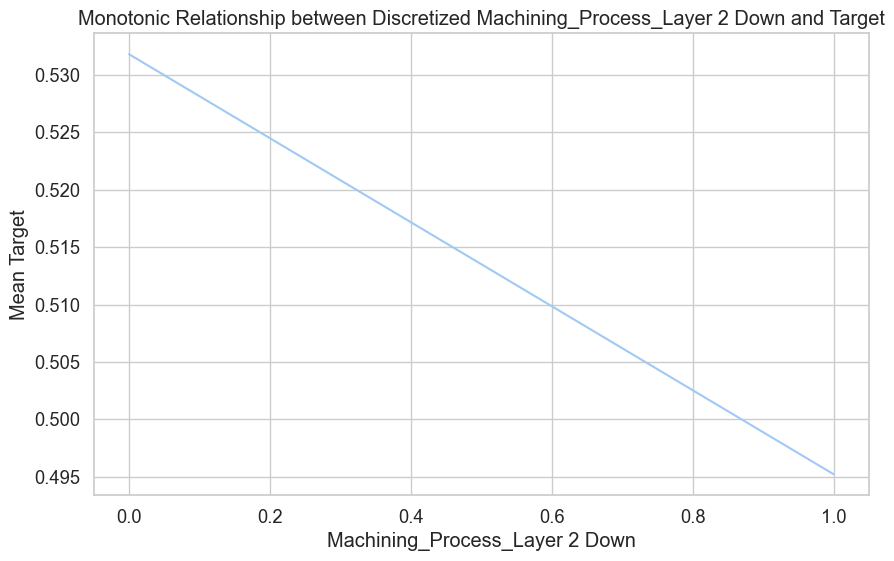

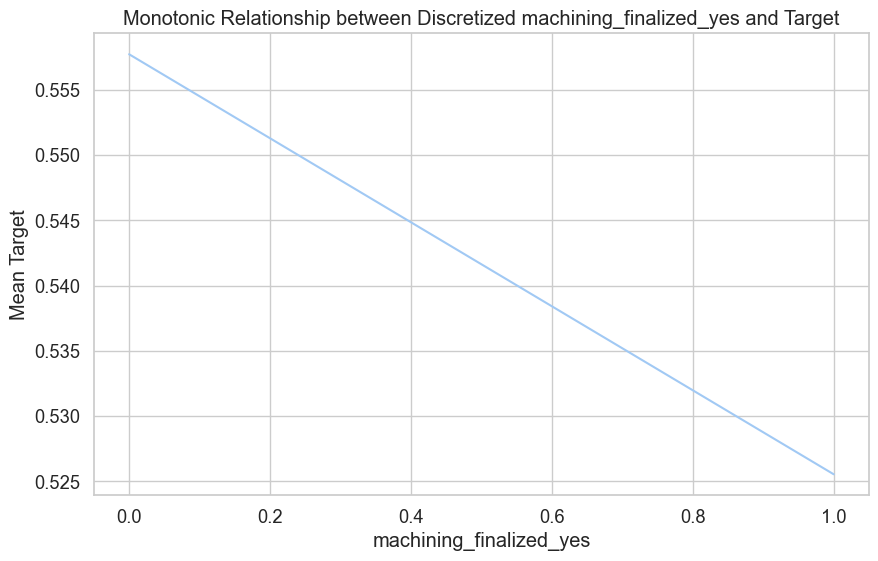

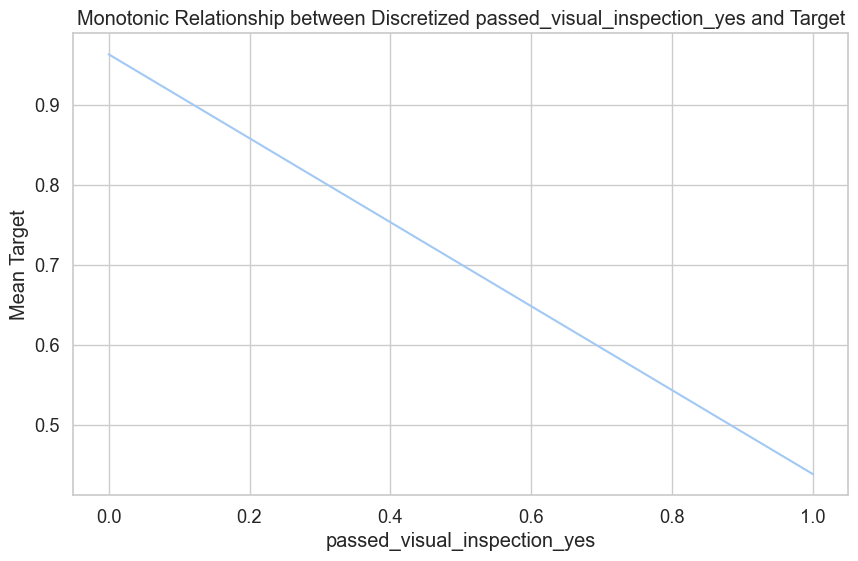

In [50]:
for col in test_t.columns:
    plt.figure(figsize=(10, 6))
    
    combined_data = pd.concat([test_t, y_test], axis=1)
    grouped_data = combined_data.groupby(col)['target'].mean()
    grouped_data.plot()
    
    plt.title(f'Monotonic Relationship between Discretized {col} and Target')
    plt.xlabel(col)
    plt.ylabel('Mean Target')
    plt.grid(True)
    
    plt.show()

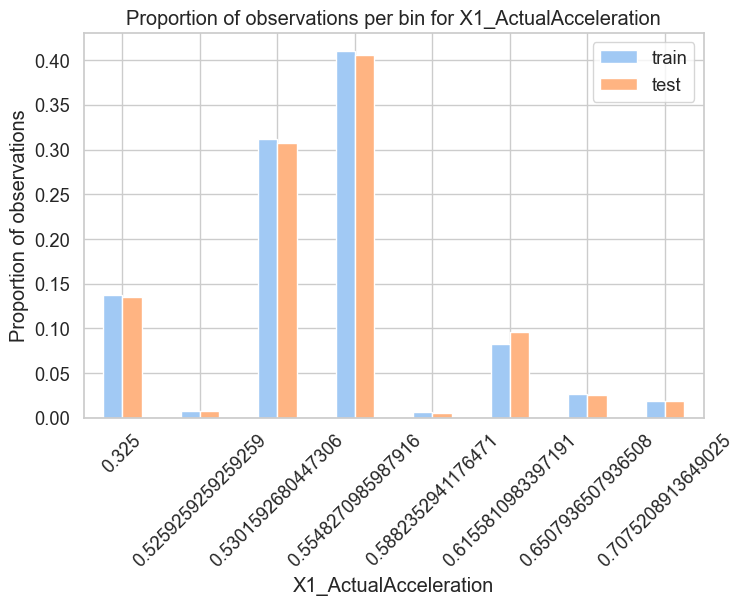

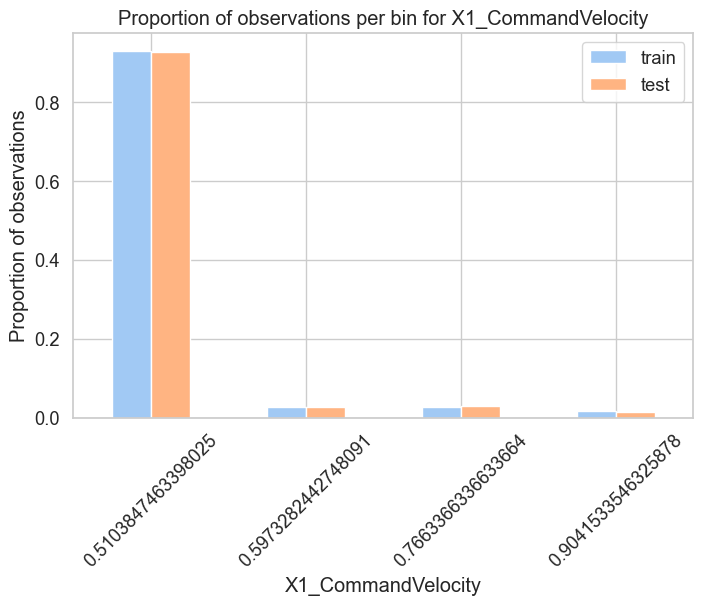

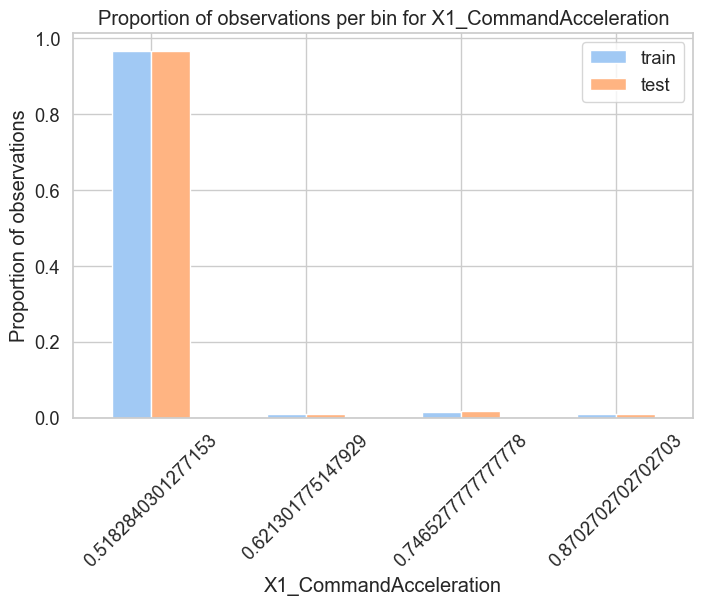

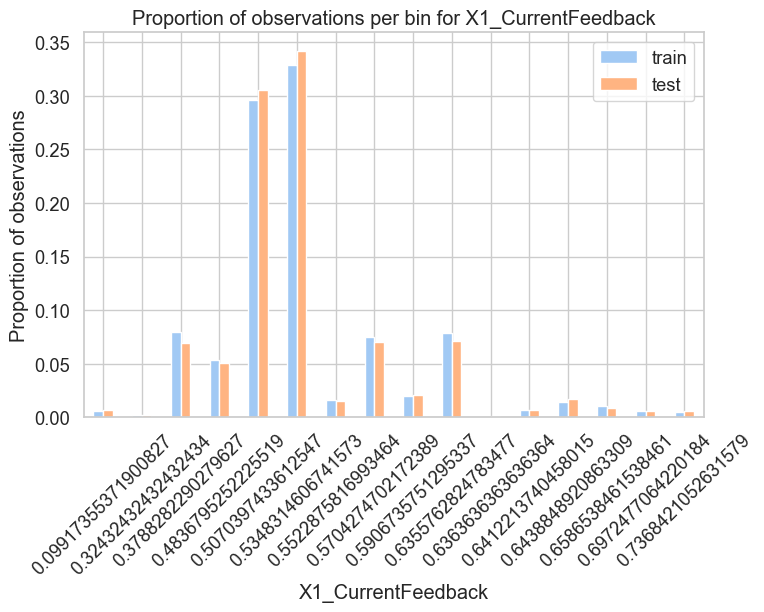

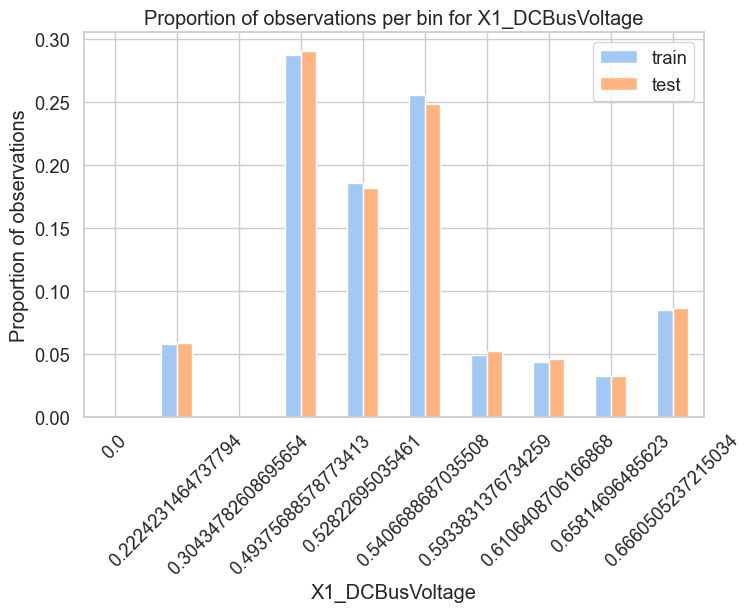

...

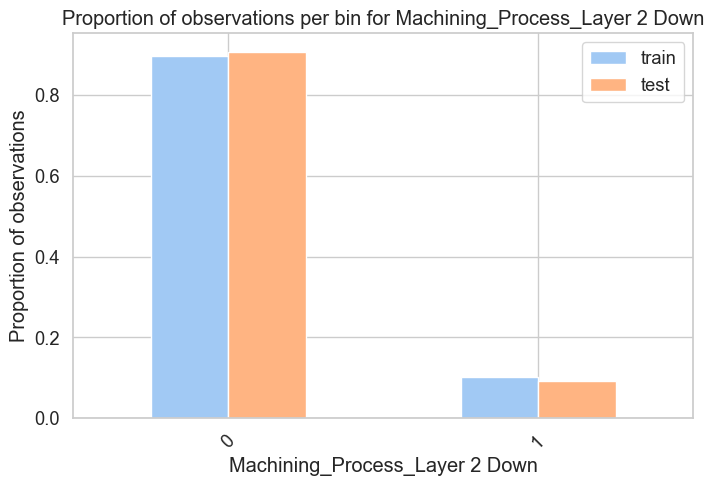

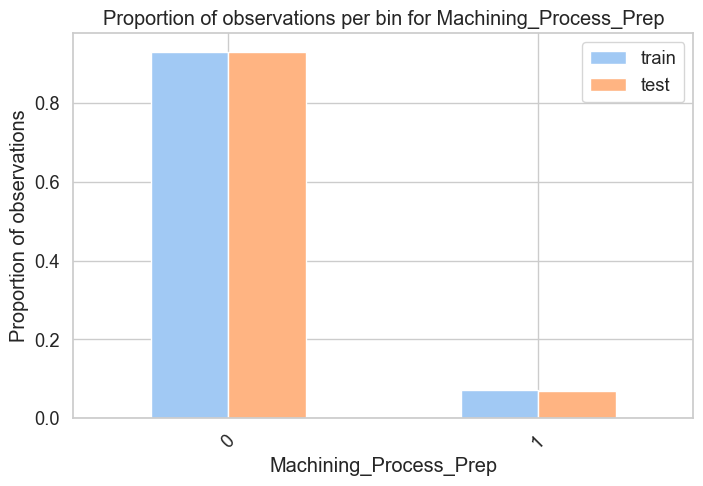

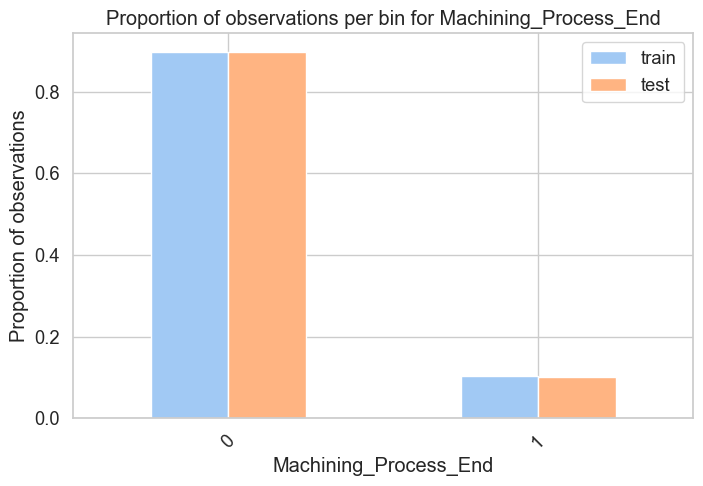

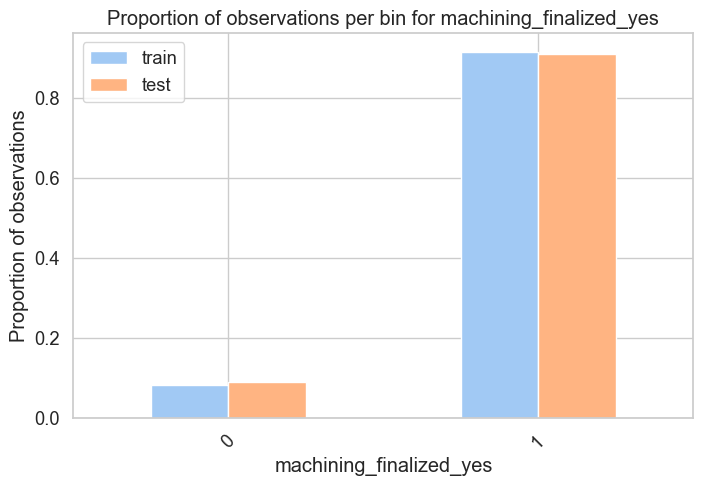

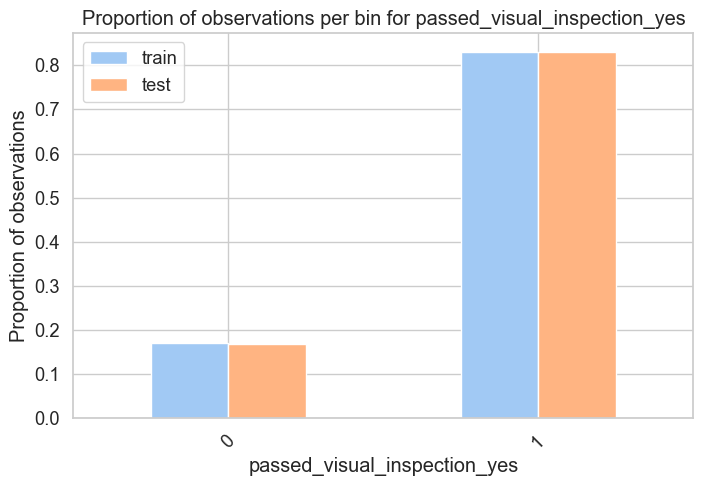

In [46]:
for col in train_t.columns:
    # take bins for each variables by train and test sets
    t1 = train_t.groupby([col])[col].count() / len(train_t)
    t2 = test_t.groupby([col])[col].count() / len(test_t)
    
    # create dataframe for (tmp) var
    tmp = pd.concat([t1, t2], axis=1)
    tmp.columns = ['train', 'test']
    
    # build graph
    tmp.plot(kind='bar', figsize=(8, 5))
    plt.xticks(rotation=45)
    plt.ylabel('Proportion of observations')
    plt.title(f'Proportion of observations per bin for {col}')
    plt.show()


<Figure size 640x480 with 0 Axes>

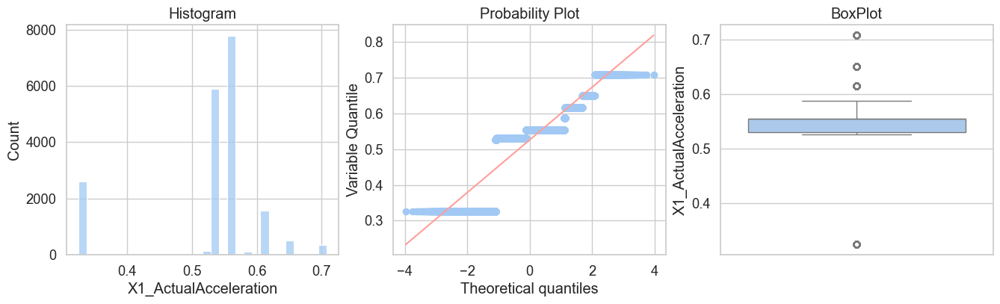

<Figure size 640x480 with 0 Axes>

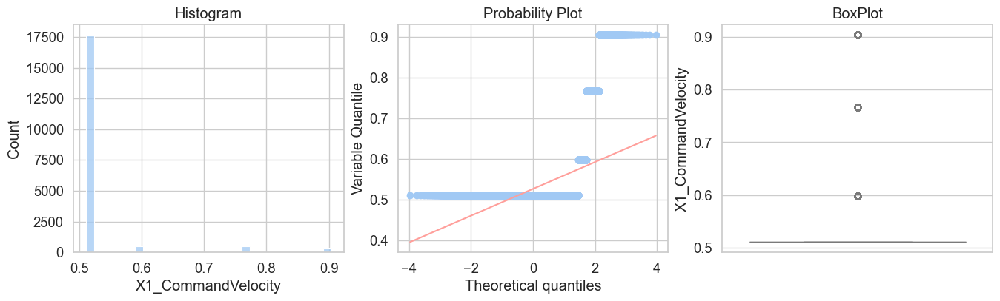

<Figure size 640x480 with 0 Axes>

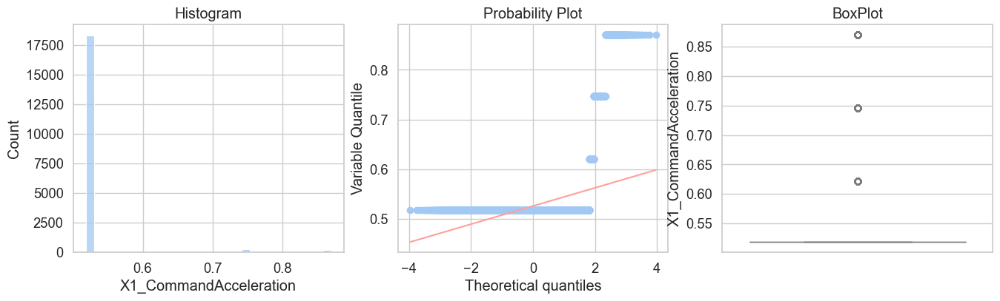

<Figure size 640x480 with 0 Axes>

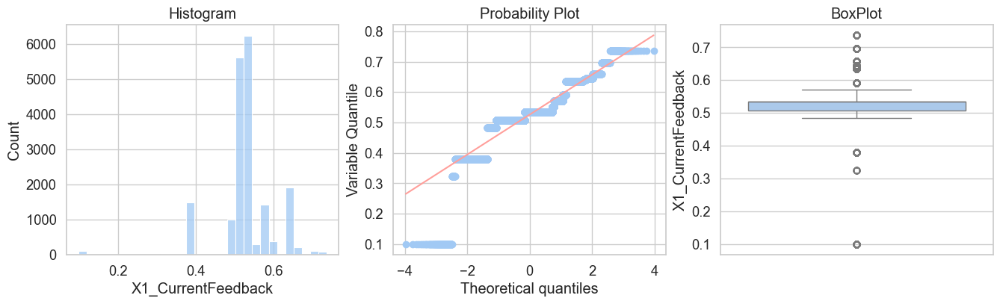

<Figure size 640x480 with 0 Axes>

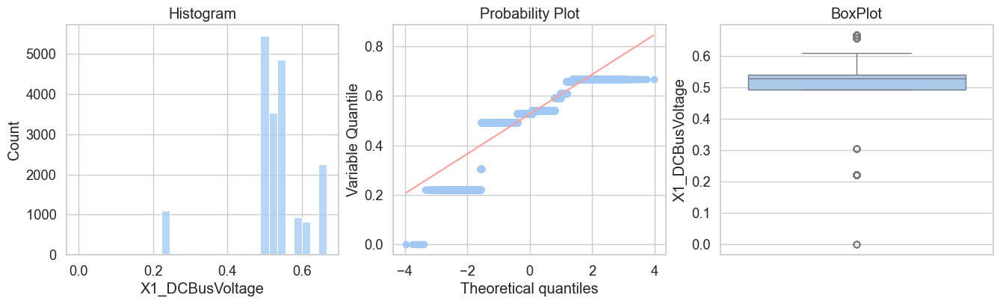

<Figure size 640x480 with 0 Axes>

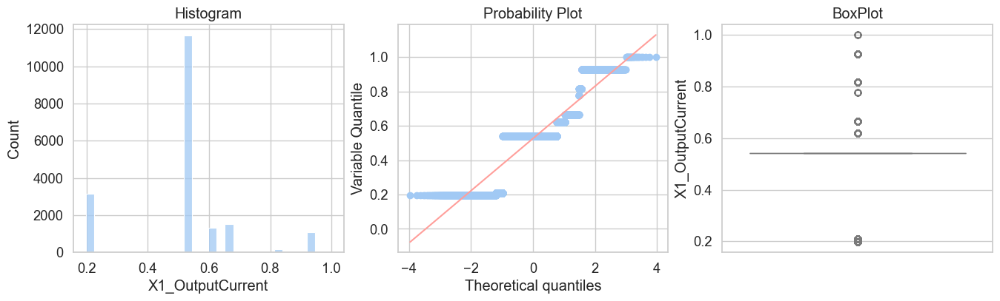

<Figure size 640x480 with 0 Axes>

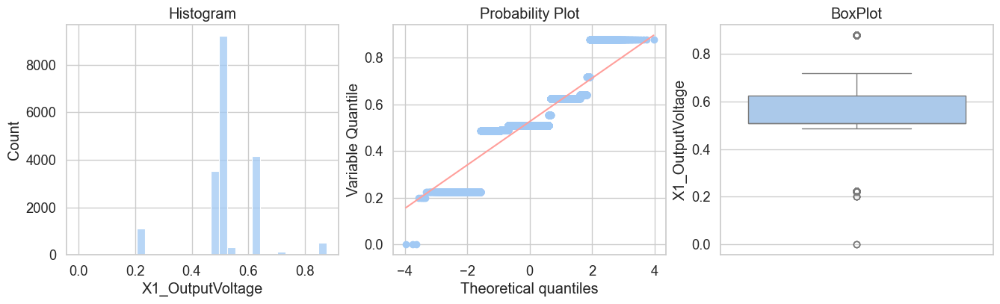

<Figure size 640x480 with 0 Axes>

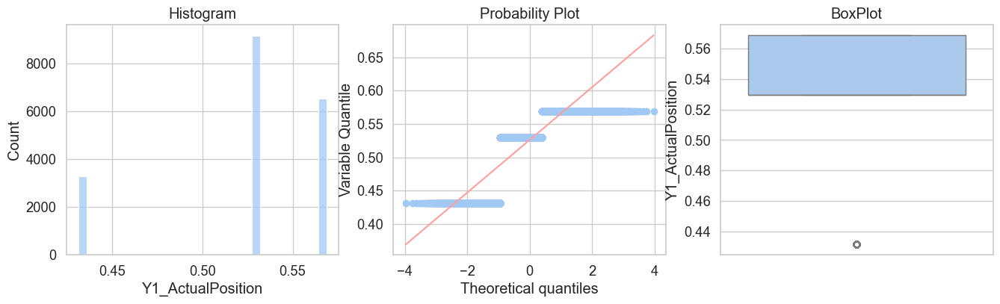

<Figure size 640x480 with 0 Axes>

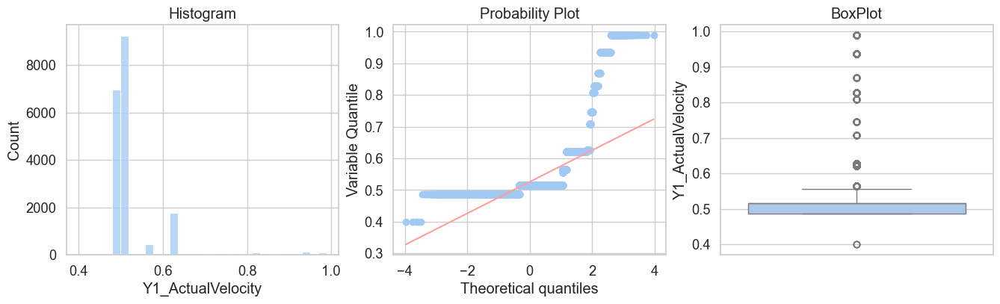

<Figure size 640x480 with 0 Axes>

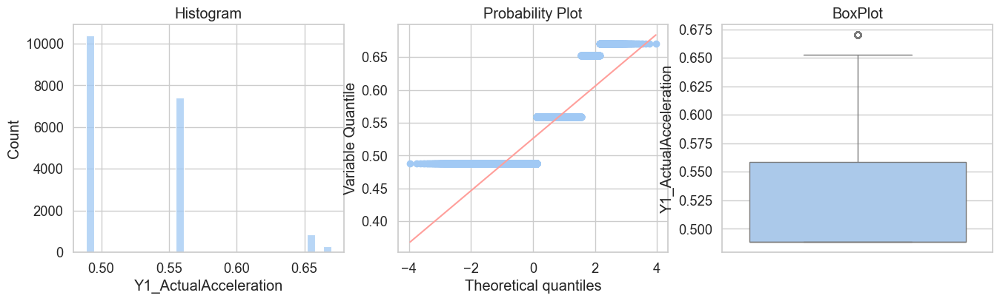

<Figure size 640x480 with 0 Axes>

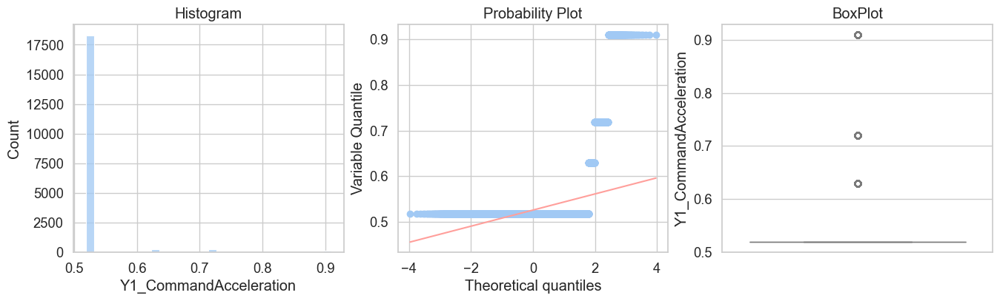

<Figure size 640x480 with 0 Axes>

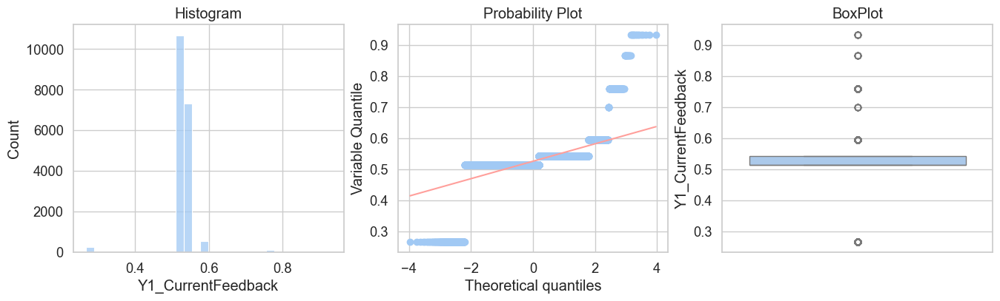

<Figure size 640x480 with 0 Axes>

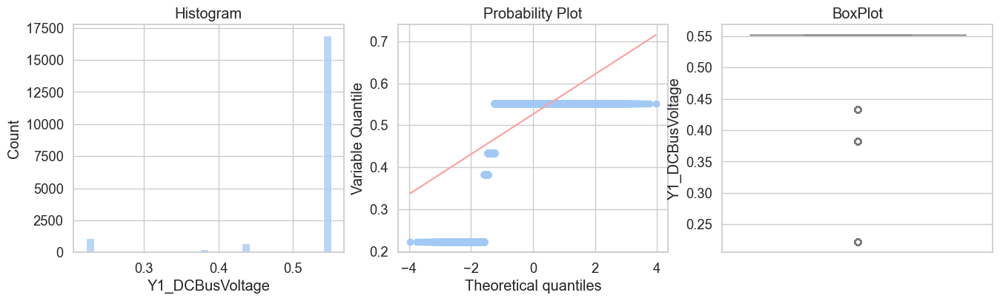

<Figure size 640x480 with 0 Axes>

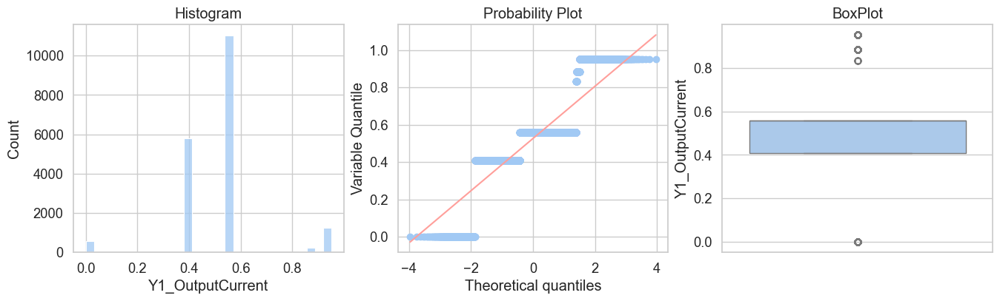

<Figure size 640x480 with 0 Axes>

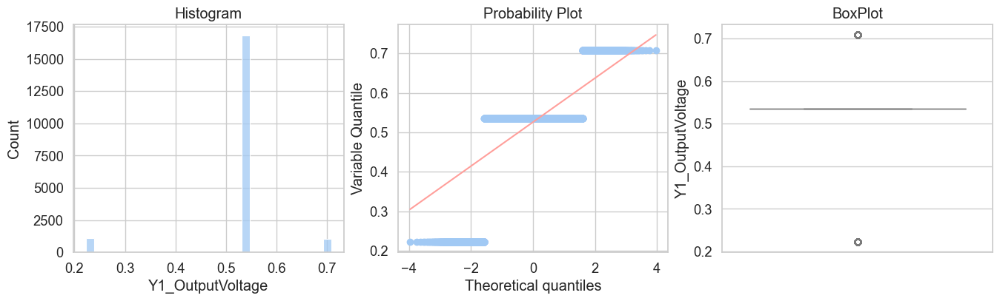

<Figure size 640x480 with 0 Axes>

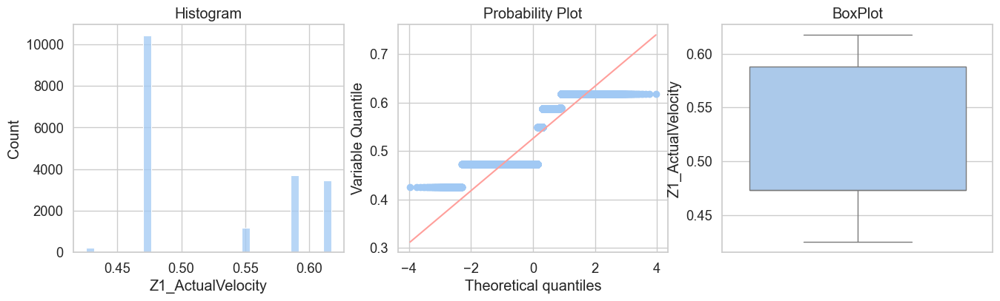

<Figure size 640x480 with 0 Axes>

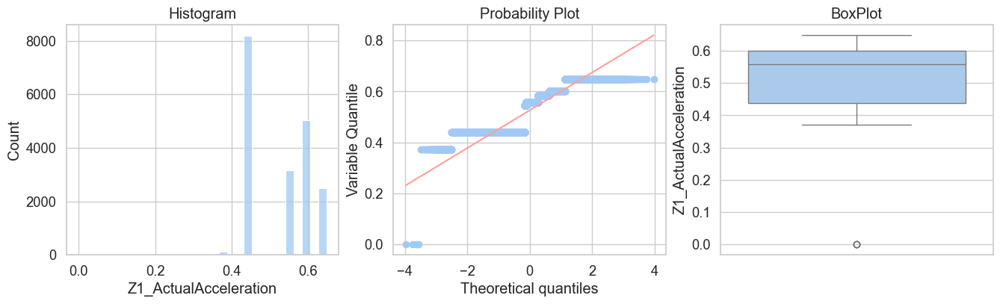

<Figure size 640x480 with 0 Axes>

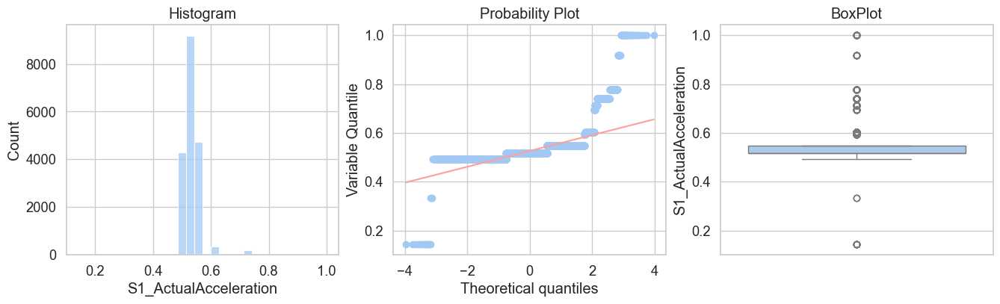

<Figure size 640x480 with 0 Axes>

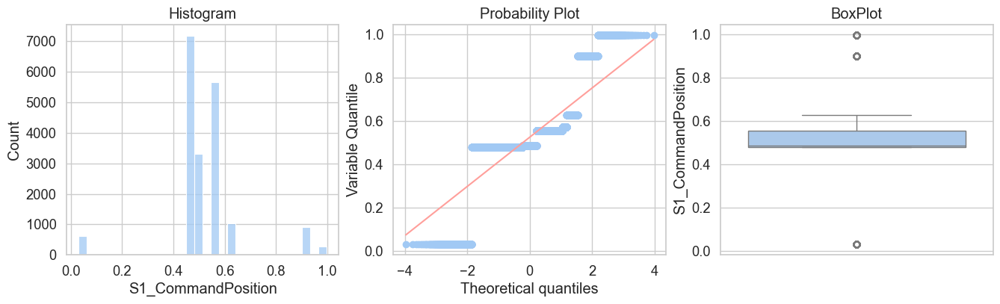

<Figure size 640x480 with 0 Axes>

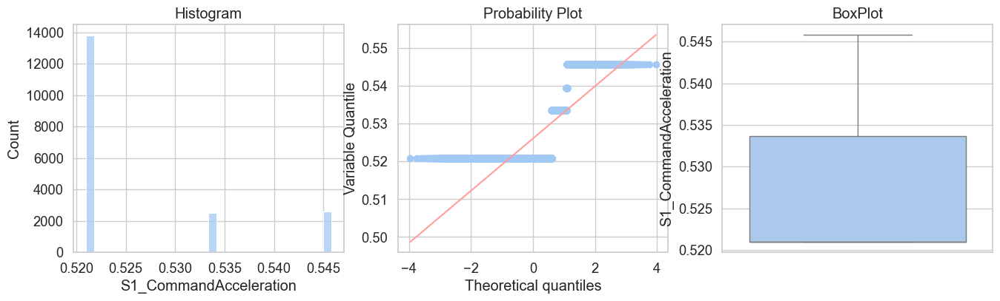

<Figure size 640x480 with 0 Axes>

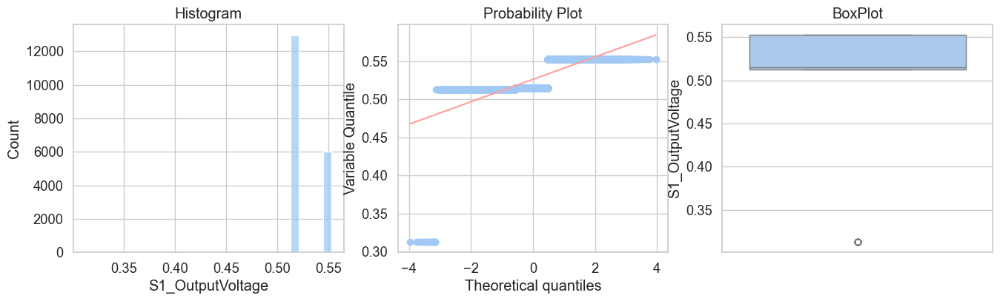

<Figure size 640x480 with 0 Axes>

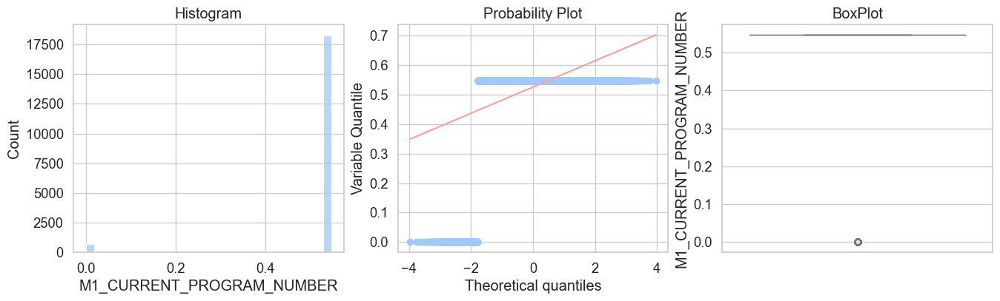

<Figure size 640x480 with 0 Axes>

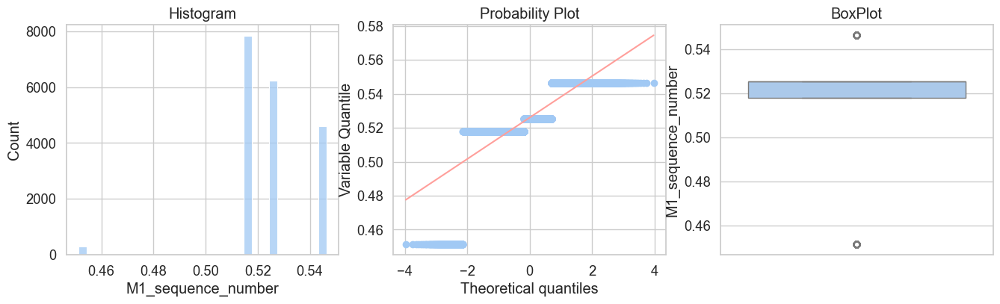

<Figure size 640x480 with 0 Axes>

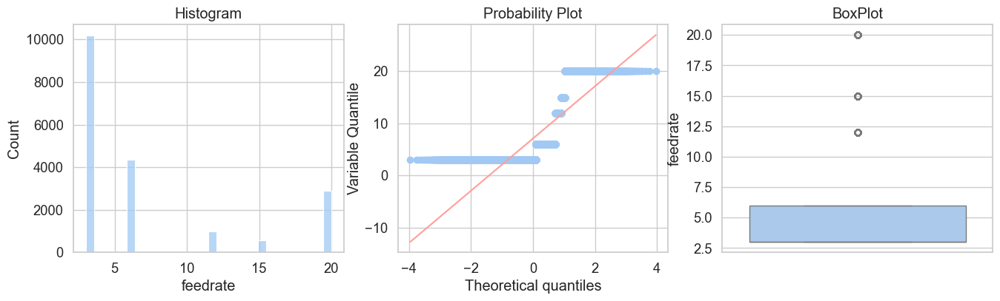

<Figure size 640x480 with 0 Axes>

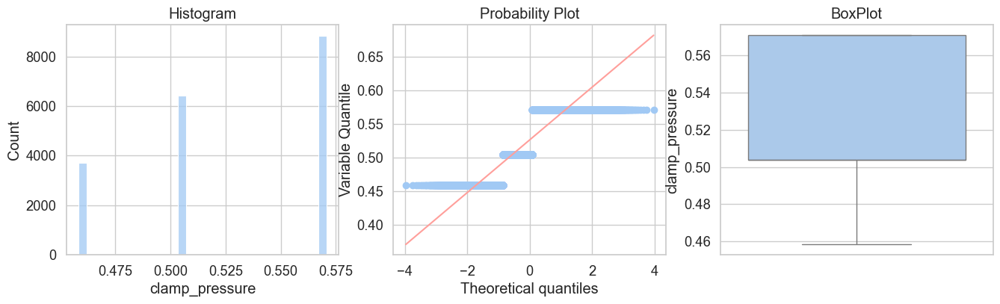

<Figure size 640x480 with 0 Axes>

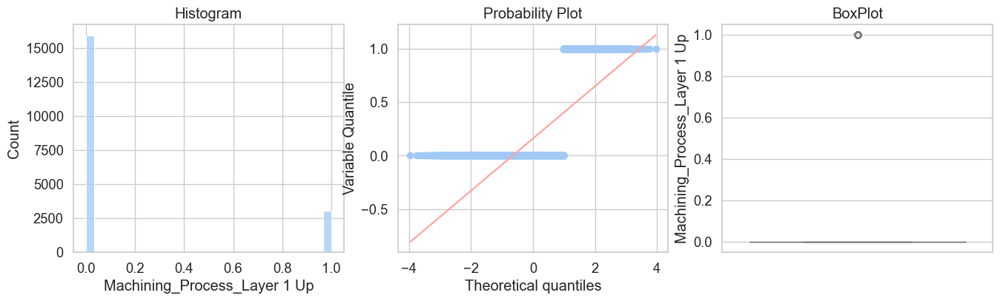

<Figure size 640x480 with 0 Axes>

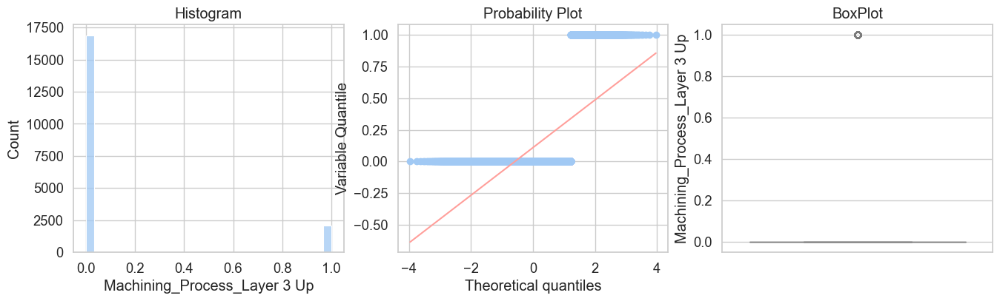

<Figure size 640x480 with 0 Axes>

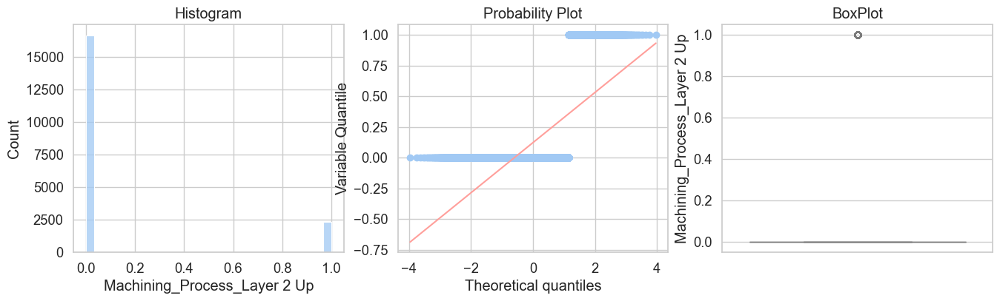

<Figure size 640x480 with 0 Axes>

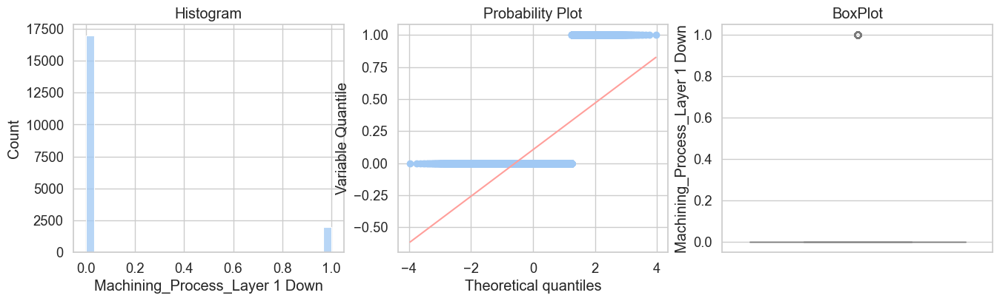

<Figure size 640x480 with 0 Axes>

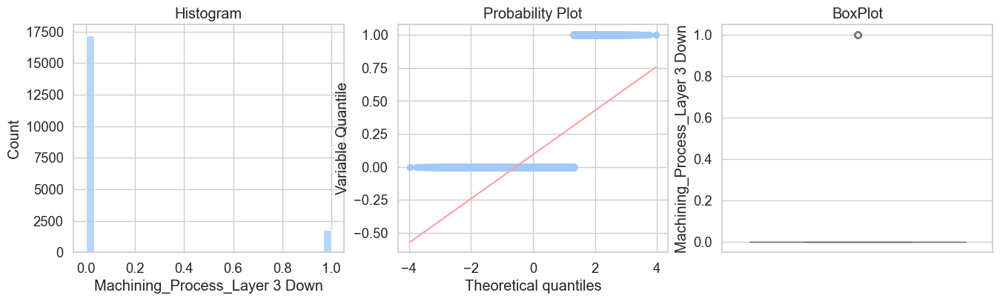

<Figure size 640x480 with 0 Axes>

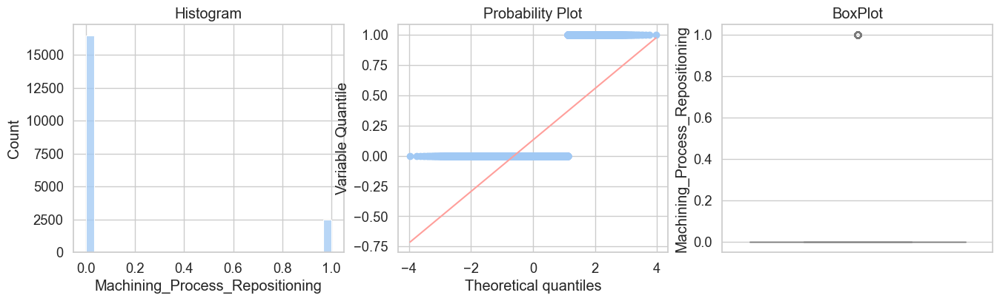

<Figure size 640x480 with 0 Axes>

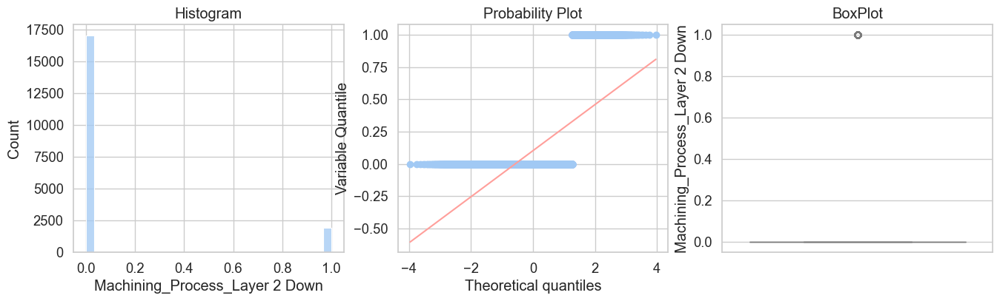

<Figure size 640x480 with 0 Axes>

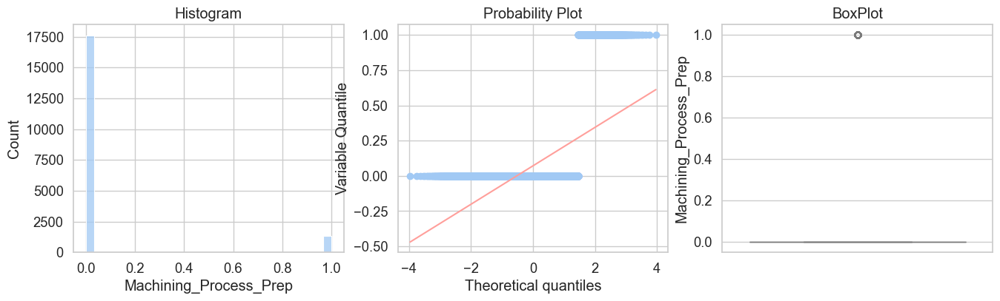

<Figure size 640x480 with 0 Axes>

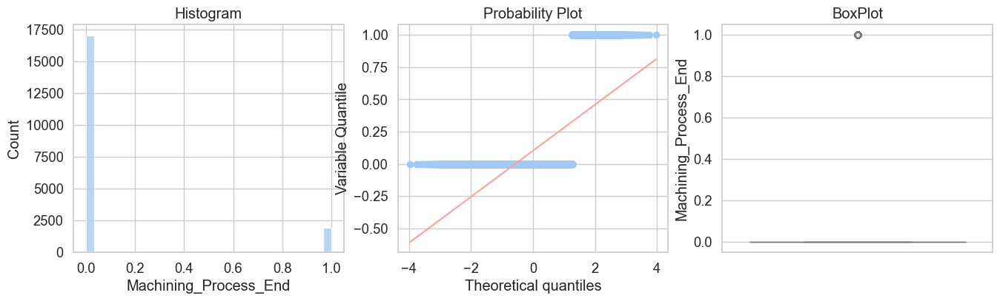

<Figure size 640x480 with 0 Axes>

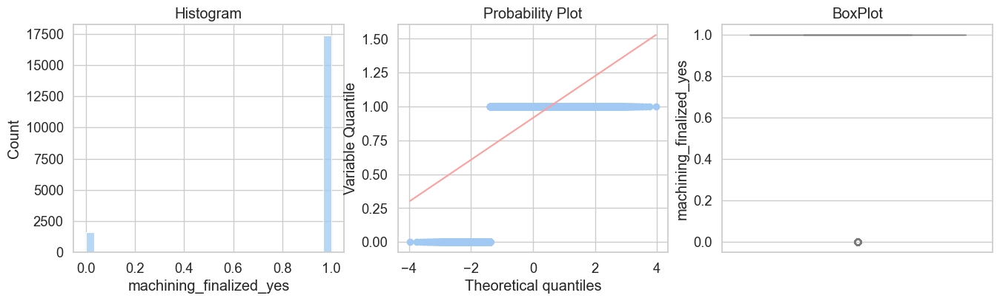

<Figure size 640x480 with 0 Axes>

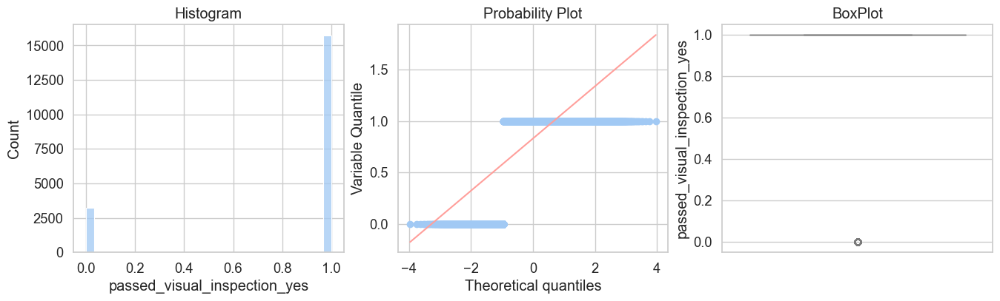

In [47]:
for col in train_t.columns:
    diagnostic_plots(train_t, col)

## 6. Training algorithms with default parameters

In [48]:
classifiers = {
    'KNeighbor': KNeighborsClassifier(),
    'RandomForest': RandomForestClassifier(),
    'SVC': SVC(),
    'Decision Tree': DecisionTreeClassifier(),
    'AdaBoost': AdaBoostClassifier(),
    'BaggingClf': BaggingClassifier(),
    'ExtraTreeClf': ExtraTreesClassifier(),
    'XGBoost': XGBClassifier(),
    'GaussianNB': GaussianNB(),
    'SGDC': SGDClassifier(),
}

In [49]:
results = {}  # Dictionary for save results

for name, clf in classifiers.items():
    clf.fit(train_X, y_train)
    score = clf.score(test_X, y_test)
    results[name] = score

sorted_results = dict(sorted(results.items(), key=lambda item: item[1], reverse=True))

print("\nResults:")
for name, score in sorted_results.items():
    print(f"{name}: {score:.2f}")

/Users/shabdantaalaibekov/miniforge3/envs/KV-AI-JLM-7/lib/python3.9/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(



Results:
ExtraTreeClf: 0.97
XGBoost: 0.96
RandomForest: 0.95
BaggingClf: 0.93
Decision Tree: 0.90
KNeighbor: 0.75
AdaBoost: 0.72
GaussianNB: 0.61
SGDC: 0.58
SVC: 0.58


###### Function for evaluate model performance with classification metrics

## 7. Build pipeline and function for performance metrics

In [50]:
# Function for evaluate performance metrics
def evaluate_performance(model, X_train, y_train, X_test, y_test):
    
    # train model
    model.fit(X_train, y_train)
    
    # predict label
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    
    # evaluate metrics performance
    roc_auc_train = roc_auc_score(y_train, y_pred_train)
    roc_auc_test = roc_auc_score(y_test, y_pred_test)
    
    accuracy_train = accuracy_score(y_train, y_pred_train)
    accuracy_test = accuracy_score(y_test, y_pred_test)
    
    recall_train = recall_score(y_train, y_pred_train)
    recall_test = recall_score(y_test, y_pred_test)
    
    f1_train = f1_score(y_train, y_pred_train)
    f1_test = f1_score(y_test, y_pred_test)
    
    precision_train = precision_score(y_train, y_pred_train)
    precision_test = precision_score(y_test, y_pred_test)
    
    # Output metrics
    print("ROC AUC Train:", roc_auc_train)
    print("ROC AUC Test:", roc_auc_test)
    print()
    print("Accuracy Train:", accuracy_train)
    print("Accuracy Test:", accuracy_test)
    print()
    print("Recall Train:", recall_train)
    print("Recall Test:", recall_test)
    print()
    print("F1 Score Train:", f1_train)
    print("F1 Score Test:", f1_test)
    print()
    print("Precision Train:", precision_train)
    print("Precision Test:", precision_test)
    print()
    
    # evaluate mean metrics with cross_val_score
    roc_auc_cv_scores = cross_val_score(model, X_train, y_train, cv=10, scoring='roc_auc')
    accuracy_cv_scores = cross_val_score(model, X_train, y_train, cv=10, scoring='accuracy')
    
    roc_auc_cv_mean = roc_auc_cv_scores.mean()
    accuracy_cv_mean = accuracy_cv_scores.mean()
    
    # evaluate Standard Deviation
    roc_auc_cv_std = roc_auc_cv_scores.std()
    accuracy_cv_std = accuracy_cv_scores.std()
    
    # Output mean metrics and standard deviation
    print("ROC AUC (cross-validation): Mean =", roc_auc_cv_mean) 
    print("Accuracy (cross-validation): Mean =", accuracy_cv_mean)
    print()
    print("ROC AUC Std =", roc_auc_cv_std)
    print("Accuracy Std =", accuracy_cv_std)
    print()

    # Confusion Matrix
    print("Confusion Matrix for Train:")
    print(confusion_matrix(y_train, y_pred_train))
    print()
    print("Confusion Matrix for Test:")
    print(confusion_matrix(y_test, y_pred_test))
    print()

###### Function to build main preprocessor pipeline

In [51]:
def build_pipeline(classifier):
    pipeline = Pipeline(steps = [
        ('imputer', RandomSampleImputer()),
        ('encoder', OneHotEncoder()),
        ('constant', DropConstantFeatures(tol = 0.97)),
        ('duplicated', DropDuplicateFeatures()),
        ('correlated', SmartCorrelatedSelection(selection_method = 'variance')),
        ('scaler', StandardScaler()),
        ('winsorizer', Winsorizer(capping_method = 'gaussian', tail = 'both', fold = 1.5)),
        ('clf', classifier)
    ])
    return pipeline

###### Function for fine-tuning model

In [52]:
def tune_model(X_train, y_train, classifier, param_grid, cv = 10):
    
    pipeline = build_pipeline(classifier)
    grid_search = GridSearchCV(pipeline, param_grid, cv = cv, n_jobs = -1, scoring = 'accuracy')
    grid_search.fit(X_train, y_train)
    best_model = grid_search.best_estimator_
    best_model.fit(X_train, y_train)
    
    return best_model

###### Function for get best model

In [53]:
def get_best_model(X_train, y_train, classifier, param_grid, cv=10):
    return tune_model(X_train, y_train, classifier, param_grid, cv)

## 7.1 Training Models

### Random Forest Classifier

In [54]:
classifier_RF = RandomForestClassifier()

param_RF = {
    'constant__tol': [0.93, 0.96],
    'winsorizer__tail': ['left', 'right'],
    'clf__n_estimators': [50, 100, 150],
    'clf__criterion': ['gini', 'entropy'],
    'clf__min_samples_split': [2, 3],
    'clf__min_samples_leaf': [2, 3]
}
best_model_RF = get_best_model(X_train, y_train, classifier_RF, param_RF)

In [55]:
evaluate_performance(best_model_RF, X_train, y_train, X_test, y_test)

ROC AUC Train: 1.0
ROC AUC Test: 0.9498401639422421

Accuracy Train: 1.0
Accuracy Test: 0.9498576399873457

Recall Train: 1.0
Recall Test: 0.9501651155809067

F1 Score Train: 1.0
F1 Score Test: 0.9523093124717917

Precision Train: 1.0
Precision Test: 0.9544632086851629

ROC AUC (cross-validation): Mean = 0.9877437214335067
Accuracy (cross-validation): Mean = 0.944369329543205

ROC AUC Std = 0.0021585427960636385
Accuracy Std = 0.006054638451678496

Confusion Matrix for Train:
[[8987    0]
 [   0 9977]]

Confusion Matrix for Test:
[[2840  151]
 [ 166 3165]]



In [56]:
# Save model
with open('best_model_RF', 'wb') as f:
    pickle.dump(best_model_RF, f)

### Decision Tree Classifier

In [63]:
classifier_DT = DecisionTreeClassifier()

param_DT = {
    'constant__tol': [0.93, 0.96],
    'winsorizer__tail': ['left', 'right'],
    'clf__criterion': ['gini', 'entropy', 'log_loss'],
    'clf__splitter': ['best', 'random'],
    'clf__min_samples_split': [2, 3]
}
best_model_DT = get_best_model(X_train, y_train, classifier_DT, param_DT)

In [64]:
evaluate_performance(best_model_DT, X_train, y_train, X_test, y_test)

ROC AUC Train: 0.9971379092353048
ROC AUC Test: 0.9231585479946293

Accuracy Train: 0.9969943049989454
Accuracy Test: 0.9231255931667194

Recall Train: 0.9943870903077078
Recall Test: 0.9225457820474332

F1 Score Train: 0.9971355344489673
F1 Score Test: 0.9267189384800965

Precision Train: 0.9998992138681717
Precision Test: 0.9309300212056952

ROC AUC (cross-validation): Mean = 0.9173421013794222
Accuracy (cross-validation): Mean = 0.9154188881400568

ROC AUC Std = 0.012098745771375383
Accuracy Std = 0.007210436641741705

Confusion Matrix for Train:
[[8986    1]
 [  56 9921]]

Confusion Matrix for Test:
[[2763  228]
 [ 258 3073]]



In [65]:
# Save model
with open('best_model_DT', 'wb') as f:
    pickle.dump(best_model_DT, f)

### SGDClassifier

In [104]:
classifier_SGD = SGDClassifier(loss = 'log')

param_SGD = {
    'constant__tol': [0.93, 0.96],
    'winsorizer__tail': ['left', 'right'],
    'clf__loss': ['hinge', 'log_loss'],
    'clf__penalty': ['l1', 'l2'],
}
best_model_SGDC = get_best_model(X_train, y_train, classifier_SGD, param_SGD)

In [105]:
evaluate_performance(best_model_SGDC, X_train, y_train, X_test, y_test)

ROC AUC Train: 0.6861772897738238
ROC AUC Test: 0.6874767201634926

Accuracy Train: 0.6832419320818393
Accuracy Test: 0.6849098386586523

Recall Train: 0.629948882429588
Recall Test: 0.6397478234764336

F1 Score Train: 0.6766431608978845
F1 Score Test: 0.6814838503357851

Precision Train: 0.7308139534883721
Precision Test: 0.7290455011974

ROC AUC (cross-validation): Mean = 0.7599034615216624
Accuracy (cross-validation): Mean = 0.6738035739308568

ROC AUC Std = 0.012628860101535492
Accuracy Std = 0.009490700007630528

Confusion Matrix for Train:
[[6672 2315]
 [3692 6285]]

Confusion Matrix for Test:
[[2199  792]
 [1200 2131]]



In [106]:
# Save model
with open('best_model_SGDC', 'wb') as f:
    pickle.dump(best_model_SGDC, f)

# Gradient Boosting Classifier

In [69]:
classifier_GBC = GradientBoostingClassifier()

param_GBC = {
    'constant__tol': [0.93, 0.96],
    'winsorizer__tail': ['left', 'right'],
    'winsorizer__fold': [0.5, 0.8, 1],
    'clf__n_estimators': [100, 200, 300],
    'clf__criterion': ['friedman_mse', 'squared_error']
}
best_model_GBC = get_best_model(X_train, y_train, classifier_GBC, param_GBC)

In [70]:
evaluate_performance(best_model_GBC, X_train, y_train, X_test, y_test)

ROC AUC Train: 0.8824428989613688
ROC AUC Test: 0.8627982416176779

Accuracy Train: 0.8826724319763762
Accuracy Test: 0.8627016766845935

Recall Train: 0.886839731382179
Recall Test: 0.8610027018913239

F1 Score Train: 0.8883088198383615
F1 Score Test: 0.868564506359782

Precision Train: 0.8897827835880934
Precision Test: 0.8762603116406966

ROC AUC (cross-validation): Mean = 0.9450921124922027
Accuracy (cross-validation): Mean = 0.855833077544157

ROC AUC Std = 0.00435412260197899
Accuracy Std = 0.007714409725998891

Confusion Matrix for Train:
[[7891 1096]
 [1129 8848]]

Confusion Matrix for Test:
[[2586  405]
 [ 463 2868]]



In [71]:
# Save model
with open('best_model_GBC', 'wb') as f:
    pickle.dump(best_model_GBC, f)

# Ada Boost Classifier

In [72]:
classifier_ADA = AdaBoostClassifier()

param_ADA = {
    'constant__tol': [0.93, 0.96],
    'winsorizer__tail': ['left', 'right'],
    'winsorizer__fold': [0.5, 0.8, 1],
    'clf__n_estimators': [100, 150, 200, 300],
    'clf__learning_rate': [0.1, 0.2, 0.3],
    'clf__algorithm': ['SAMME']
}
best_model_ADA = get_best_model(X_train, y_train, classifier_ADA, param_ADA)

In [73]:
evaluate_performance(best_model_ADA, X_train, y_train, X_test, y_test)

ROC AUC Train: 0.6929205225875081
ROC AUC Test: 0.6925899282958452

Accuracy Train: 0.6923644800674963
Accuracy Test: 0.6921860170832015

Recall Train: 0.6822692192041696
Recall Test: 0.6850795556889823

F1 Score Train: 0.7000205676676264
F1 Score Test: 0.7010752688172043

Precision Train: 0.7187203040861577
Precision Test: 0.7178357974205725

ROC AUC (cross-validation): Mean = 0.7764959138601542
Accuracy (cross-validation): Mean = 0.6864584375952258

ROC AUC Std = 0.010423623741117178
Accuracy Std = 0.008516142577002228

Confusion Matrix for Train:
[[6323 2664]
 [3170 6807]]

Confusion Matrix for Test:
[[2094  897]
 [1049 2282]]



In [74]:
# Save model
with open('best_model_ADA', 'wb') as f:
    pickle.dump(best_model_ADA, f)

# Bagging Classifier

In [75]:
classifier_BAGGING = BaggingClassifier(n_jobs = -1)

param_BAG = {
    'constant__tol': [0.87, 0.93, 0.96],
    'winsorizer__tail': ['left', 'right'],
    'winsorizer__fold': [0.5, 0.8, 1],
    'clf__n_estimators': [80, 90, 100, 120],
    'clf__max_samples': [1, 2, 3]
}
best_model_BAGGING = get_best_model(X_train, y_train, classifier_BAGGING, param_BAG)

In [76]:
evaluate_performance(best_model_BAGGING, X_train, y_train, X_test, y_test)

ROC AUC Train: 0.527658657752488
ROC AUC Test: 0.5122677147824941

Accuracy Train: 0.5234127821134782
Accuracy Test: 0.5074343562163872

Recall Train: 0.44632655106745517
Recall Test: 0.4223956769738817

F1 Score Train: 0.496321890325457
F1 Score Test: 0.47469635627530365

Precision Train: 0.5589305886782979
Precision Test: 0.5417789757412399

ROC AUC (cross-validation): Mean = 0.5512463312954047
Accuracy (cross-validation): Mean = 0.5286865615039515

ROC AUC Std = 0.024309182448956957
Accuracy Std = 0.02830927752938807

Confusion Matrix for Train:
[[5473 3514]
 [5524 4453]]

Confusion Matrix for Test:
[[1801 1190]
 [1924 1407]]



In [77]:
# Save model
with open('best_model_BAGGING', 'wb') as f:
    pickle.dump(best_model_BAGGING, f)

# Extra Trees Classifier

In [78]:
classifier_EXTRA = ExtraTreesClassifier(n_jobs = -1)

param_EXTRA = {
    'constant__tol': [0.93, 0.96],
    'winsorizer__tail': ['left', 'right'],
    'winsorizer__fold': [0.5, 0.8, 1],
    'clf__n_estimators': [90, 100, 120],
    'clf__criterion': ['gini', 'entropy', 'log_loss'],
    'clf__min_samples_split': [2, 3],
    'clf__min_samples_leaf': [2, 3]
}
best_model_EXTRA = get_best_model(X_train, y_train, classifier_EXTRA, param_EXTRA)

In [79]:
evaluate_performance(best_model_EXTRA, X_train, y_train, X_test, y_test)

ROC AUC Train: 0.9994878060420239
ROC AUC Test: 0.9664202253513267

Accuracy Train: 0.9994726850875343
Accuracy Test: 0.9664663081303385

Recall Train: 0.999198155758244
Recall Test: 0.967277093965776

F1 Score Train: 0.9994986966111891
F1 Score Test: 0.9681490384615384

Precision Train: 0.999799418313108
Precision Test: 0.9690225563909775

ROC AUC (cross-validation): Mean = 0.9926272944766984
Accuracy (cross-validation): Mean = 0.9580260526836734

ROC AUC Std = 0.000978046705268388
Accuracy Std = 0.004649508242648764

Confusion Matrix for Train:
[[8985    2]
 [   8 9969]]

Confusion Matrix for Test:
[[2888  103]
 [ 109 3222]]



In [80]:
# Save model
with open('best_model_EXTRA', 'wb') as f:
    pickle.dump(best_model_EXTRA, f)

# KNeighborsClassifier

In [82]:
classifier_KNeighbors = KNeighborsClassifier(n_jobs = -1)

param_KN = {
    'constant__tol': [0.87, 0.93, 0.96],
    'winsorizer__tail': ['left', 'right'],
    'winsorizer__fold': [0.5, 0.8, 1],
    'clf__n_neighbors': [120, 150, 180, 200],
    'clf__algorithm': ['auto', 'ball_tree', 'brute']
}
best_model_KNeighbors = get_best_model(X_train, y_train, classifier_KNeighbors, param_KN)

In [83]:
evaluate_performance(best_model_KNeighbors, X_train, y_train, X_test, y_test)

ROC AUC Train: 0.7849784614773097
ROC AUC Test: 0.7794988086444865

Accuracy Train: 0.7846973212402447
Accuracy Test: 0.7791838025941158

Recall Train: 0.7795930640473088
Recall Test: 0.773641549084359

F1 Score Train: 0.7920973572992515
F1 Score Test: 0.7868702290076336

Precision Train: 0.8050093148416477
Precision Test: 0.8005591798695247

ROC AUC (cross-validation): Mean = 0.8692619095965781
Accuracy (cross-validation): Mean = 0.770722398679683

ROC AUC Std = 0.007523566737046705
Accuracy Std = 0.008823031530428953

Confusion Matrix for Train:
[[7103 1884]
 [2199 7778]]

Confusion Matrix for Test:
[[2349  642]
 [ 754 2577]]



In [84]:
# Save model
with open('best_model_KNeighbors', 'wb') as f:
    pickle.dump(best_model_KNeighbors, f)

# XGBoost Classifier

In [85]:
classifier_XGB = XGBClassifier(n_jobs = -1)

param_XGB = {
    'constant__tol': [0.87, 0.93, 0.96],
    'winsorizer__tail': ['left', 'right'],
    'winsorizer__fold': [0.5, 0.8, 1],
    'clf__n_estimators': [170, 200, 220],
    'clf__max_depth': [3, 4, 5]
}
best_model_XGB = get_best_model(X_train, y_train, classifier_XGB, param_XGB)

In [86]:
evaluate_performance(best_model_XGB, X_train, y_train, X_test, y_test)

ROC AUC Train: 0.9982578657963499
ROC AUC Test: 0.956905490814483

Accuracy Train: 0.9982598607888631
Accuracy Test: 0.9568174628282189

Recall Train: 0.9982960809862684
Recall Test: 0.9552686880816572

F1 Score Train: 0.9983461133664111
F1 Score Test: 0.9588669579629351

Precision Train: 0.9983961507618284
Precision Test: 0.9624924379915305

ROC AUC (cross-validation): Mean = 0.990101523668916
Accuracy (cross-validation): Mean = 0.9474798371401436

ROC AUC Std = 0.002046978776171179
Accuracy Std = 0.003878312720037779

Confusion Matrix for Train:
[[8971   16]
 [  17 9960]]

Confusion Matrix for Test:
[[2867  124]
 [ 149 3182]]



In [87]:
# Save model
with open('best_model_XGB', 'wb') as f:
    pickle.dump(best_model_XGB, f)

# GaussianNB

In [88]:
classifier_Gaussian = GaussianNB()

param_GAUS = {
    'constant__tol': [0.87, 0.93, 0.96],
    'scaler': [StandardScaler()],
    'winsorizer__tail': ['left', 'right'],
    'winsorizer__fold': [0.5, 0.8, 1]
}
best_model_GAUS = get_best_model(X_train, y_train, classifier_Gaussian, param_GAUS)

In [89]:
evaluate_performance(best_model_GAUS, X_train, y_train, X_test, y_test)

ROC AUC Train: 0.6416626048970159
ROC AUC Test: 0.6386923705169346

Accuracy Train: 0.6267665049567602
Accuracy Test: 0.6233786776336603

Recall Train: 0.3563195349303398
Recall Test: 0.3539477634344041

F1 Score Train: 0.5011277135607556
F1 Score Test: 0.49757332770626717

Precision Train: 0.844217525528378
Precision Test: 0.8373579545454546

ROC AUC (cross-validation): Mean = 0.6506121210784253
Accuracy (cross-validation): Mean = 0.6258163011105699

ROC AUC Std = 0.011761823976901007
Accuracy Std = 0.011972961424488749

Confusion Matrix for Train:
[[8331  656]
 [6422 3555]]

Confusion Matrix for Test:
[[2762  229]
 [2152 1179]]



In [90]:
# Save model
with open('best_model_GAUS', 'wb') as f:
    pickle.dump(best_model_GAUS, f)

# SVC

In [108]:
classifier_SVC = SVC(probability = True)

param_SVC = {
    'constant__tol': [0.93, 0.96],
    'winsorizer__tail': ['left', 'right'],
    'scaler': [StandardScaler()],
    'clf__C': [0.5, 1],
    'clf__kernel': ['linear', 'rbf']    
}
best_model_SVC = get_best_model(X_train, y_train, classifier_SVC, param_SVC)

In [109]:
evaluate_performance(best_model_SVC, X_train, y_train, X_test, y_test)

ROC AUC Train: 0.844220041468695
ROC AUC Test: 0.8347619662750887

Accuracy Train: 0.844969415735077
Accuracy Test: 0.835495096488453

Recall Train: 0.8585747218602786
Recall Test: 0.8483938757129991

F1 Score Train: 0.8535273017138302
F1 Score Test: 0.844590555887627

Precision Train: 0.8485388806339772
Precision Test: 0.8408211841713775

ROC AUC (cross-validation): Mean = 0.9025080964950357
Accuracy (cross-validation): Mean = 0.8160191586093075

ROC AUC Std = 0.006048442178799225
Accuracy Std = 0.007660013370524591

Confusion Matrix for Train:
[[7458 1529]
 [1411 8566]]

Confusion Matrix for Test:
[[2456  535]
 [ 505 2826]]



In [110]:
# Save model
with open('best_model_SVC', 'wb') as f:
    pickle.dump(best_model_SVC, f)

## 8. Create lists for visualization results

In [196]:
models = [
    best_model_ADA,
    best_model_BAGGING,    
    best_model_DT,
    best_model_EXTRA,
    best_model_GAUS,
    best_model_GBC,
    best_model_KNeighbors,
    best_model_RF,
    best_model_SGDC,
    best_model_SVC,
    best_model_XGB
]

model_names = [
    'AdaBoostClf',
    'BaggingClf',
    'DecisionTreeClf',
    'ExtraTreeClf',
    'GaussianNB',
    'GradientBoostingClf',
    'KNeighbors',
    'RandomForestClf',
    'SGDC',
    'SVC',
    'XGBoostClf'
]

In [200]:
def calculate_performance_metrics(models, X_train, y_train, X_test, y_test, model_names):    
    metrics = ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'ROC AUC']
    metric_scores = {metric: [] for metric in metrics}
    
    for model in models:
        train_predictions = model.predict(X_train)
        test_predictions = model.predict(X_test)
        
        accuracy = accuracy_score(y_test, test_predictions)
        precision = precision_score(y_test, test_predictions)
        recall = recall_score(y_test, test_predictions)
        f1 = f1_score(y_test, test_predictions)
        roc_auc = roc_auc_score(y_test, test_predictions)
        
        metric_scores['Accuracy'].append(accuracy)
        metric_scores['Precision'].append(precision)
        metric_scores['Recall'].append(recall)
        metric_scores['F1 Score'].append(f1)
        metric_scores['ROC AUC'].append(roc_auc)
    
    return pd.DataFrame(metric_scores, index=model_names).sort_values(by='Accuracy', ascending=False)

calculate_performance_metrics(models, X_train, y_train, X_test, y_test, model_names)

,Accuracy,Precision,Recall,F1 Score,ROC AUC
ExtraTreeClf,0.966466,0.969023,0.967277,0.968149,0.966420
XGBoostClf,0.956817,0.962492,0.955269,0.958867,0.956905
RandomForestClf,0.949858,0.954463,0.950165,0.952309,0.949840
DecisionTreeClf,0.923126,0.930930,0.922546,0.926719,0.923159
GradientBoostingClf,0.862702,0.876260,0.861003,0.868565,0.862798
SVC,0.835337,0.840571,0.848394,0.844464,0.834595
KNeighbors,0.778393,0.800249,0.772140,0.785943,0.778748
AdaBoostClf,0.691711,0.717159,0.685080,0.700752,0.692088
SGDC,0.684752,0.729581,0.638247,0.680865,0.687395
GaussianNB,0.622430,0.830070,0.356349,0.498635,0.637553


## 8.1 Visualization of results by metrics Accuracy, ROC AUC, Precision, Recall, F1 and confusion matrix

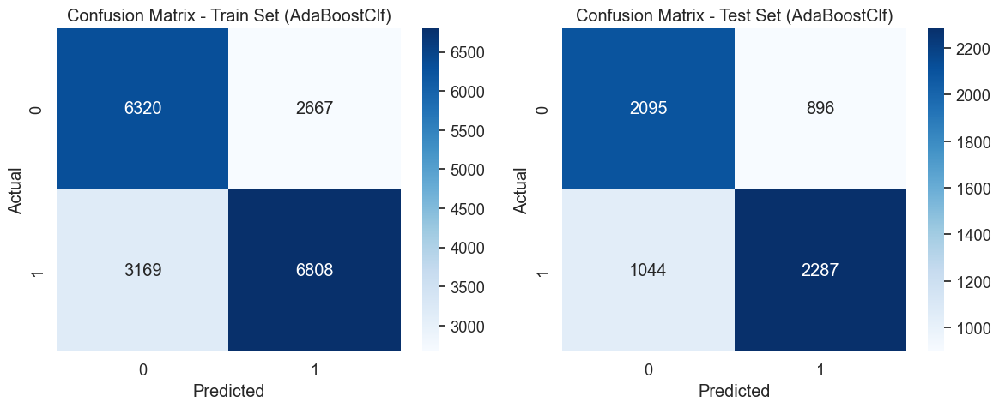

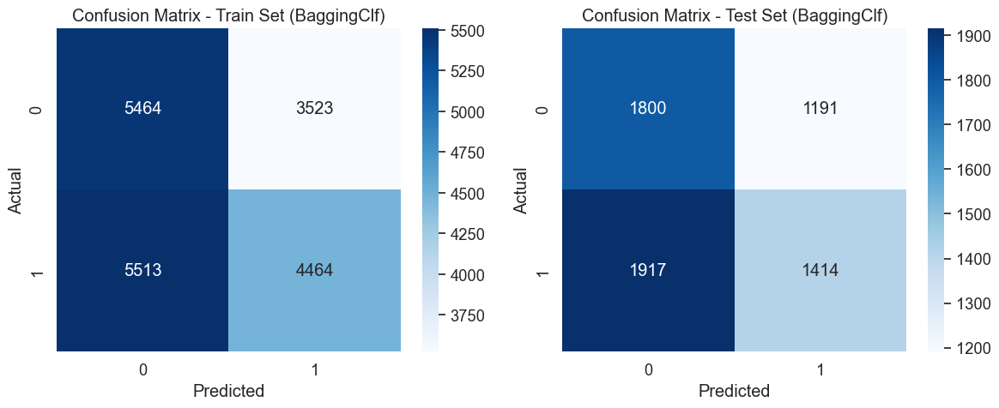

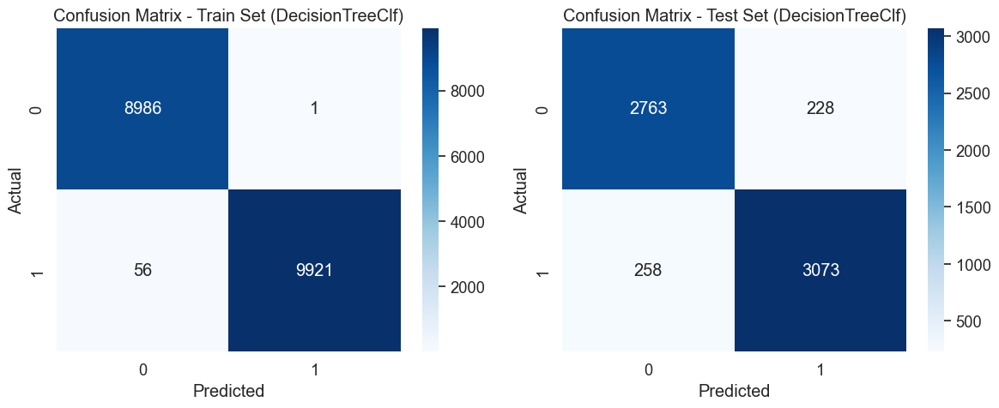

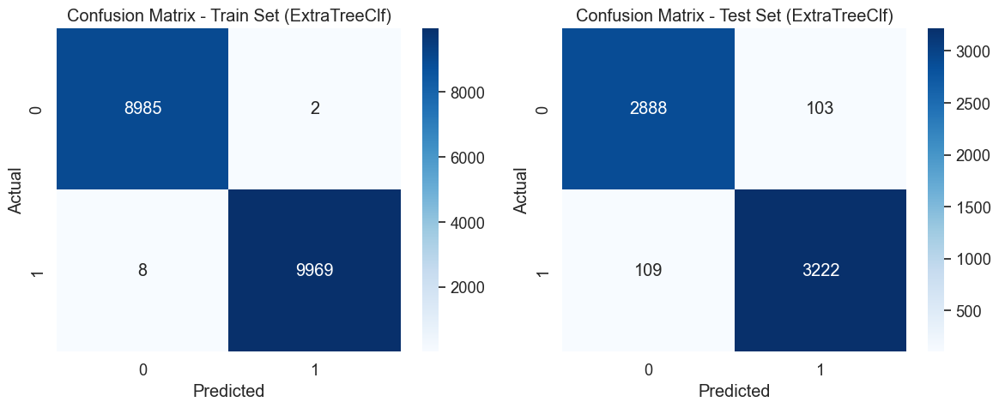

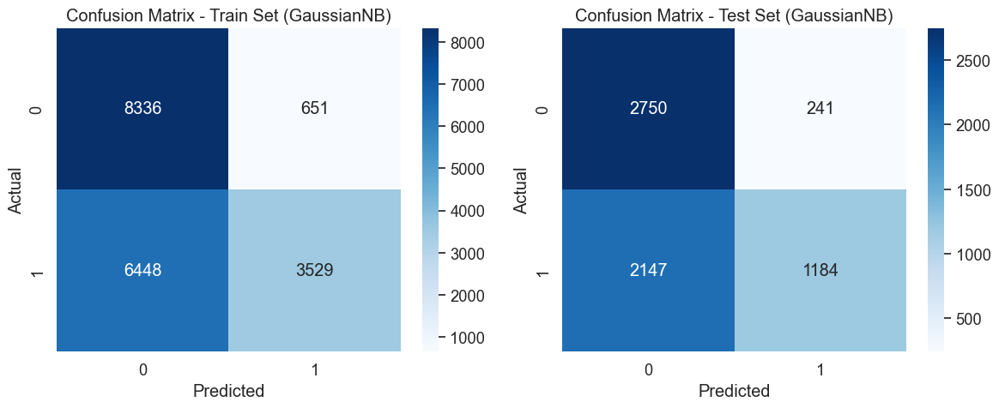

...

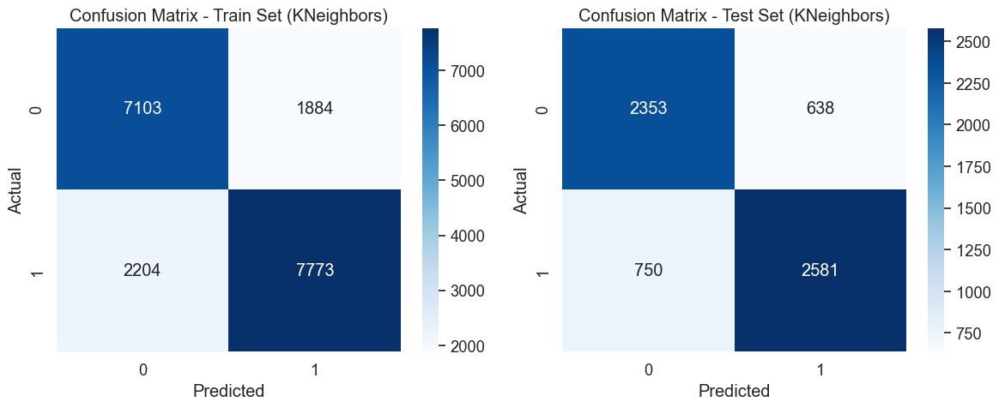

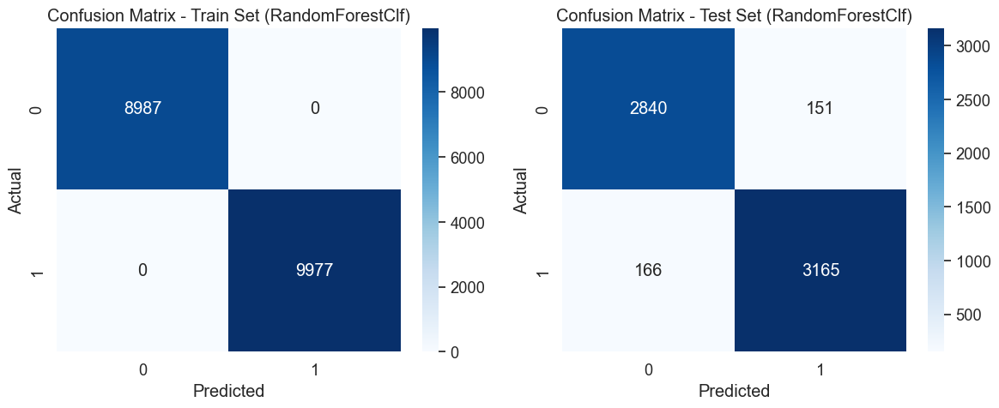

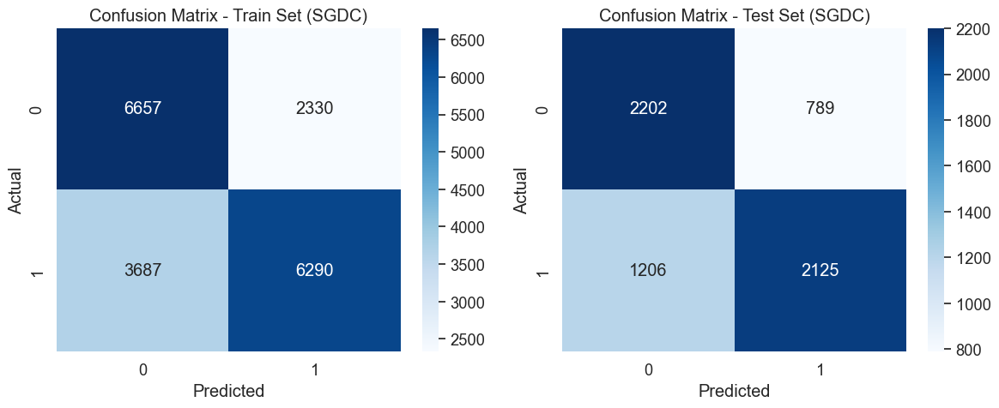

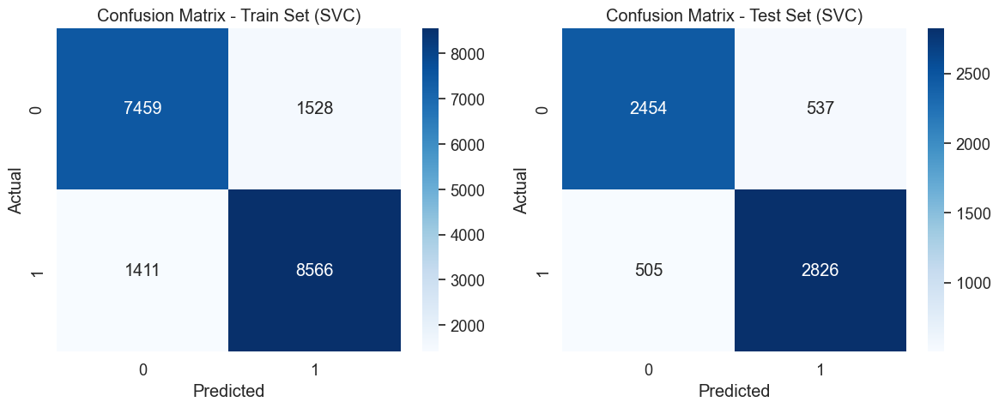

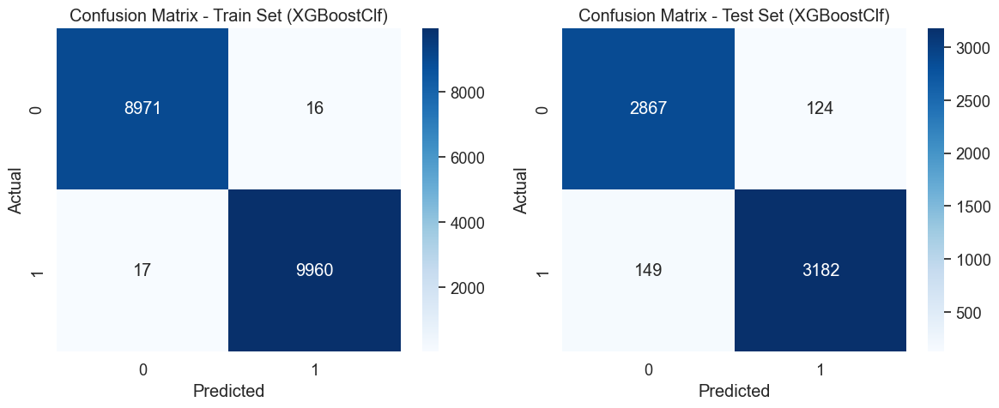

In [198]:
def plot_cm(model, X_train, X_test, y_train, y_test, model_name):
    # Creating subgraphs for confusion matrix for train and test set
    fig, axes = plt.subplots(1, 2, figsize=(12, 5))

    # Confusion Matrix for train set
    train_cm = confusion_matrix(y_train, model.predict(X_train))
    sns.heatmap(train_cm, annot=True, cmap='Blues', fmt='d', ax=axes[0])
    axes[0].set_title('Confusion Matrix - Train Set ({})'.format(model_name))
    axes[0].set_xlabel('Predicted')
    axes[0].set_ylabel('Actual')

    # Confusion Matrix for test set
    test_cm = confusion_matrix(y_test, model.predict(X_test))
    sns.heatmap(test_cm, annot=True, cmap='Blues', fmt='d', ax=axes[1])
    axes[1].set_title('Confusion Matrix - Test Set ({})'.format(model_name))
    axes[1].set_xlabel('Predicted')
    axes[1].set_ylabel('Actual')

    plt.tight_layout()
    plt.show()

# Build confusion matrix for each models
for model, model_name in zip(models, model_names):
    plot_cm(model, X_train, X_test, y_train, y_test, model_name)

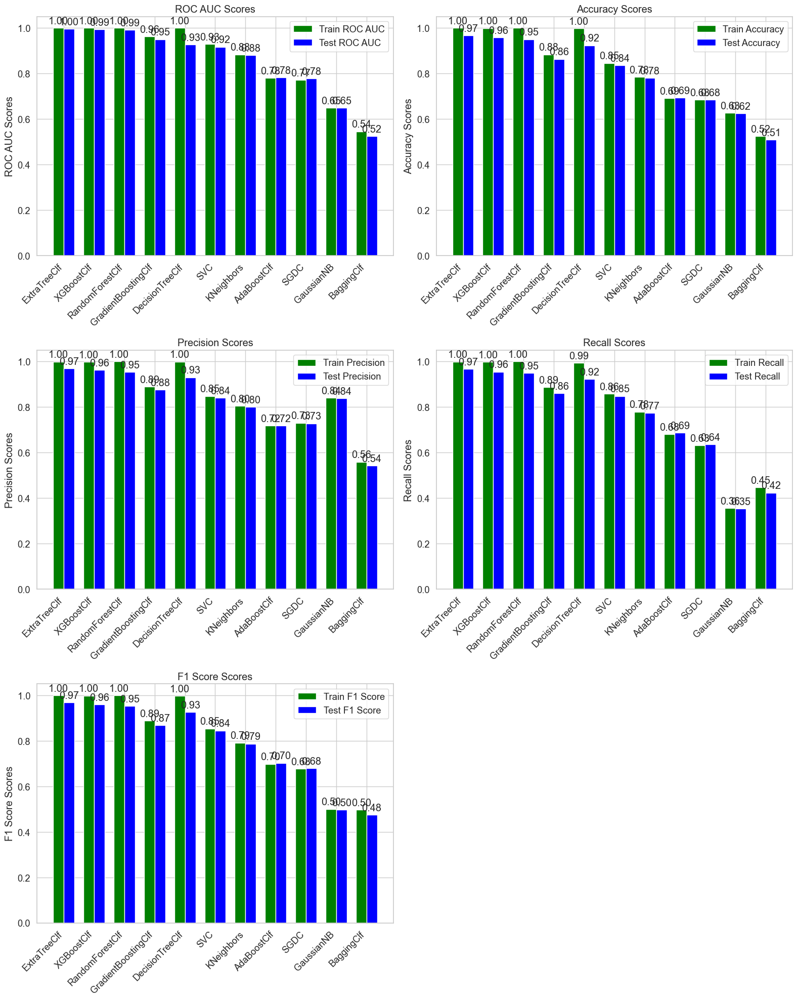

In [201]:
def plot_all_metrics(models, X_train, y_train, X_test, y_test, model_names):
    metrics = {
        'ROC AUC': ([], []),
        'Accuracy': ([], []),
        'Precision': ([], []),
        'Recall': ([], []),
        'F1 Score': ([], [])
    }
    
    for model in models:
        y_train_pred = model.predict(X_train)
        y_test_pred = model.predict(X_test)
        
        y_train_proba = model.predict_proba(X_train)[:, 1]
        y_test_proba = model.predict_proba(X_test)[:, 1]
        
        metrics['ROC AUC'][0].append(roc_auc_score(y_train, y_train_proba))
        metrics['ROC AUC'][1].append(roc_auc_score(y_test, y_test_proba))
        
        metrics['Accuracy'][0].append(accuracy_score(y_train, y_train_pred))
        metrics['Accuracy'][1].append(accuracy_score(y_test, y_test_pred))

        metrics['Precision'][0].append(precision_score(y_train, y_train_pred))
        metrics['Precision'][1].append(precision_score(y_test, y_test_pred))

        metrics['Recall'][0].append(recall_score(y_train, y_train_pred))
        metrics['Recall'][1].append(recall_score(y_test, y_test_pred))

        metrics['F1 Score'][0].append(f1_score(y_train, y_train_pred))
        metrics['F1 Score'][1].append(f1_score(y_test, y_test_pred))
    
    # Sorting models by test ROC AUC
    sorted_indices = np.argsort(metrics['ROC AUC'][1])[::-1]
    
    model_names_sorted = [model_names[i] for i in sorted_indices]
    
    for metric in metrics:
        metrics[metric] = ([metrics[metric][0][i] for i in sorted_indices],
                           [metrics[metric][1][i] for i in sorted_indices])
    
    x = np.arange(len(model_names_sorted)) 
    width = 0.35  
    
    fig, axes = plt.subplots(3, 2, figsize=(16, 20))
    axes = axes.flatten()

    for idx, (metric, (train_scores, test_scores)) in enumerate(metrics.items()):
        ax = axes[idx]
        rects1 = ax.bar(x - width/2, train_scores, width, label=f'Train {metric}', color='green')
        rects2 = ax.bar(x + width/2, test_scores, width, label=f'Test {metric}', color='blue')
        
        ax.set_ylabel(f'{metric} Scores')
        ax.set_title(f'{metric} Scores')
        ax.set_xticks(x)
        ax.set_xticklabels(model_names_sorted, rotation=45, ha='right')
        ax.legend()
        
        autolabel(rects1, ax)
        autolabel(rects2, ax)
    
    # Remove any empty subplots (if there are)
    if len(metrics) % 2 != 0:
        fig.delaxes(axes[-1])

    fig.tight_layout()
    plt.show()

def autolabel(rects, ax):
    for rect in rects:
        height = rect.get_height()
        ax.annotate(f'{height:.2f}',
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3), 
                    textcoords="offset points",
                    ha='center', va='bottom')

plot_all_metrics(models, X_train, y_train, X_test, y_test, model_names)

# ANN Model

In [132]:
# Function for demonstrate model performance
def plot_performance(history):
    plt.figure(figsize=(12, 6))

    # Loss
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Loss')
    plt.legend()

    # Accuracy
    plt.subplot(1, 2, 2)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Accuracy')
    plt.legend()

    plt.show()

In [140]:
# Preprocessing for ANN model
pipeline = Pipeline(steps = [
    ('imputer', RandomSampleImputer()),
    ('encoder', OneHotEncoder()),
    ('constant', DropConstantFeatures(tol = 0.97)),
    ('duplicated', DropDuplicateFeatures()),
    ('correlated', SmartCorrelatedSelection(selection_method = 'variance')),
    ('scaler', StandardScaler()),
    ('winsorizer', Winsorizer(capping_method = 'gaussian', tail = 'both', fold = 1.5))
])

X_train_preprocessed = pipeline.fit_transform(X_train)
X_test_preprocessed = pipeline.transform(X_test)

In [141]:
# Early stopping
early_stopping = EarlyStopping(
    monitor = 'val_accuracy',
    min_delta = 0.001,
    patience = 50,
    restore_best_weights = True,
    verbose = 1,
    mode = 'auto'
)
callbacks = early_stopping

In [142]:
# Build model
input_shape = (X_train_preprocessed.shape[1],)

def create_model(optimizer = 'adam'):
    classifier = Sequential()

    classifier.add(Input(shape = input_shape))
    
    classifier.add(Dense(units = 300, kernel_initializer = 'he_uniform', activation = 'relu', kernel_regularizer = l2(0.001)))
    classifier.add(BatchNormalization())
    classifier.add(Dropout(0.2))

    classifier.add(Dense(units = 300, kernel_initializer = 'he_uniform', activation = 'relu', kernel_regularizer = l2(0.001)))
    classifier.add(BatchNormalization())
    classifier.add(Dropout(0.2))

    classifier.add(Dense(units = 250, kernel_initializer = 'he_uniform', activation = 'relu', kernel_regularizer = l2(0.001)))
    classifier.add(BatchNormalization())
    classifier.add(Dropout(0.3))

    classifier.add(Dense(units = 200, kernel_initializer = 'he_uniform', activation = 'relu', kernel_regularizer = l2(0.001)))
    classifier.add(BatchNormalization())
    classifier.add(Dropout(0.2))

    classifier.add(Dense(units = 1, activation = 'sigmoid', kernel_initializer = 'glorot_uniform'))
    classifier.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
    return classifier

hist_model = create_model()
history1 = hist_model.fit(
    X_train_preprocessed,
    y_train,
    epochs = 300,
    batch_size = 128,
    validation_split = 0.2,
    callbacks = callbacks
)
hist_model.summary()

Epoch 1/300
119/119 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - accuracy: 0.6165 - loss: 2.7561 - val_accuracy: 0.7448 - val_loss: 2.3104
Epoch 2/300
119/119 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7265 - loss: 2.2734 - val_accuracy: 0.7830 - val_loss: 1.9949
Epoch 3/300
119/119 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7595 - loss: 1.9580 - val_accuracy: 0.7886 - val_loss: 1.7300
Epoch 4/300
119/119 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7787 - loss: 1.6867 - val_accuracy: 0.8075 - val_loss: 1.4828
Epoch 5/300
119/119 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8008 - loss: 1.4448 - val_accuracy: 0.8313 - val_loss: 1.2732
Epoch 6/300
119/119 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8193 - loss: 1.2369 - val_accuracy: 0.8358 - val_loss: 1.1070
Epoch 7/300
119/119 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8343 - loss: 1.0683 - val_accuracy: 0.8555 - val_loss: 0.9539
Epoch 8/300
119/119 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8458 - loss: 0.9309 - val_accu

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_5 (Dense)                 │ (None, 300)            │        11,100 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 300)            │         1,200 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 300)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 300)            │        90,300 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 300)            │         1,200 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_5 (Dropout)             │ (None, 300)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 250)            │        75,250 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 250)            │         1,000 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_6 (Dropout)             │ (None, 250)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 200)            │        50,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 200)            │           800 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_7 (Dropout)             │ (None, 200)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 1)              │           201 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 689,555 (2.63 MB)

 Trainable params: 229,151 (895.12 KB)

 Non-trainable params: 2,100 (8.20 KB)

 Optimizer params: 458,304 (1.75 MB)

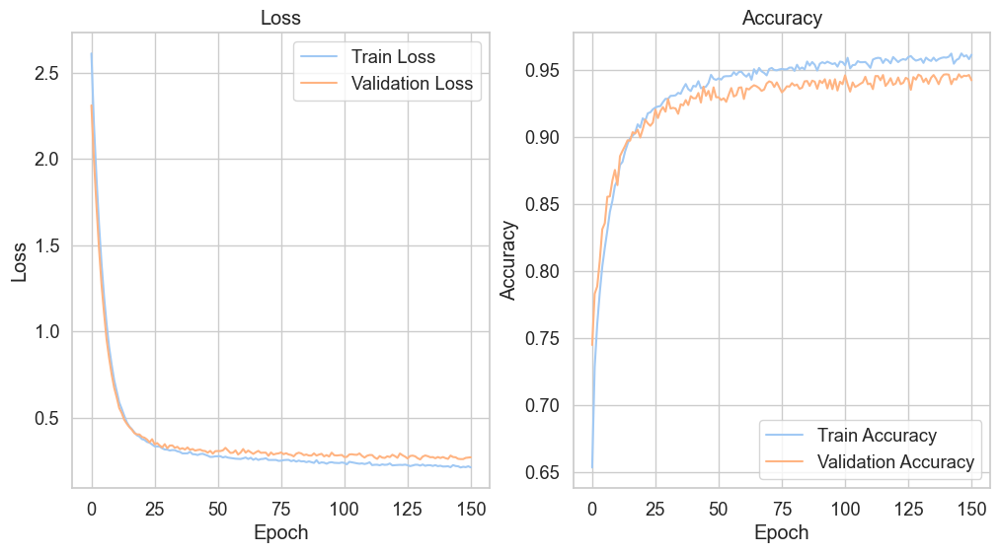

In [144]:
plot_performance(history1)

# GridSearchCV

In [145]:
pipeline = Pipeline(steps=[
    ('preprocessing', pipeline),
    ('model', KerasClassifier(model=create_model, 
                              epochs = 100,
                              batch_size = 128,
                              optimizer = 'adam',
                              metrics=['val_accuracy'],
                              validation_split = 0.2,
                              callbacks = callbacks
                             ))
])

# GridSearch parametrs
parameters = {
    'model__batch_size': [64, 128, 256],
    'model__epochs': [100, 200],
    'model__optimizer': ['adam', 'SGD']
}

grid = GridSearchCV(
    estimator = pipeline,
    param_grid = parameters,
    n_jobs = -1,
    cv = 3,
    error_score = 'raise'
)

grid_results = grid.fit(X_train, y_train, model__validation_split = 0.2, model__callbacks = callbacks)

best_model = grid_results.best_estimator_
print("Best Parameters:", grid_results.best_params_)

Epoch 1/100
Epoch 1/100
Epoch 1/100
Epoch 1/100
Epoch 1/100
Epoch 1/200
Epoch 1/100
Epoch 1/200
159/159 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - accuracy: 0.6264 - loss: 2.7271 - val_accuracy: 0.7505 - val_loss: 2.3096
Epoch 2/100
159/159 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - accuracy: 0.5995 - loss: 2.7473 - val_accuracy: 0.7517 - val_loss: 2.3005
Epoch 2/200
159/159 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - accuracy: 0.6077 - loss: 2.7595 - val_accuracy: 0.7339 - val_loss: 2.3065
Epoch 2/100
159/159 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - accuracy: 0.6203 - loss: 2.7417 - val_accuracy: 0.7461 - val_loss: 2.3039
Epoch 2/100
159/159 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - accuracy: 0.6212 - loss: 2.7601 - val_accuracy: 0.7390 - val_loss: 2.3262
Epoch 2/100
159/159 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - accuracy: 0.6143 - loss: 2.7832 - val_accuracy: 0.7406 - val_loss: 2.3520
Epoch 2/100
159/159 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.6053 - loss: 2.7689 - val_accuracy: 0.7465 - val_loss: 2.3110
Epoch 2

In [180]:
best_params = grid_results.best_params_
print('Best Parameters:', best_params)

Best Parameters: {'model__batch_size': 64, 'model__epochs': 100, 'model__optimizer': 'SGD'}


In [185]:
best_model_ANN = best_model_ANN.fit(X_train_preprocessed, y_train,
                        validation_split = 0.2,
                        batch_size = best_params['model__batch_size'],
                        epochs = best_params['model__epochs'],
                        callbacks = [EarlyStopping(monitor = 'val_loss', patience = 10, verbose = 1)])

Epoch 1/100
238/238 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8990 - loss: 0.6287 - val_accuracy: 0.9138 - val_loss: 0.5908
Epoch 2/100
238/238 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.9024 - loss: 0.6106 - val_accuracy: 0.9046 - val_loss: 0.6040
Epoch 3/100
238/238 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.9042 - loss: 0.6087 - val_accuracy: 0.9183 - val_loss: 0.5757
Epoch 4/100
238/238 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.9116 - loss: 0.5932 - val_accuracy: 0.9188 - val_loss: 0.5701
Epoch 5/100
238/238 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.9070 - loss: 0.5992 - val_accuracy: 0.8922 - val_loss: 0.6384
Epoch 6/100
238/238 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8969 - loss: 0.6198 - val_accuracy: 0.9022 - val_loss: 0.5999
Epoch 7/100
238/238 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8966 - loss: 0.6233 - val_accuracy: 0.9112 - val_loss: 0.5748
Epoch 8/100
238/238 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8990 - loss: 0.6055 - val_accu

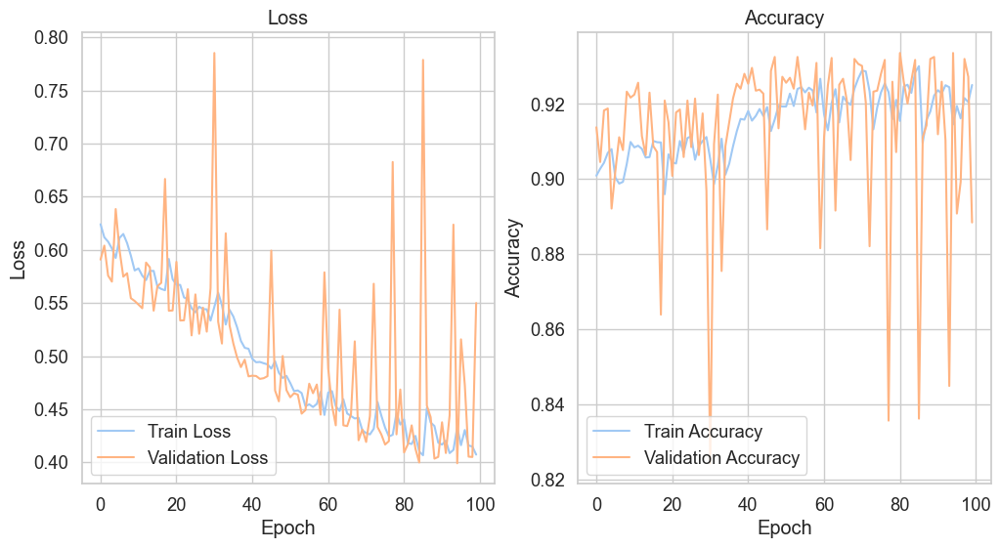

In [186]:
plot_performance(best_model_ANN)

593/593 ━━━━━━━━━━━━━━━━━━━━ 0s 604us/step
198/198 ━━━━━━━━━━━━━━━━━━━━ 0s 588us/step


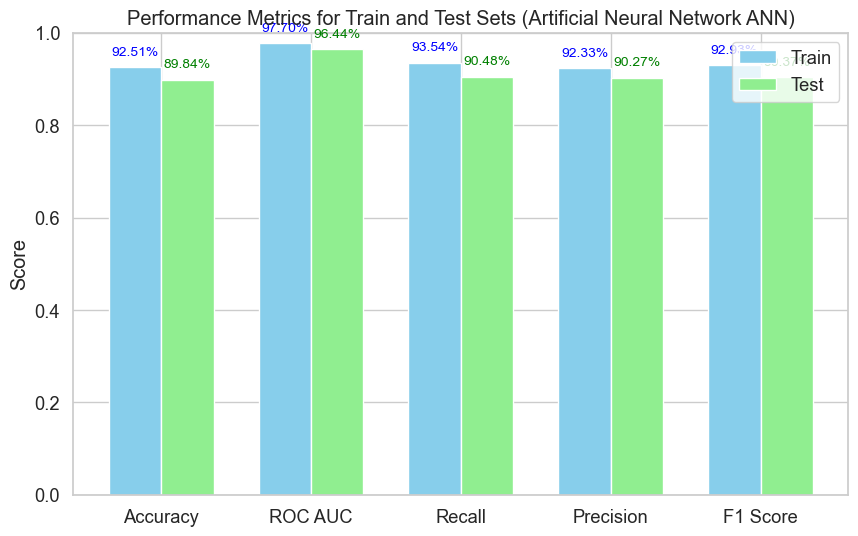

In [215]:
y_train_pred_proba = best_model.predict(X_train_preprocessed)
y_train_pred = (y_train_pred_proba > 0.5).astype(int)

y_test_pred_proba = best_model.predict(X_test_preprocessed)
y_test_pred = (y_test_pred_proba > 0.5).astype(int)

train_accuracy = accuracy_score(y_train, y_train_pred)
train_roc_auc = roc_auc_score(y_train, y_train_pred_proba)
train_recall = recall_score(y_train, y_train_pred)
train_precision = precision_score(y_train, y_train_pred)
train_f1 = f1_score(y_train, y_train_pred)

test_accuracy = accuracy_score(y_test, y_test_pred)
test_roc_auc = roc_auc_score(y_test, y_test_pred_proba)
test_recall = recall_score(y_test, y_test_pred)
test_precision = precision_score(y_test, y_test_pred)
test_f1 = f1_score(y_test, y_test_pred)

train_metrics = [train_accuracy, train_roc_auc, train_recall, train_precision, train_f1]
test_metrics = [test_accuracy, test_roc_auc, test_recall, test_precision, test_f1]
metric_names = ['Accuracy', 'ROC AUC', 'Recall', 'Precision', 'F1 Score']

x = np.arange(len(metric_names))
width = 0.35  # Ширина столбцов

fig, ax = plt.subplots(figsize=(10, 6))
bars1 = ax.bar(x - width/2, train_metrics, width, label='Train', color='skyblue')
bars2 = ax.bar(x + width/2, test_metrics, width, label='Test', color='lightgreen')

for bar in bars1:
    yval = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2, yval + 0.02, f'{yval:.2%}', ha='center', va='bottom', color='blue', fontsize=10)
for bar in bars2:
    yval = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2, yval + 0.02, f'{yval:.2%}', ha='center', va='bottom', color='green', fontsize=10)

ax.set_ylabel('Score')
ax.set_title('Performance Metrics for Train and Test Sets (Artificial Neural Network ANN)')
ax.set_xticks(x)
ax.set_xticklabels(metric_names)
ax.set_ylim(0, 1)
ax.legend()

plt.show()


##### Build the graph that will show us the performance of models based on the ROC AUC and ACCURACY metrics

## 9. Conclusion

During the project on predicting CNC machine tool part failures, we trained several classification models, including Extra Tree, XGBoost, Random Forest, GradientBoostingClf, and Decision Tree. All of them demonstrated good performance, allowing us to effectively predict potential part failures and take timely measures to prevent them.

We also trained an Artificial Neural Network (ANN) model, which demonstrated the following metric values:

- *Accuracy*: 92.51% (Train), 89.84% (Test)
- *ROC AUC*: 97.70% (Train), 96.44% (Test)
- *Recall*: 93.54% (Train), 90.48% (Test)
- *Precision*: 92.33% (Train), 90.27% (Test)
- *F1 Score*: 92.87% (Train), 90.36% (Test)


To improve the results, we plan to conduct further research. We will consider alternative data processing methods, including outlier handling, and experiment with algorithm parameters. Additionally, we will explore the possibility of using ensemble methods to increase the stability and accuracy of predictions.

Overall, our project demonstrates the potential of applying machine learning in manufacturing processes, allowing for increased efficiency and reduced operational risks.


Заключение:

В ходе проекта по прогнозированию поломок деталей на станке с ЧПУ мы обучили несколько моделей классификации, включая Extra Tree, XGBoost, Random Forest, GradientBoostingClf и Decision Tree. Все они показали хорошую производительность, что позволяет нам эффективно предсказывать возможные поломки деталей и своевременно принимать меры по их предотвращению.

Мы также обучили модель искусственной нейронной сети (ANN), которая продемонстрировала следующие значения метрик:

- *Accuracy*: 92.51% (Train), 89.84% (Test)
- *ROC AUC*: 97.70% (Train), 96.44% (Test)
- *Recall*: 93.54% (Train), 90.48% (Test)
- *Precision*: 92.33% (Train), 90.27% (Test)
- *F1 Score*: 92.87% (Train), 90.36% (Test)


Для улучшения результатов мы планируем провести дополнительные исследования. Мы рассмотрим альтернативные методы обработки данных, включая обработку выбросов, а также эксперименты с параметрами алгоритмов. Дополнительно, рассмотрим возможность использования ансамблевых методов для увеличения стабильности и точности прогнозов.
